<a href="https://colab.research.google.com/github/RoujinAn1/CSCB_final_project_late-stage-analysis/blob/main/late_stage%20analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# CSCB FINAL_PROJECT

In [ ]:
# installing packages, loading libraries
!pip install scanpy==1.9.8 scipy umap-learn leidenalg
!pip install -U scFates
!pip install pyslingshot
!pip install git+https://github.com/pcahan1/pySingleCellNet.git
# Install oneSC directly via pip
!pip install git+https://github.com/pcahan1/oneSC.git@cscb24
import scanpy as sc
import numpy as np
import pandas as pd
import scFates as scf
import os, sys
os.environ['R_HOME'] = sys.exec_prefix+"/lib/R/"
print(os.environ['R_HOME'])
# mounting google drive
from google.colab import drive
drive.mount('/content/drive')
import onesc
import networkx as nx
import seaborn as sns
import os
import anndata
import scipy as sp
import pySingleCellNet as pySCN
from joblib import dump, load
import sys
import igraph as ig
from igraph import Graph
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')
plt.rcParams['figure.dpi'] = 300
sc.logging.print_header()

  Cloning https://github.com/pcahan1/pySingleCellNet.git to /tmp/pip-req-build-4eyi2ylz
  Running command git clone --filter=blob:none --quiet https://github.com/pcahan1/pySingleCellNet.git /tmp/pip-req-build-4eyi2ylz
  Resolved https://github.com/pcahan1/pySingleCellNet.git to commit 82bc24659cc1efd84860e8fa8de8c66f2f897230
  Preparing metadata (setup.py) ... done
  Cloning https://github.com/pcahan1/oneSC.git (to revision cscb24) to /tmp/pip-req-build-j9_l0i21
  Running command git clone --filter=blob:none --quiet https://github.com/pcahan1/oneSC.git /tmp/pip-req-build-j9_l0i21
  Running command git checkout -b cscb24 --track origin/cscb24
  Switched to a new branch 'cscb24'
  Branch 'cscb24' set up to track remote branch 'cscb24' from 'origin'.
  Resolved https://github.com/pcahan1/oneSC.git to commit 9b0bcef27daeab72e297ece546f57c63ed10820b
  Preparing metadata (setup.py) ... done
/usr/lib/R/
Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount(

In [ ]:
# Read in data
adEarly = sc.read_h5ad('/content/drive/MyDrive/CSCB/CSCB_FInal_Project/adEarly_CSCB24.h5ad')
adLate_Mesoderm = sc.read_h5ad('/content/drive/MyDrive/CSCB/CSCB_FInal_Project/adLate_Mesoderm.h5ad')

### Due to the consideration of the batch effect between two experiments, here we don't concatenate the two data, but do trajectory inference and GRN separately for two stages: Early and Late. The analysis below focus on late stage data analysis and construct GRN about late stage, and figure out key TFs to manipulate with.

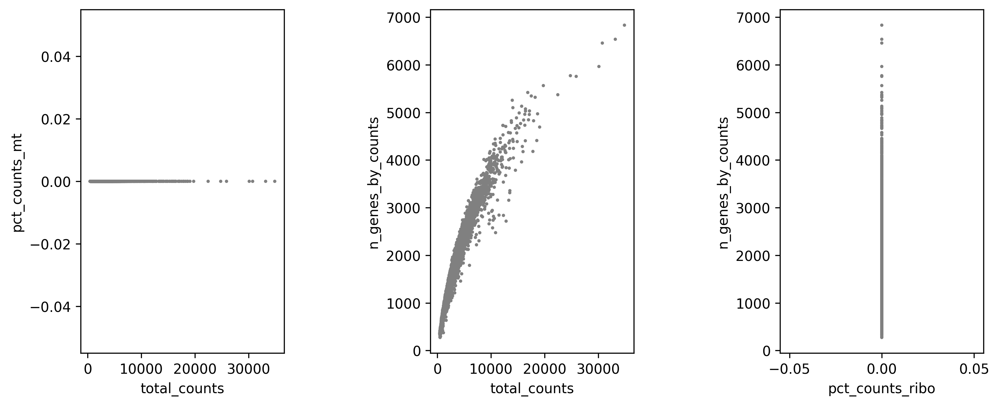

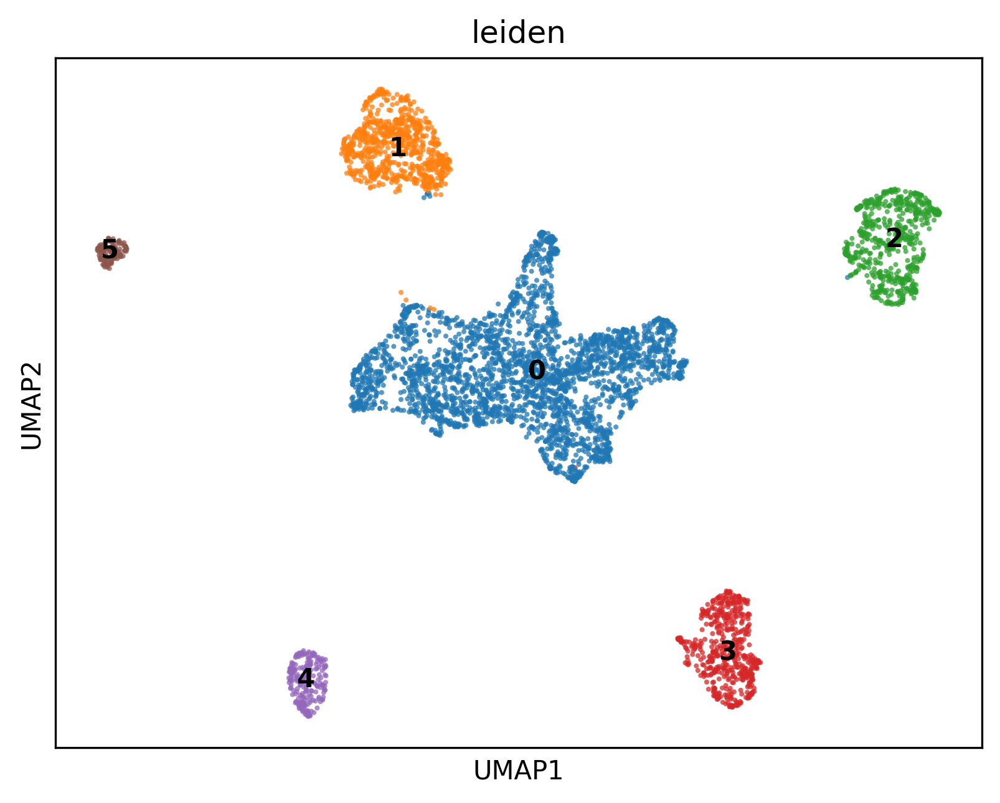

In [ ]:
# Inspect the Late stage data
#QC
adLate_Mesoderm.var['mt'] = adLate_Mesoderm.var_names.str.startswith('MT-')
ribo_prefix = ("RPS","RPL")
adLate_Mesoderm.var['ribo'] = adLate_Mesoderm.var_names.str.startswith(ribo_prefix)
sc.pp.calculate_qc_metrics(adLate_Mesoderm, qc_vars=['mt','ribo'], percent_top=None, log1p=False, inplace=True)
#visualization
adClean_Mesoderm= adLate_Mesoderm.copy()
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(10,4), gridspec_kw={'wspace':0.25}, constrained_layout=True)
ax1_dict = sc.pl.scatter(adClean_Mesoderm, x='total_counts', y='pct_counts_mt', ax=ax1, show=False)
ax2_dict = sc.pl.scatter(adClean_Mesoderm, x='total_counts', y='n_genes_by_counts',ax=ax2, show=False)
ax3_dict = sc.pl.scatter(adClean_Mesoderm, x='pct_counts_ribo', y='n_genes_by_counts',ax=ax3, show=False)
plt.show()
#filtering out mt gene
adClean_Mesoderm= adClean_Mesoderm[adClean_Mesoderm.obs['pct_counts_mt']<20,:].copy()
adClean_Mesoderm.n_obs
#filtering based on gene counts/gene numbers
sc.pp.filter_cells(adClean_Mesoderm, min_genes=500)
sc.pp.filter_cells(adClean_Mesoderm, max_counts=30000)
sc.pp.filter_genes(adClean_Mesoderm, min_cells=3)
adClean_Mesoderm.shape
# PAGA,Norm, HVG, PCA, kNN
adNorm_Mesoderm= adClean_Mesoderm.copy()
sc.pp.normalize_total(adNorm_Mesoderm, target_sum=1e4)
sc.pp.log1p(adNorm_Mesoderm)
sc.pp.highly_variable_genes(adNorm_Mesoderm, min_mean=0.0125, max_mean=6, min_disp=0.25)
sc.tl.pca(adNorm_Mesoderm, use_highly_variable=True)
n_neighbors = 20
n_pcs = 10
sc.pp.neighbors(adNorm_Mesoderm, n_neighbors=n_neighbors, n_pcs=n_pcs)
sc.tl.leiden(adNorm_Mesoderm,.1)
sc.tl.paga(adNorm_Mesoderm)
sc.pl.paga(adNorm_Mesoderm, plot=False)
sc.tl.umap(adNorm_Mesoderm, 0.25, init_pos='paga')
sc.pl.umap(adNorm_Mesoderm,color=['leiden'], alpha=.75, s=15, legend_loc='on data')


In [ ]:
print(adNorm_Mesoderm.obs.head())   # View first few rows of the observation metadata

                                cell_id keep   day  embryo_id  \
594   run_4_P2-01B.AATTCTAGGTTATGAGTTAA  yes  E8.5   embryo_9   
1652  run_4_P2-01F.AGCATAACTTATTCGACCAA  yes  E8.5   embryo_9   
2874   run_4_P2-02B.AGAGGTCGTTGACGCTCCG  yes  E8.5   embryo_1   
4081  run_4_P2-02F.ATCTTCAGATTTGCGAGGCA  yes  E8.5   embryo_8   
4706  run_4_P2-02H.ACATGGTAATTATAGACGCA  yes  E8.5  embryo_10   

     experimental_batch major_trajectory  \
594               run_4      Endothelium   
1652              run_4         Mesoderm   
2874              run_4      Endothelium   
4081              run_4         Mesoderm   
4706              run_4         Mesoderm   

                              celltype_update file_origin  n_genes_by_counts  \
594             Hematoendothelial progenitors       part1               3582   
1652  Lateral plate and intermediate mesoderm       part1               4219   
2874            Hematoendothelial progenitors       part1               3060   
4081                    

Since the Data is already annotated, we will directly use the annotation in later analysis.

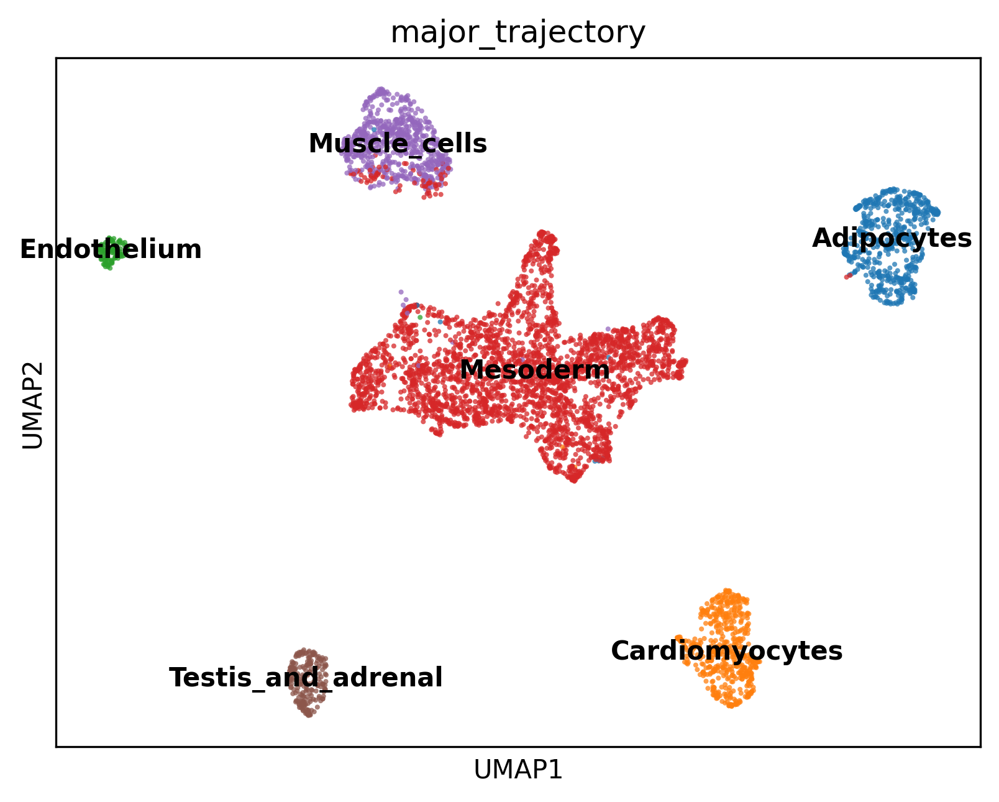

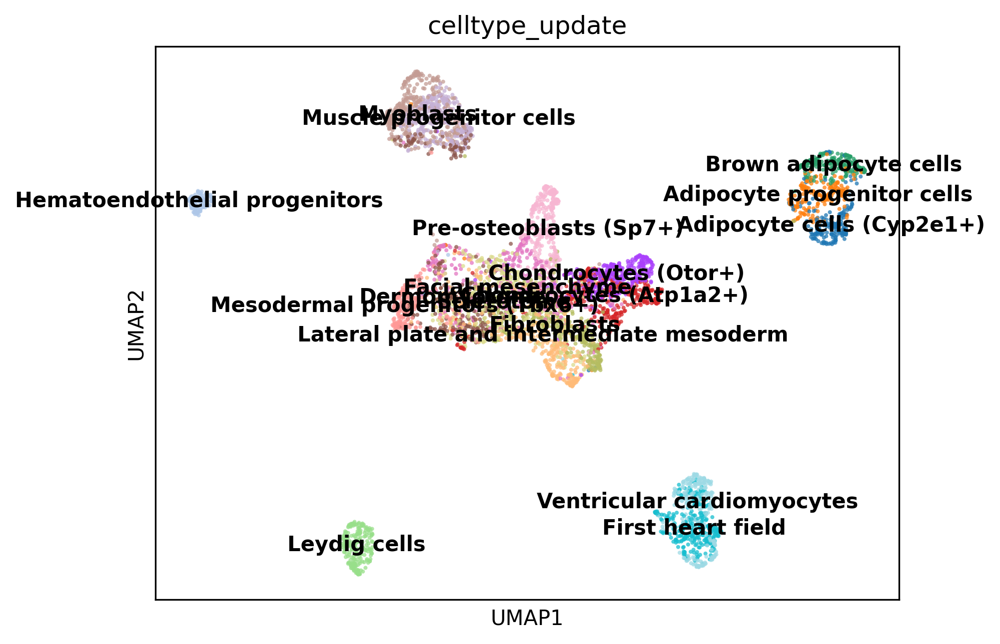

In [ ]:
sc.pl.umap(adNorm_Mesoderm,color=['major_trajectory'], alpha=.75, s=15, legend_loc='on data')
sc.pl.umap(adNorm_Mesoderm,color=['celltype_update'], alpha=.75, s=15, legend_loc='on data')


## Let's take a closer look at the late-stage development

First, redo the KNN,PCA, and UMAP



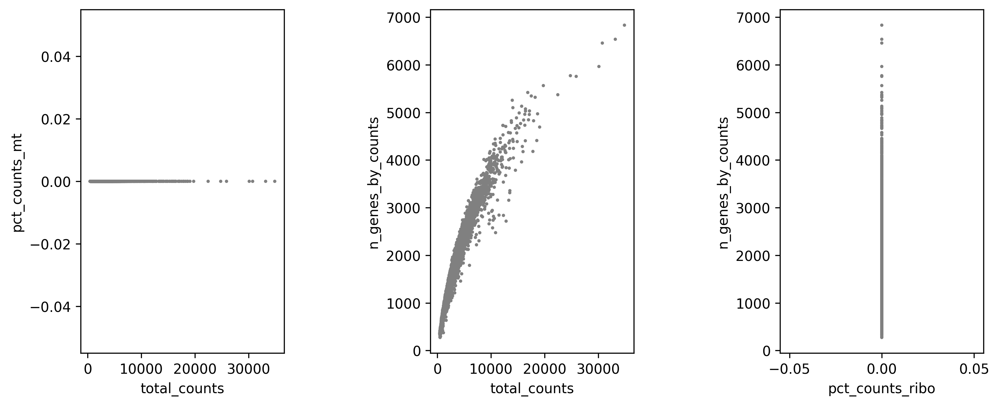

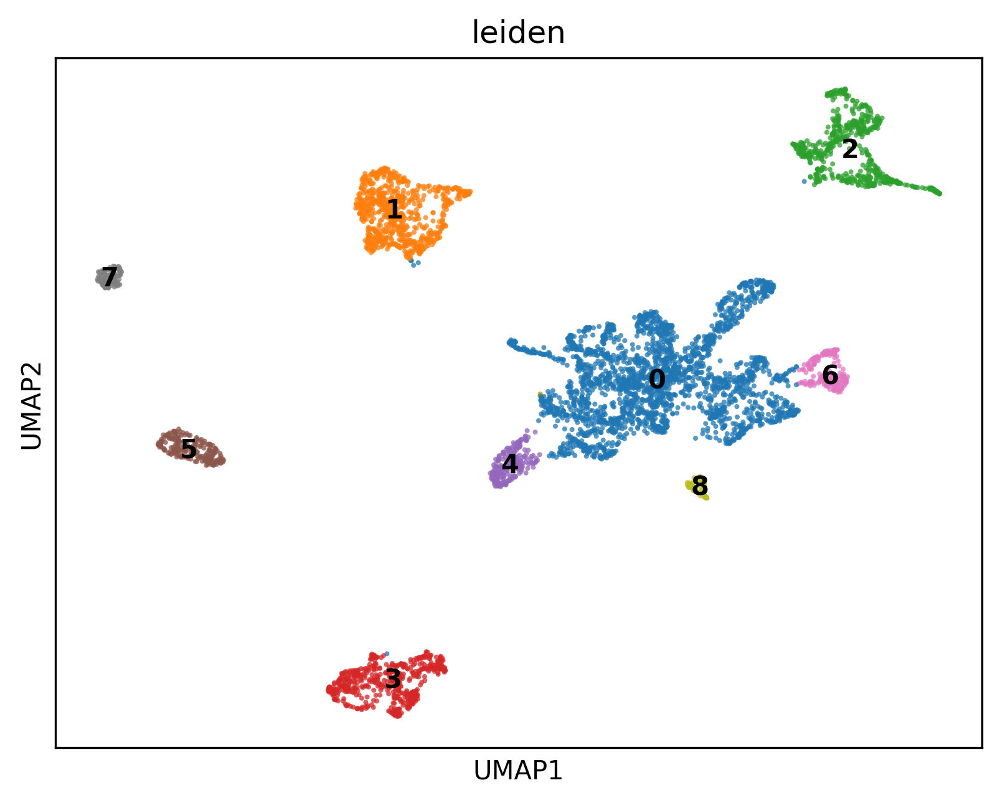

In [ ]:
adLate_Mesoderm = sc.read_h5ad('/content/drive/MyDrive/CSCB/CSCB_FInal_Project/adLate_Mesoderm.h5ad')
# Inspect the Late stage data
#QC
adLate_Mesoderm.var['mt'] = adLate_Mesoderm.var_names.str.startswith('MT-')
ribo_prefix = ("RPS","RPL")
adLate_Mesoderm.var['ribo'] = adLate_Mesoderm.var_names.str.startswith(ribo_prefix)
sc.pp.calculate_qc_metrics(adLate_Mesoderm, qc_vars=['mt','ribo'], percent_top=None, log1p=False, inplace=True)
#visualization
adClean_Mesoderm= adLate_Mesoderm.copy()
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(10,4), gridspec_kw={'wspace':0.25}, constrained_layout=True)
ax1_dict = sc.pl.scatter(adClean_Mesoderm, x='total_counts', y='pct_counts_mt', ax=ax1, show=False)
ax2_dict = sc.pl.scatter(adClean_Mesoderm, x='total_counts', y='n_genes_by_counts',ax=ax2, show=False)
ax3_dict = sc.pl.scatter(adClean_Mesoderm, x='pct_counts_ribo', y='n_genes_by_counts',ax=ax3, show=False)
plt.show()
#filtering out mt gene
adClean_Mesoderm= adClean_Mesoderm[adClean_Mesoderm.obs['pct_counts_mt']<20,:].copy()
adClean_Mesoderm.n_obs
#filtering based on gene counts/gene numbers
sc.pp.filter_cells(adClean_Mesoderm, min_genes=500)
sc.pp.filter_cells(adClean_Mesoderm, max_counts=30000)
sc.pp.filter_genes(adClean_Mesoderm, min_cells=3)
adClean_Mesoderm.shape
# PAGA,Norm, HVG, PCA, kNN
adNorm_Mesoderm= adClean_Mesoderm.copy()
sc.pp.normalize_total(adNorm_Mesoderm, target_sum=1e4)
sc.pp.log1p(adNorm_Mesoderm)
sc.pp.highly_variable_genes(adNorm_Mesoderm, min_mean=0.0125, max_mean=6, min_disp=0.25)
sc.tl.pca(adNorm_Mesoderm, use_highly_variable=True)
n_neighbors = 15
n_pcs = 30
sc.pp.neighbors(adNorm_Mesoderm, n_neighbors=n_neighbors, n_pcs=n_pcs)
sc.tl.leiden(adNorm_Mesoderm,.1)
sc.tl.paga(adNorm_Mesoderm)
sc.pl.paga(adNorm_Mesoderm, plot=False)
sc.tl.umap(adNorm_Mesoderm, 0.25, init_pos='paga')
sc.pl.umap(adNorm_Mesoderm,color=['leiden'], alpha=.75, s=15, legend_loc='on data')

### Compare clustering with annotation provided

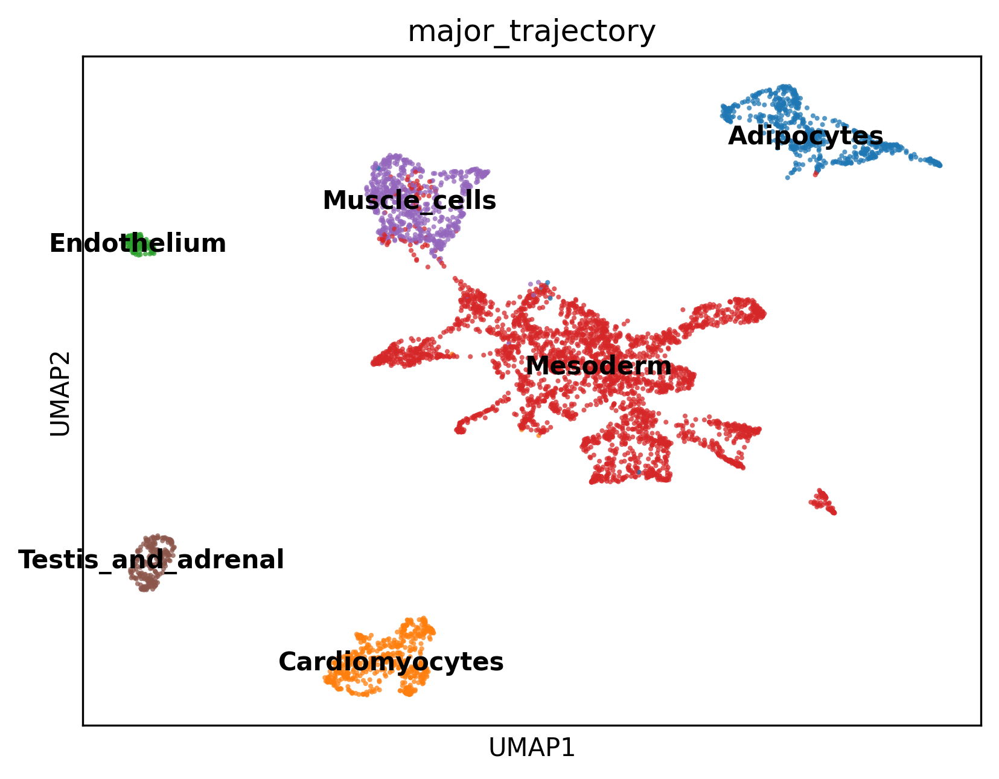

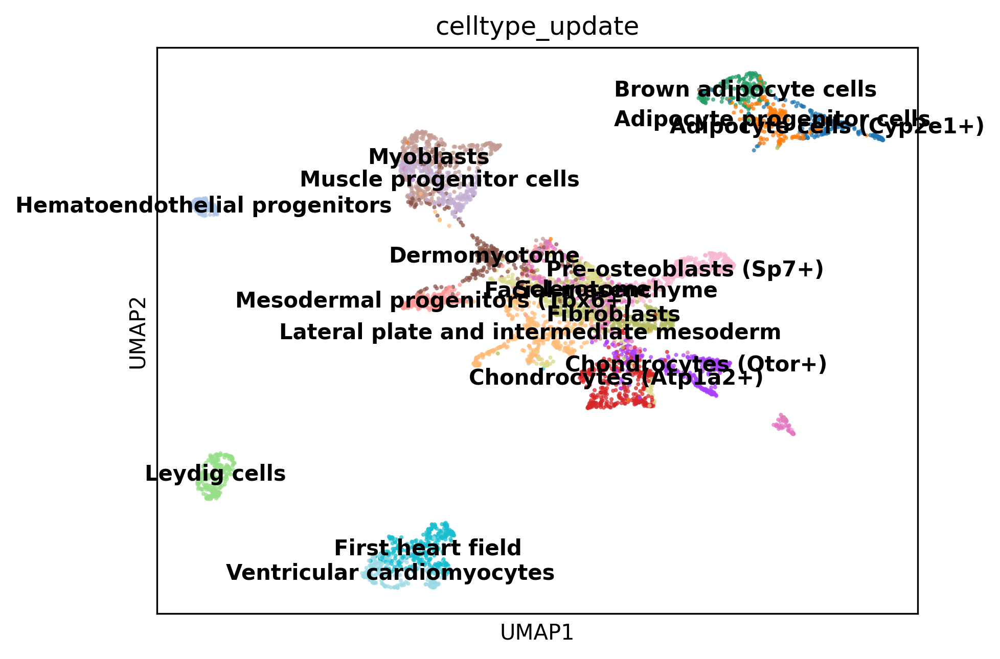

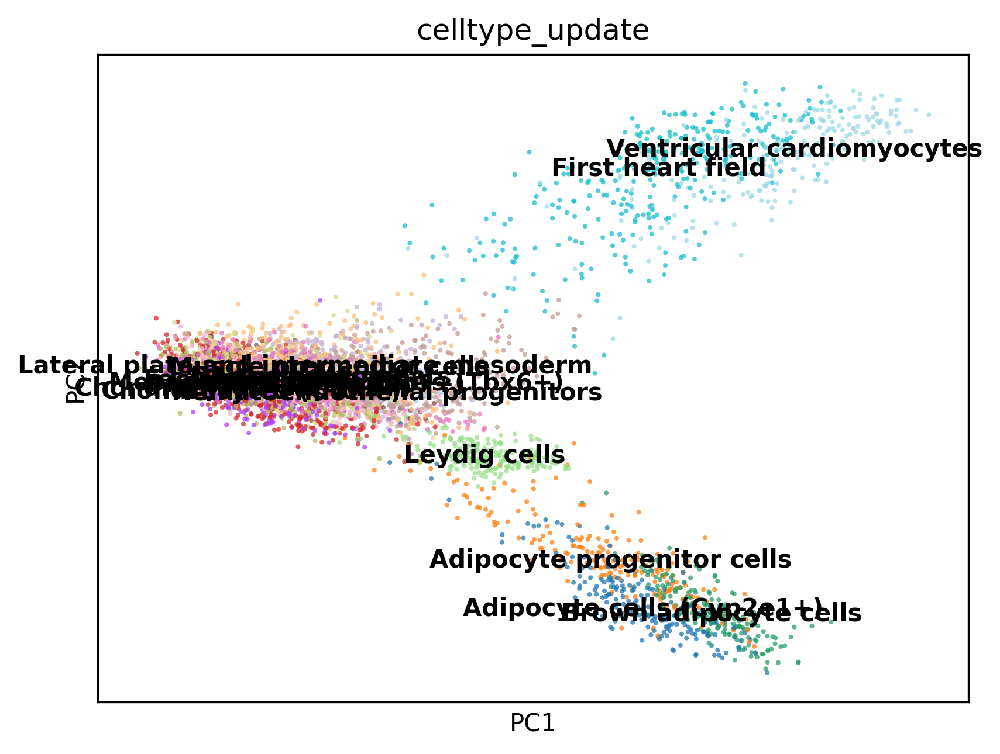

In [ ]:
sc.pl.umap(adNorm_Mesoderm,color=['major_trajectory'], alpha=.75, s=15, legend_loc='on data')
sc.pl.umap(adNorm_Mesoderm,color=['celltype_update'], alpha=.75, s=15, legend_loc='on data')
sc.pl.pca(adNorm_Mesoderm,color=['celltype_update'], alpha=.75, s=15, legend_loc='on data')


### According known papers, from the late stage, the root can be defined as sclerotome. But here we ran a pseudotime inference tool such as cytoTRACE to map the developmental stages and the stemness, root of clusters.

In [ ]:
!pip install cellrank
!pip install scvelo
import cellrank as cr
import scvelo as scv
np.random.seed(42)
#cytoTRACE preprocessing:copying X matrix into the layers
adcyto_Mesoderm= adNorm_Mesoderm.copy()
adcyto_Mesoderm.layers["spliced"] = adcyto_Mesoderm.X
adcyto_Mesoderm.layers["unspliced"] = adcyto_Mesoderm.X
scv.pp.moments(adcyto_Mesoderm, n_pcs=3, n_neighbors=20)

computing neighbors
    finished (0:00:01) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:10) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


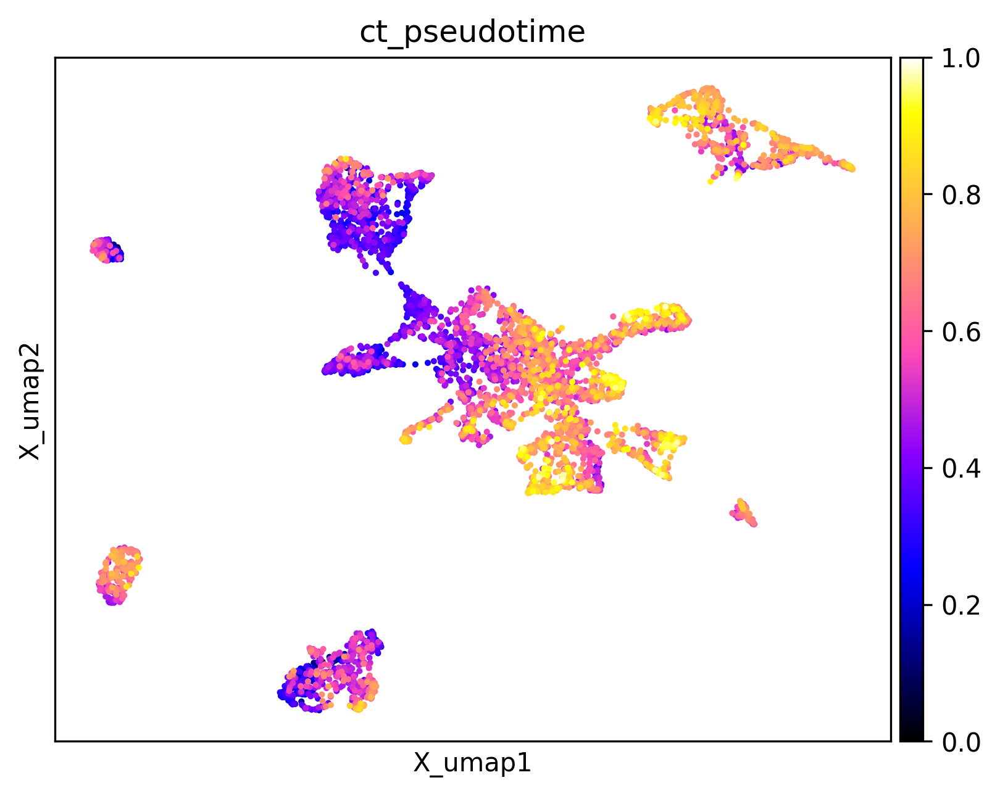

In [ ]:

# compute the CytoTRACE score
from cellrank.kernels import CytoTRACEKernel
ctk_Mesoderm = CytoTRACEKernel(adcyto_Mesoderm).compute_cytotrace()
sc.pl.embedding(
    adcyto_Mesoderm,
    color=['ct_pseudotime'],
    basis='X_umap',
    color_map="gnuplot2",
)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
/usr/local/lib/python3.10/dist-packages/pandas/core/algorithms.py:522: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps_array.dtype], [])
/usr/local/lib/python3.10/dist-packages/pandas/core/algorithms.py:522: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated

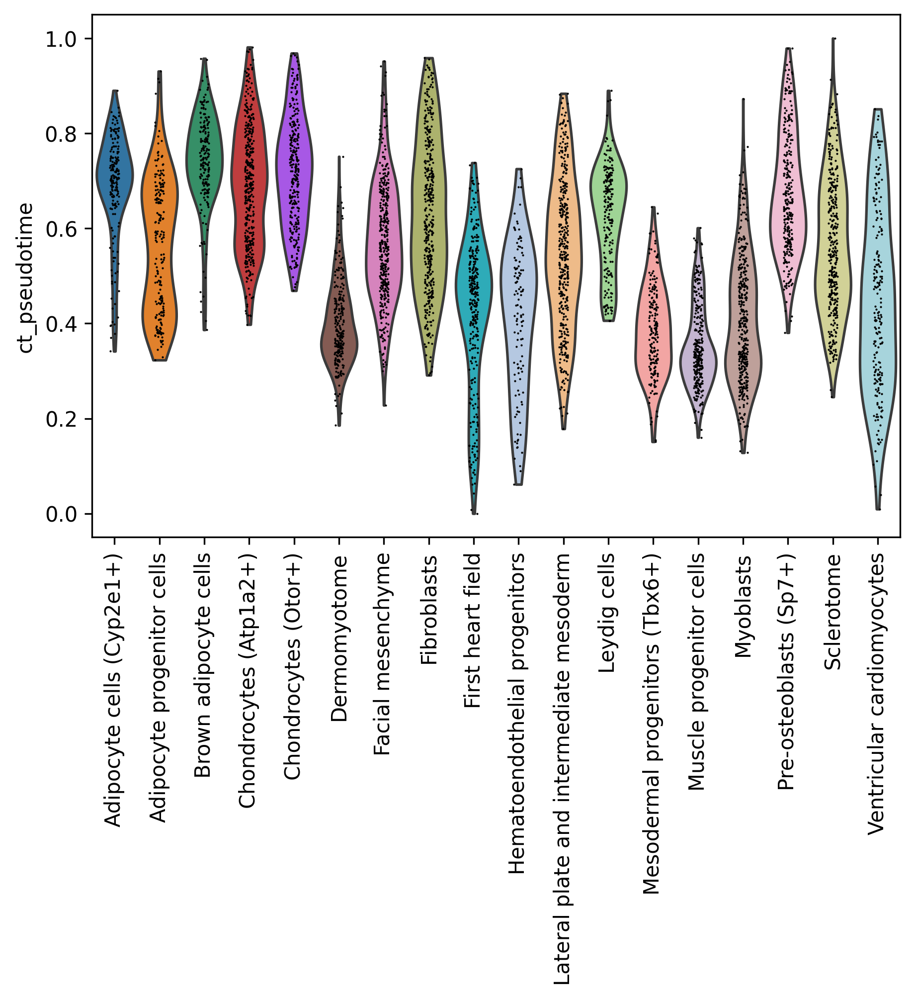

In [ ]:
# visualize cytoTRACE score quantitatively
sc.pl.violin(adcyto_Mesoderm, keys=['ct_pseudotime'], groupby='celltype_update', rotation=90)

In [ ]:
# Compute and Visualize a transition matrix
ctk_Mesoderm.compute_transition_matrix(threshold_scheme="soft", nu=0.5)


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


  0%|          | 0/5073 [00:00<?, ?cell/s]

CytoTRACEKernel[n=5073, dnorm=False, scheme='soft', b=10.0, nu=0.5]

  0%|          | 0/100 [00:00<?, ?sim/s]

/usr/local/lib/python3.10/dist-packages/pandas/core/algorithms.py:522: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps_array.dtype], [])


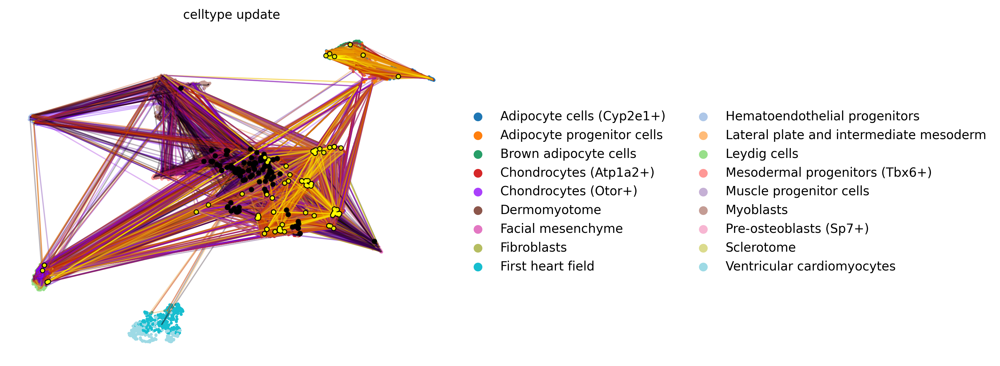

In [ ]:
# random-walk validation
ctk_Mesoderm.plot_random_walks(
    n_sims=100,
    start_ixs={"celltype_update": "Sclerotome"},
    basis="X_umap",
    color="celltype_update",
    legend_loc="right",
    seed=1,
)

## Trajectory Inference


From the above analysis, apparently there are too many different clusters in the late stage data, the pca, umap and pseudotime trajectory inference become minimally informative here. Thus, here subset the data to include only cell types that's relevant.

## Part 1 : generation of Sclerotome
### First, since paraxial mesoderm (Tbx6-) data is not included in the late-stage dataset, we can't do trajectory inference to figure out differentially expressed TFs along pseudotime trajectory to manipulate with for cell type differentiation. **So here we do DEG to figure out what TFs potentially drive or mark the Sclerotome cell fate instead of Dermomyotome or Facial mesenchyme.**

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
/usr/local/lib/python3.10/dist-packages/pandas/core/algorithms.py:522: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps_array.dtype], [])
/usr/local/lib/python3.10/dist-packages/pandas/core/dtypes/cast.py:1641: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecat

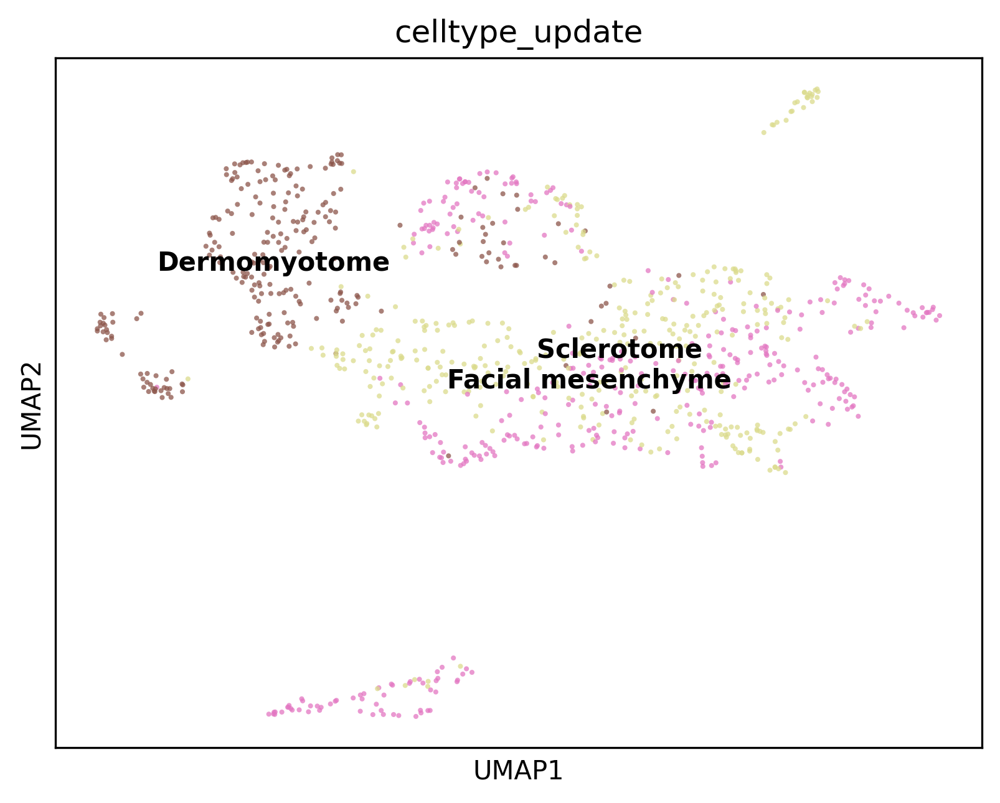

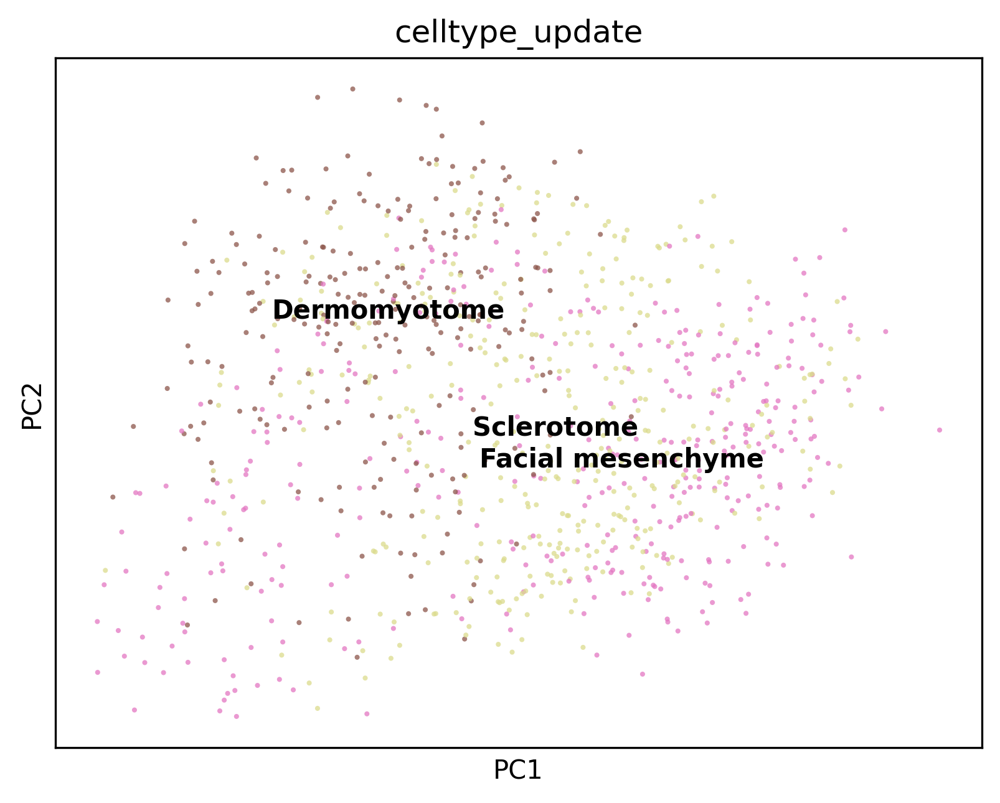

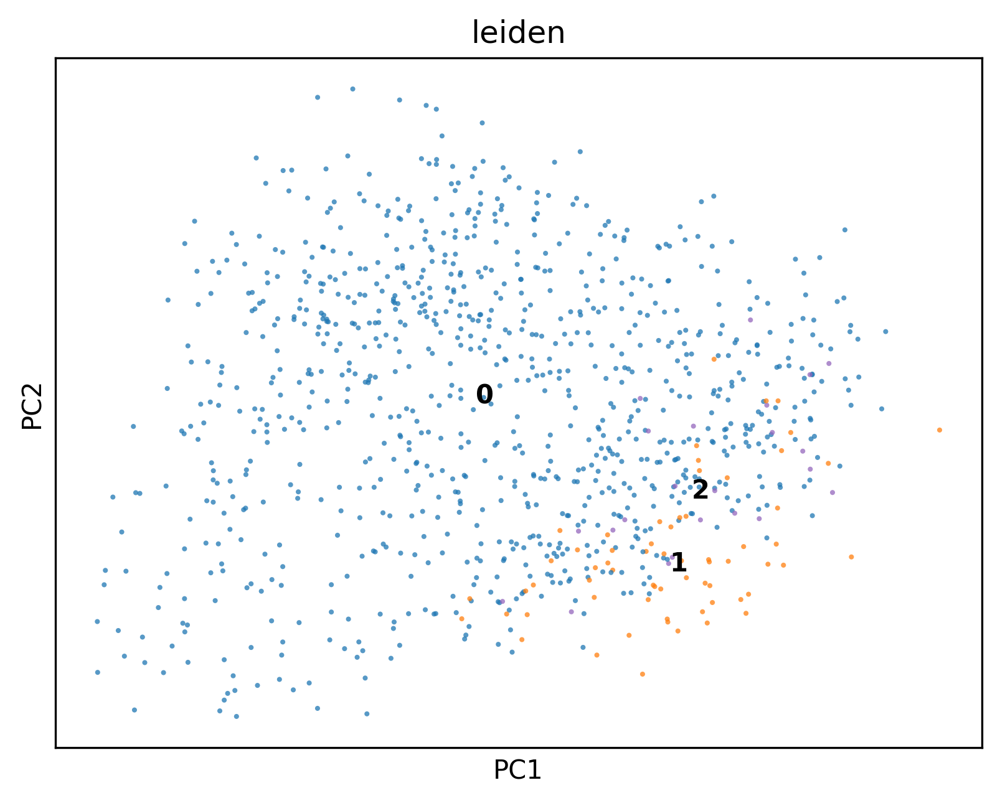

/usr/local/lib/python3.10/dist-packages/pandas/core/algorithms.py:522: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps_array.dtype], [])
/usr/local/lib/python3.10/dist-packages/pandas/core/dtypes/cast.py:1641: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  return np.find_common_type(types, [])


/usr/local/lib/python3.10/dist-packages/pandas/core/algorithms.py:522: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps_array.dtype], [])
/usr/local/lib/python3.10/dist-packages/pandas/core/algorithms.py:522: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps_array.dtype], [])


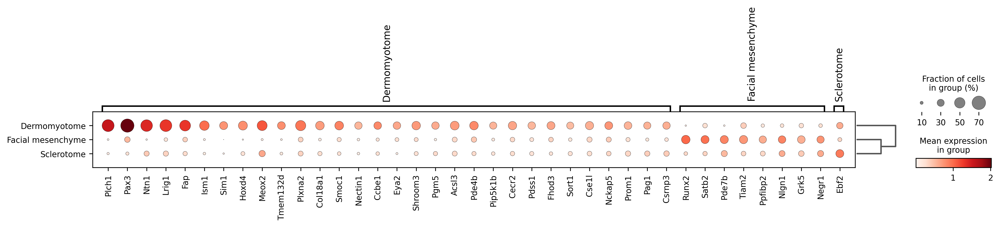

In [ ]:
# subsetting the late-stage data for 'Sclerotome','Dermomyotome','Facial mesenchyme'
selected_cell_types2 = ['Sclerotome','Dermomyotome','Facial mesenchyme']
adNorm_Mesoderm_subset2 = adNorm_Mesoderm[adNorm_Mesoderm.obs['celltype_update'].isin(selected_cell_types2),:].copy()
# redo HVG,PCA, umap
sc.pp.highly_variable_genes(adNorm_Mesoderm_subset2, min_mean=0.02, max_mean=10, min_disp=0.2)
sc.tl.pca(adNorm_Mesoderm_subset2, use_highly_variable=True,n_comps=30)
n_neighbors = 10
n_pcs = 20
sc.pp.neighbors(adNorm_Mesoderm_subset2, n_neighbors=n_neighbors, n_pcs=n_pcs)
sc.tl.leiden(adNorm_Mesoderm_subset2,.1)
sc.tl.paga(adNorm_Mesoderm_subset2)
sc.pl.paga(adNorm_Mesoderm_subset2, plot=False)
sc.tl.umap(adNorm_Mesoderm_subset2, 0.25, init_pos='paga')
sc.pl.umap(adNorm_Mesoderm_subset2,color=['celltype_update'], alpha=.75, s=15, legend_loc='on data')
sc.pl.pca(adNorm_Mesoderm_subset2,color=['celltype_update'], alpha=.75, s=15, legend_loc='on data')
sc.pl.pca(adNorm_Mesoderm_subset2,color=['leiden'], alpha=.75, s=15, legend_loc='on data')
# DEG
sc.tl.rank_genes_groups(adNorm_Mesoderm_subset2, use_raw=False, groupby="celltype_update")
sc.tl.filter_rank_genes_groups(adNorm_Mesoderm_subset2, min_fold_change=.3, min_in_group_fraction=.3, max_out_group_fraction=.2)
sc.pl.rank_genes_groups_dotplot(adNorm_Mesoderm_subset2, n_genes=30, groupby="celltype_update", dendrogram=True, key='rank_genes_groups_filtered')

In [ ]:
# Take out DEG list and extract TFs and important receptors genes
result2 = adNorm_Mesoderm_subset2.uns['rank_genes_groups_filtered']
groups2 = result2['names'].dtype.names
deg_data2 = {group: result2['names'][group] for group in groups2}
deg_df2 = pd.DataFrame(deg_data2)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
# Filter out genes specific to 'Sclerotome'
Sclerotome_genes = deg_df2['Sclerotome'].dropna().unique()
# Filter out genes specific to 'Dermomyotome'
Dermomyotome_genes = deg_df2['Dermomyotome'].dropna().unique()
# Filter out genes specific to 'Facial mesenchyme'
Facial_mesenchyme_genes = deg_df2['Facial mesenchyme'].dropna().unique()
# Identify TFs from the fibroblast1 related gene list
with open('/content/drive/MyDrive/allTFs_mm_aertslab_011924.txt', 'r') as file:
    mouse_tfs = [line.strip() for line in file]
#find out Transcription factors
Sclerotome_tfs = [gene for gene in Sclerotome_genes if gene in mouse_tfs]
Dermomyotome_tfs = [gene for gene in Dermomyotome_genes if gene in mouse_tfs]
Facial_mesenchyme_tfs = [gene for gene in Facial_mesenchyme_genes if gene in mouse_tfs]
print(Sclerotome_tfs)
print(Dermomyotome_tfs)
print(Facial_mesenchyme_tfs)

['Ebf2']
['Pax3', 'Sim1', 'Hoxd4', 'Meox2']
['Runx2', 'Satb2']


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


#### From DEG results, it seems that promoting **Ebf2** expression and inhibiting **'Pax3', 'Sim1', 'Hoxd4' and 'Runx2', 'Satb2'** potentially could promote Sclerotome fate and oppress Dermomyocyte and Facial Mesenchyme fate.

## **Part2: generation of Brown adipocytes**


### **Part 2.1 Tree construction**
#### scFates actually supports Tree analysis, so below we first directly try building up tree with all relevant cell types

/usr/local/lib/python3.10/dist-packages/pandas/core/algorithms.py:522: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps_array.dtype], [])
/usr/local/lib/python3.10/dist-packages/pandas/core/dtypes/cast.py:1641: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  return np.find_common_type(types, [])
/usr/local/lib/python3.10/dist-packages/pandas/core/algorithms.py:522: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  comm

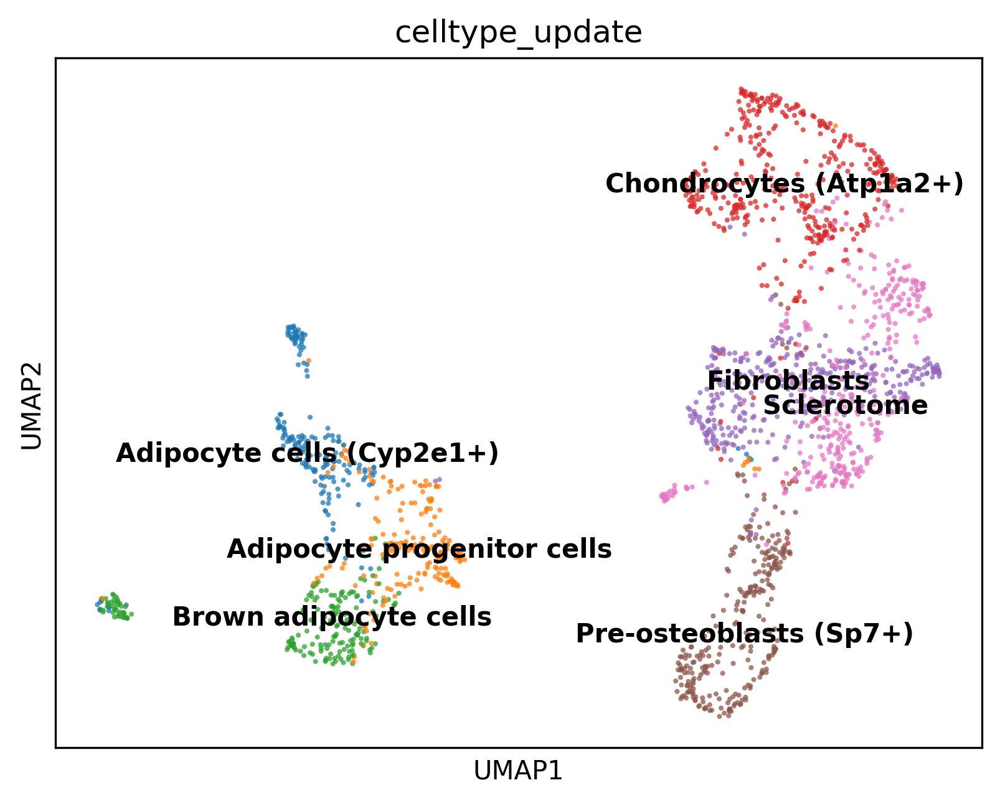

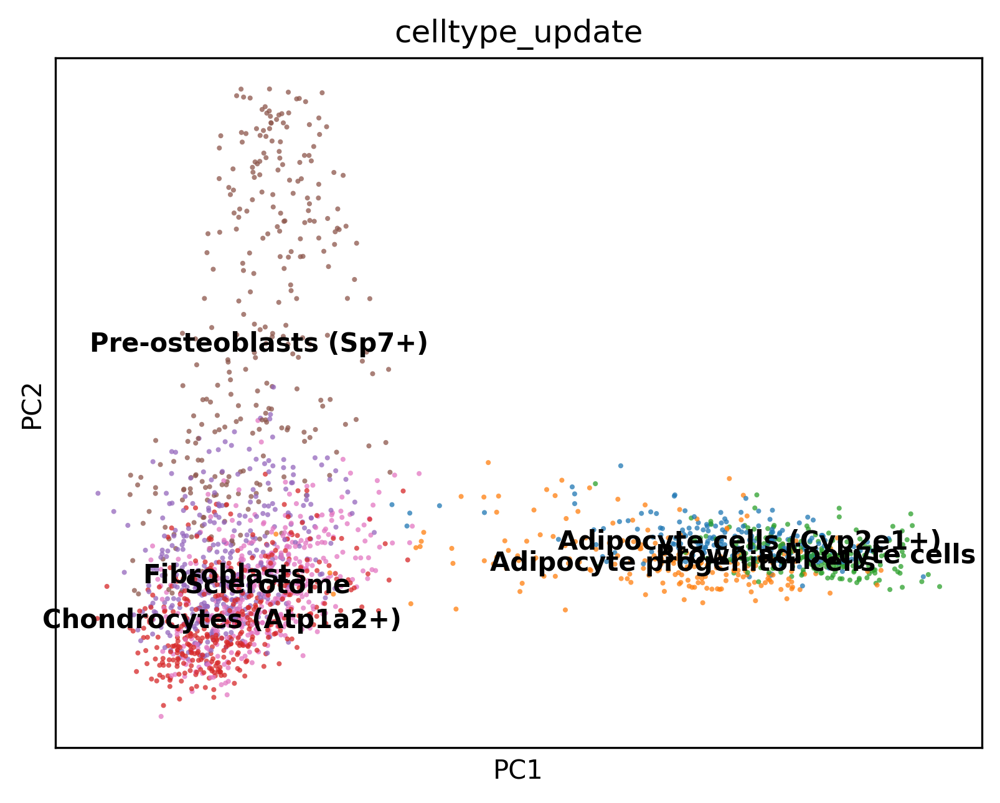

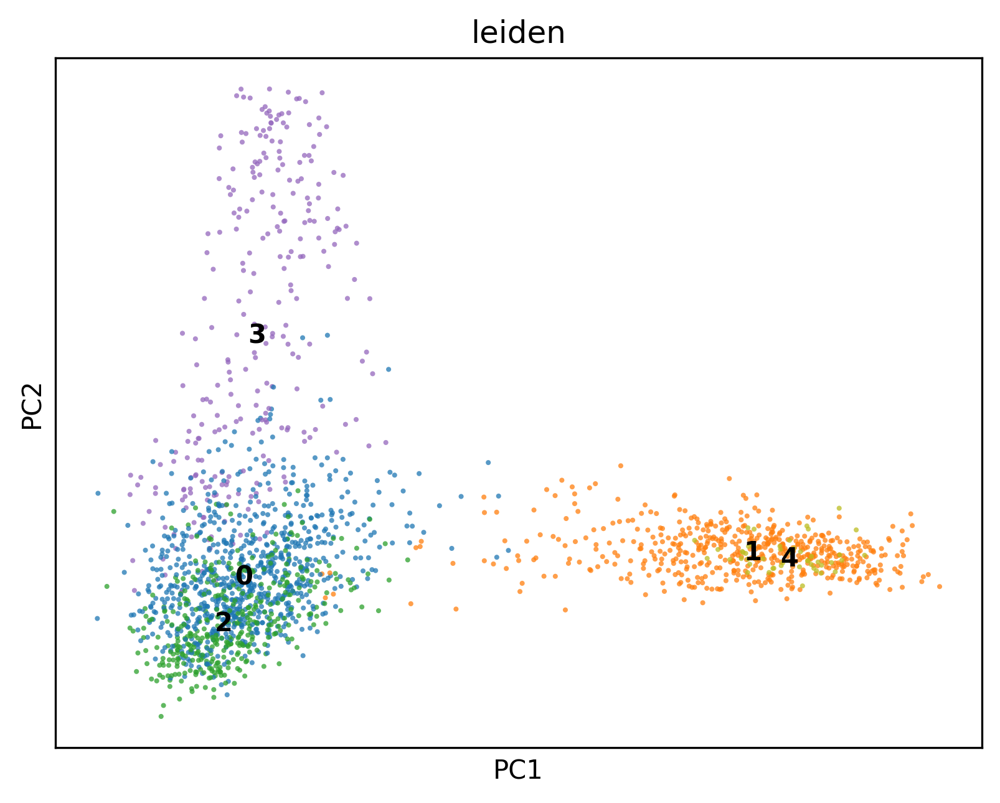

In [ ]:
# subsetting the late-stage data
selected_cell_types = ['Sclerotome','Chondrocytes (Atp1a2+)','Pre-osteoblasts (Sp7+)','Fibroblasts', 'Adipocyte progenitor cells','Adipocyte cells (Cyp2e1+)','Brown adipocyte cells']
adNorm_Mesoderm_subset = adNorm_Mesoderm[adNorm_Mesoderm.obs['celltype_update'].isin(selected_cell_types),:].copy()
# redo HVG,PCA, umap
sc.pp.highly_variable_genes(adNorm_Mesoderm_subset, min_mean=0.05, max_mean=6, min_disp=0.25)
sc.tl.pca(adNorm_Mesoderm_subset, use_highly_variable=True)
n_neighbors = 15
n_pcs = 30
sc.pp.neighbors(adNorm_Mesoderm_subset, n_neighbors=n_neighbors, n_pcs=n_pcs)
sc.tl.leiden(adNorm_Mesoderm_subset,.1)
sc.tl.paga(adNorm_Mesoderm_subset)
sc.pl.paga(adNorm_Mesoderm_subset, plot=False)
sc.tl.umap(adNorm_Mesoderm_subset, 0.25, init_pos='paga')
sc.pl.umap(adNorm_Mesoderm_subset,color=['celltype_update'], alpha=.75, s=15, legend_loc='on data')
sc.pl.pca(adNorm_Mesoderm_subset,color=['celltype_update'], alpha=.75, s=15, legend_loc='on data')
sc.pl.pca(adNorm_Mesoderm_subset,color=['leiden'], alpha=.75, s=15, legend_loc='on data')


In [ ]:
# trying multiple Nodes number
adNorm_Mesoderm_subset.obsm["X_umap"]=adNorm_Mesoderm_subset.obsm["X_umap"][:,:2].copy()
# Nodes = 10
scf.tl.tree(adNorm_Mesoderm_subset,method="ppt",Nodes=10,use_rep="X_umap")
scf.pl.graph(adNorm_Mesoderm_subset, basis='umap')
# Nodes = 20
scf.tl.tree(adNorm_Mesoderm_subset,method="ppt",Nodes=20,use_rep="X_umap")
scf.pl.graph(adNorm_Mesoderm_subset, basis='umap')
# Nodes = 40
scf.tl.tree(adNorm_Mesoderm_subset,method="ppt",Nodes=40,use_rep="X_umap")
scf.pl.graph(adNorm_Mesoderm_subset, basis='umap')
# Nodes = 45
scf.tl.tree(adNorm_Mesoderm_subset,method="ppt",Nodes=45,use_rep="X_umap")
scf.pl.graph(adNorm_Mesoderm_subset, basis='umap')
# Nodes = 50
scf.tl.tree(adNorm_Mesoderm_subset,method="ppt",Nodes=50,use_rep="X_umap")
scf.pl.graph(adNorm_Mesoderm_subset, basis='umap')
# Nodes = 60
scf.tl.tree(adNorm_Mesoderm_subset,method="ppt",Nodes=60,use_rep="X_umap")
scf.pl.graph(adNorm_Mesoderm_subset, basis='umap')

# trying multiple sigma
# sigma= 0.25
scf.tl.tree(adNorm_Mesoderm_subset, method ='ppt',Nodes = 50, use_rep = 'X_umap', ppt_lmabda =100, ppt_sigma= 0.25, ppt_nsteps = 100)
scf.pl.graph(adNorm_Mesoderm_subset, basis='umap')
# sigma= 0.5
scf.tl.tree(adNorm_Mesoderm_subset, method ='ppt',Nodes = 50, use_rep = 'X_umap', ppt_lmabda =100, ppt_sigma= 0.5, ppt_nsteps = 100)
scf.pl.graph(adNorm_Mesoderm_subset, basis='umap')
# sigma= 0.6
scf.tl.tree(adNorm_Mesoderm_subset, method ='ppt',Nodes = 50, use_rep = 'X_umap', ppt_lmabda =100, ppt_sigma= 0.6, ppt_nsteps = 100)
scf.pl.graph(adNorm_Mesoderm_subset, basis='umap')
# sigma= 0.7
scf.tl.tree(adNorm_Mesoderm_subset, method ='ppt',Nodes = 50, use_rep = 'X_umap', ppt_lmabda =100, ppt_sigma= 0.7, ppt_nsteps = 100)
scf.pl.graph(adNorm_Mesoderm_subset, basis='umap')
# sigma= 0.8
scf.tl.tree(adNorm_Mesoderm_subset, method ='ppt',Nodes = 50, use_rep = 'X_umap', ppt_lmabda =100, ppt_sigma= 0.8, ppt_nsteps = 100)
scf.pl.graph(adNorm_Mesoderm_subset, basis='umap')
# sigma= 2
scf.tl.tree(adNorm_Mesoderm_subset, method ='ppt',Nodes = 50, use_rep = 'X_umap', ppt_lmabda =100, ppt_sigma= 2, ppt_nsteps = 100)
scf.pl.graph(adNorm_Mesoderm_subset, basis='umap')
# node = 60
# sigma= 0.25
scf.tl.tree(adNorm_Mesoderm_subset, method ='ppt',Nodes = 60, use_rep = 'X_umap', ppt_lmabda =100, ppt_sigma= 0.25, ppt_nsteps = 100)
scf.pl.graph(adNorm_Mesoderm_subset, basis='umap')
# sigma= 0.5
scf.tl.tree(adNorm_Mesoderm_subset, method ='ppt',Nodes = 60, use_rep = 'X_umap', ppt_lmabda =100, ppt_sigma= 0.5, ppt_nsteps = 100)
scf.pl.graph(adNorm_Mesoderm_subset, basis='umap')
# sigma= 0.6
scf.tl.tree(adNorm_Mesoderm_subset, method ='ppt',Nodes = 60, use_rep = 'X_umap', ppt_lmabda =100, ppt_sigma= 0.6, ppt_nsteps = 100)
scf.pl.graph(adNorm_Mesoderm_subset, basis='umap')
# sigma= 0.7
scf.tl.tree(adNorm_Mesoderm_subset, method ='ppt',Nodes = 60, use_rep = 'X_umap', ppt_lmabda =100, ppt_sigma= 0.7, ppt_nsteps = 100)
scf.pl.graph(adNorm_Mesoderm_subset, basis='umap')
# sigma= 0.8
scf.tl.tree(adNorm_Mesoderm_subset, method ='ppt',Nodes = 60, use_rep = 'X_umap', ppt_lmabda =100, ppt_sigma= 0.8, ppt_nsteps = 100)
scf.pl.graph(adNorm_Mesoderm_subset, basis='umap')
# sigma= 2
scf.tl.tree(adNorm_Mesoderm_subset, method ='ppt',Nodes = 60, use_rep = 'X_umap', ppt_lmabda =100, ppt_sigma= 2, ppt_nsteps = 100)
scf.pl.graph(adNorm_Mesoderm_subset, basis='umap')
# node = 40
# sigma= 0.25
scf.tl.tree(adNorm_Mesoderm_subset, method ='ppt',Nodes = 40, use_rep = 'X_umap', ppt_lmabda =100, ppt_sigma= 0.25, ppt_nsteps = 100)
scf.pl.graph(adNorm_Mesoderm_subset, basis='umap')
# sigma= 0.5
scf.tl.tree(adNorm_Mesoderm_subset, method ='ppt',Nodes = 40, use_rep = 'X_umap', ppt_lmabda =100, ppt_sigma= 0.5, ppt_nsteps = 100)
scf.pl.graph(adNorm_Mesoderm_subset, basis='umap')
# sigma= 0.6
scf.tl.tree(adNorm_Mesoderm_subset, method ='ppt',Nodes = 40, use_rep = 'X_umap', ppt_lmabda =100, ppt_sigma= 0.6, ppt_nsteps = 100)
scf.pl.graph(adNorm_Mesoderm_subset, basis='umap')
# sigma= 0.7
scf.tl.tree(adNorm_Mesoderm_subset, method ='ppt',Nodes = 40, use_rep = 'X_umap', ppt_lmabda =100, ppt_sigma= 0.7, ppt_nsteps = 100)
scf.pl.graph(adNorm_Mesoderm_subset, basis='umap')
# sigma= 0.8
scf.tl.tree(adNorm_Mesoderm_subset, method ='ppt',Nodes = 40, use_rep = 'X_umap', ppt_lmabda =100, ppt_sigma= 0.8, ppt_nsteps = 100)
scf.pl.graph(adNorm_Mesoderm_subset, basis='umap')
# sigma= 2
scf.tl.tree(adNorm_Mesoderm_subset, method ='ppt',Nodes = 40, use_rep = 'X_umap', ppt_lmabda =100, ppt_sigma= 2, ppt_nsteps = 100)
scf.pl.graph(adNorm_Mesoderm_subset, basis='umap')

60 principal points, sigma = 0.6, lambda = 1;

20 principal points, sigma = 0.5,lambda =1;

45 principal points, sigma = 0.8, lambda = 1;

50 principal points, sigma = 0.5, lambda = 1;

60 principal points, sigma = 0.5, lambda = 1;

40 principal points, sigma = 0.8, lambda = 1;
seems to fit the trajectory nicely; and the fitting patterns generally match the known cell developmental patterns and cell type annotations.
Compare among these few options:


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


inferring a principal tree --> parameters used 
    60 principal points, sigma = 0.6, lambda = 1, metric = euclidean
    fitting: 100%|██████████| 100/100 [00:01<00:00, 99.13it/s]
    not converged (error: 0.008057194043732925)
    finished (0:00:01) --> added 
    .uns['ppt'], dictionnary containing inferred tree.
    .obsm['X_R'] soft assignment of cells to principal points.
    .uns['graph']['B'] adjacency matrix of the principal points.
    .uns['graph']['F'] coordinates of principal points in representation space.


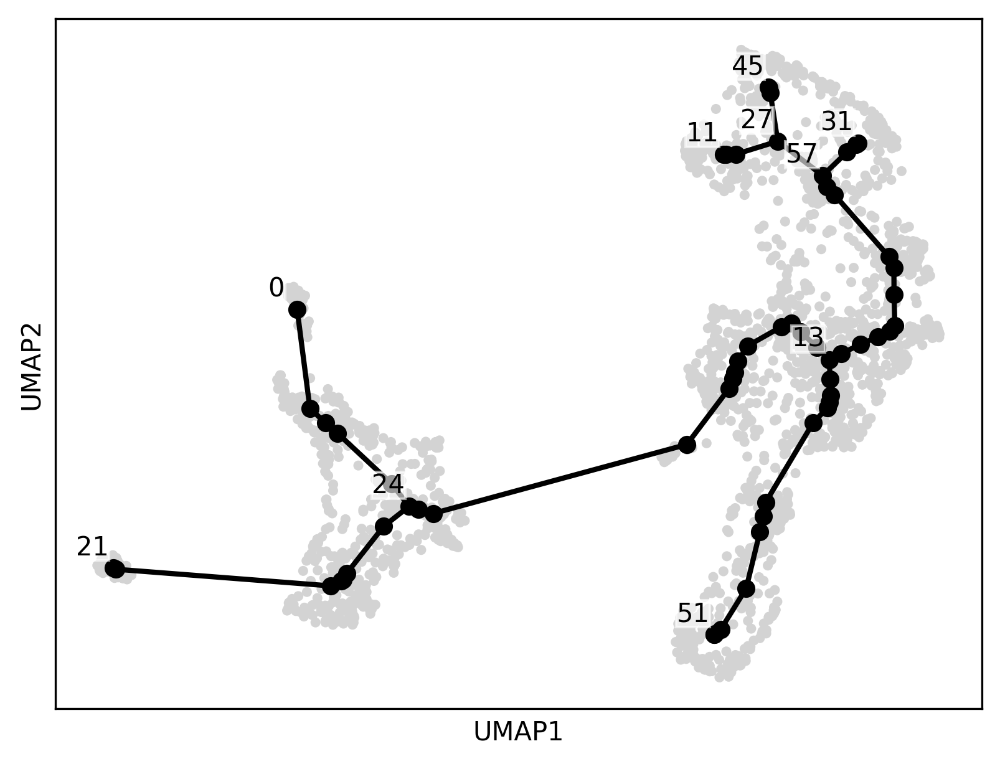

inferring a principal tree --> parameters used 
    20 principal points, sigma = 0.5, lambda = 1, metric = euclidean
    fitting:  18%|█▊        | 18/100 [00:00<00:00, 98.37it/s] 
    converged
    finished (0:00:00) --> added 
    .uns['ppt'], dictionnary containing inferred tree.
    .obsm['X_R'] soft assignment of cells to principal points.
    .uns['graph']['B'] adjacency matrix of the principal points.
    .uns['graph']['F'] coordinates of principal points in representation space.


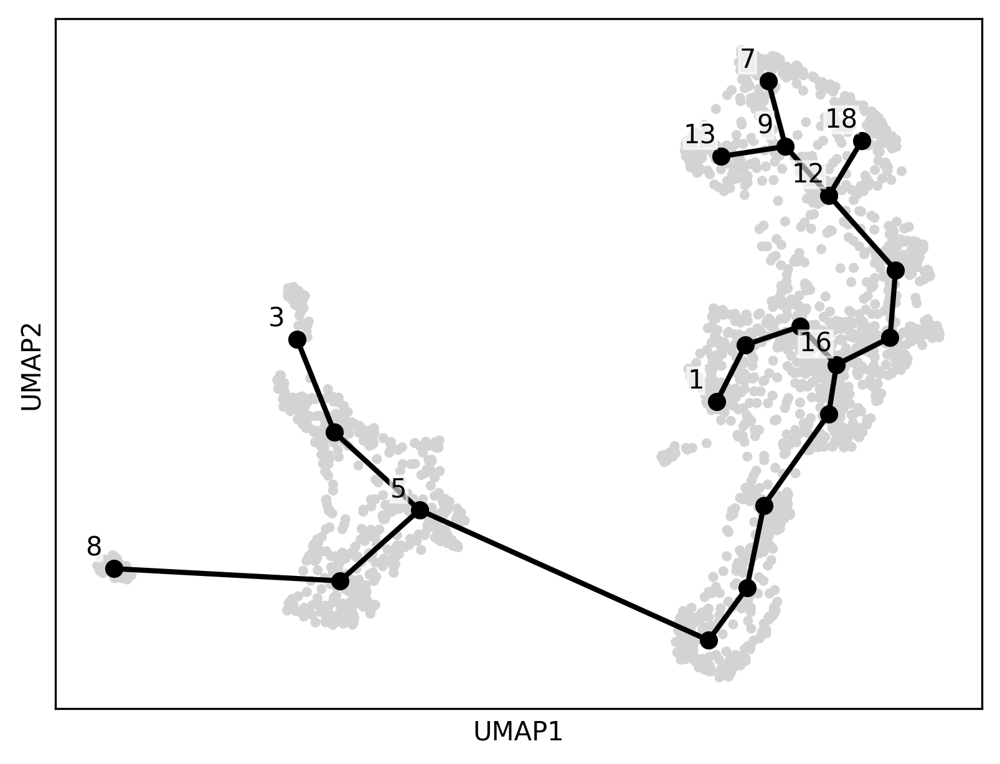

inferring a principal tree --> parameters used 
    45 principal points, sigma = 0.8, lambda = 1, metric = euclidean
    fitting:  33%|███▎      | 33/100 [00:00<00:00, 67.31it/s]
    converged
    finished (0:00:00) --> added 
    .uns['ppt'], dictionnary containing inferred tree.
    .obsm['X_R'] soft assignment of cells to principal points.
    .uns['graph']['B'] adjacency matrix of the principal points.
    .uns['graph']['F'] coordinates of principal points in representation space.


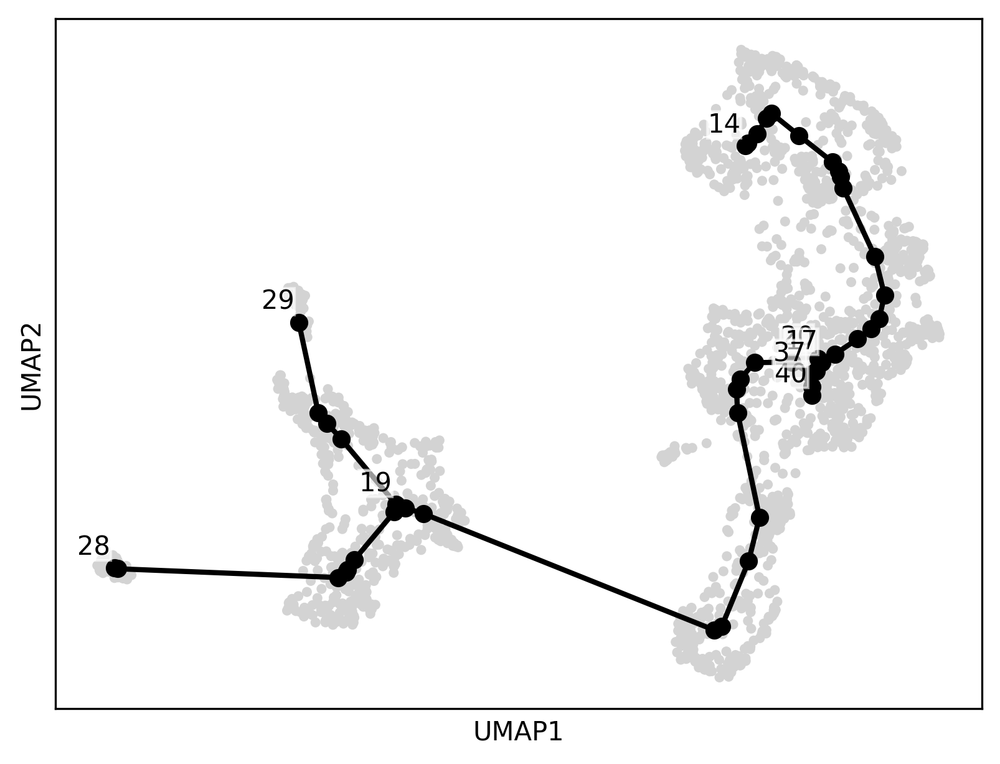

inferring a principal tree --> parameters used 
    50 principal points, sigma = 0.5, lambda = 1, metric = euclidean
    fitting:  31%|███       | 31/100 [00:00<00:01, 68.29it/s]
    converged
    finished (0:00:00) --> added 
    .uns['ppt'], dictionnary containing inferred tree.
    .obsm['X_R'] soft assignment of cells to principal points.
    .uns['graph']['B'] adjacency matrix of the principal points.
    .uns['graph']['F'] coordinates of principal points in representation space.


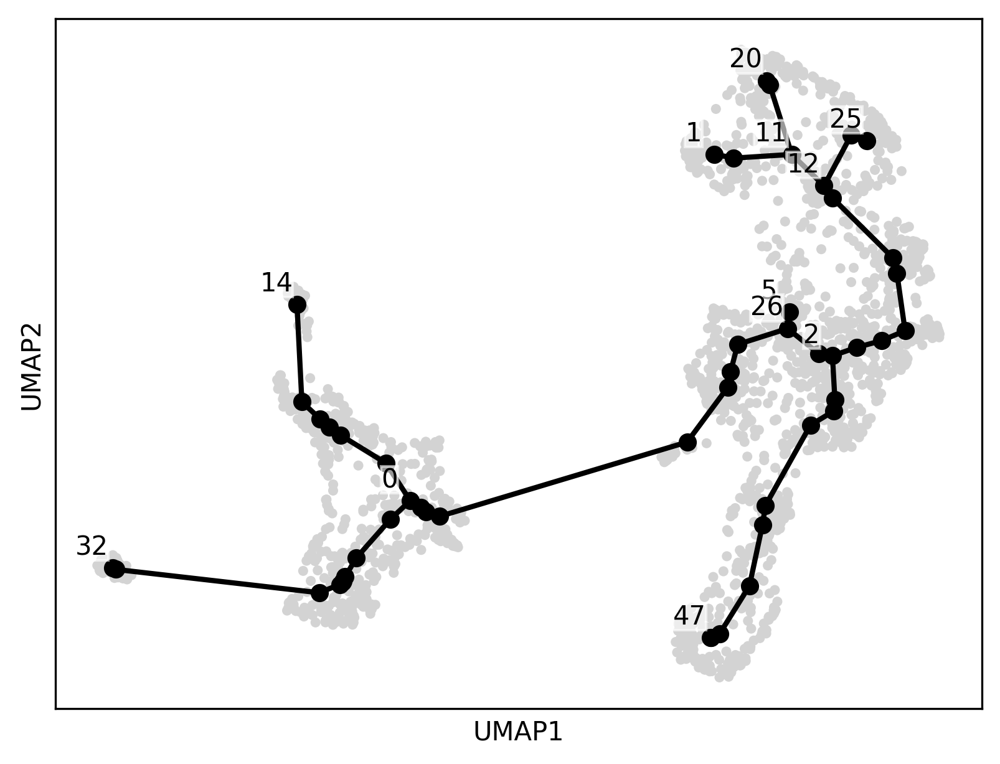

inferring a principal tree --> parameters used 
    50 principal points, sigma = 0.6, lambda = 1, metric = euclidean
    fitting:  29%|██▉       | 29/100 [00:00<00:01, 55.76it/s]
    converged
    finished (0:00:00) --> added 
    .uns['ppt'], dictionnary containing inferred tree.
    .obsm['X_R'] soft assignment of cells to principal points.
    .uns['graph']['B'] adjacency matrix of the principal points.
    .uns['graph']['F'] coordinates of principal points in representation space.


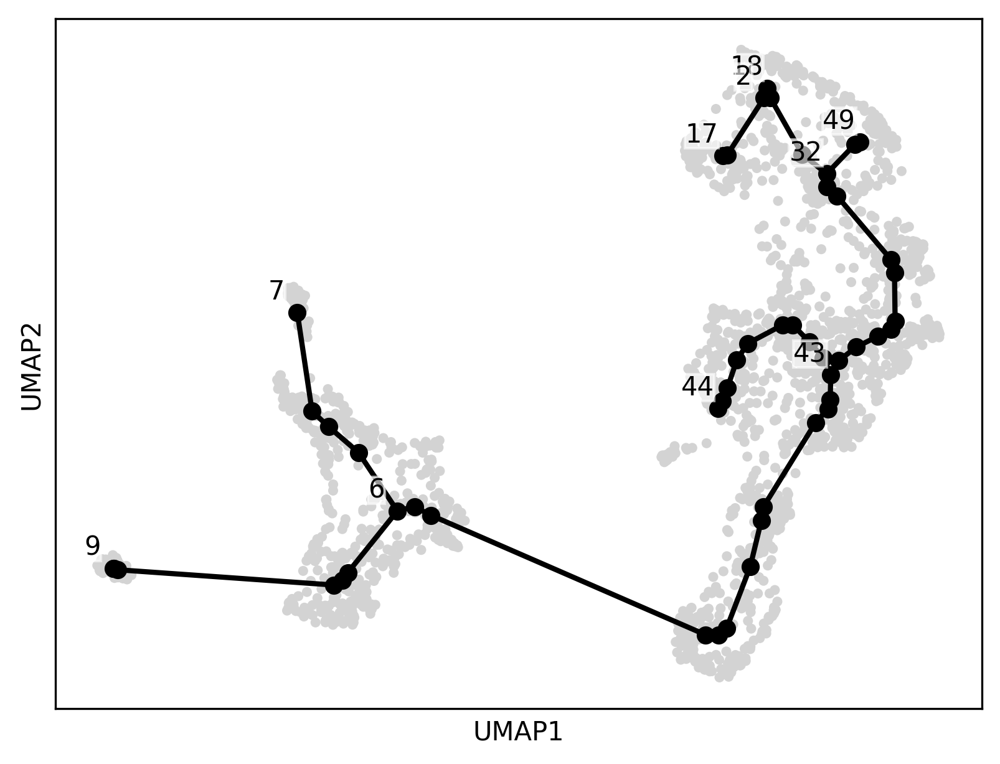

inferring a principal tree --> parameters used 
    50 principal points, sigma = 0.7, lambda = 1, metric = euclidean
    fitting:  49%|████▉     | 49/100 [00:00<00:00, 60.36it/s]
    converged
    finished (0:00:00) --> added 
    .uns['ppt'], dictionnary containing inferred tree.
    .obsm['X_R'] soft assignment of cells to principal points.
    .uns['graph']['B'] adjacency matrix of the principal points.
    .uns['graph']['F'] coordinates of principal points in representation space.


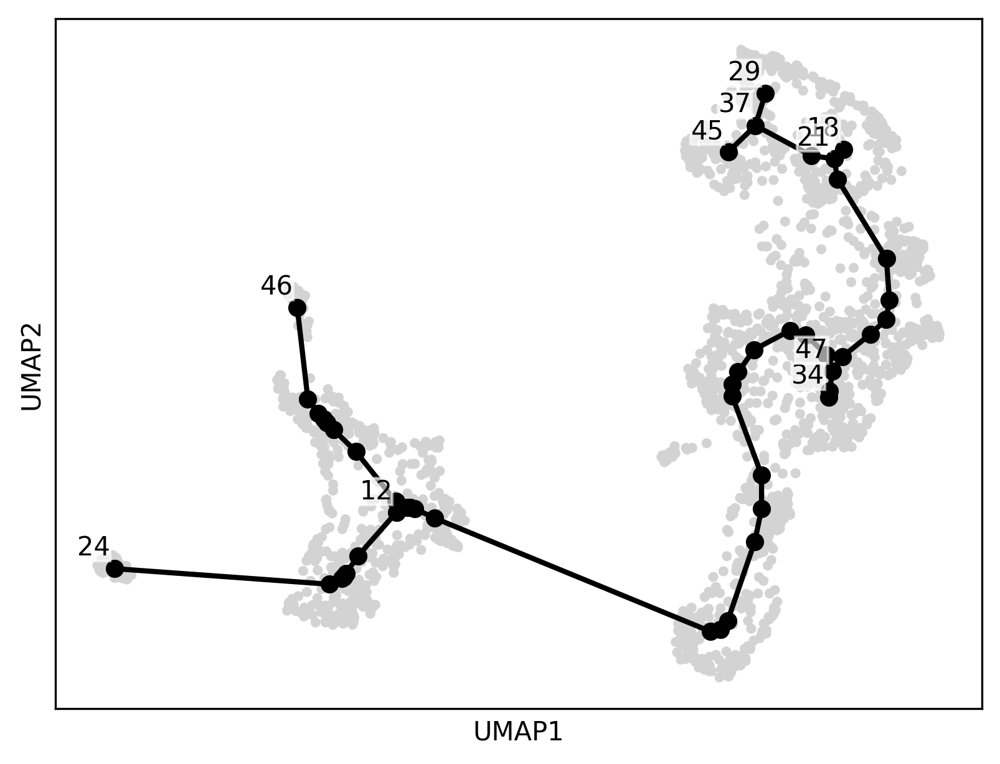

inferring a principal tree --> parameters used 
    60 principal points, sigma = 0.5, lambda = 1, metric = euclidean
    fitting:  69%|██████▉   | 69/100 [00:01<00:00, 62.58it/s]
    converged
    finished (0:00:01) --> added 
    .uns['ppt'], dictionnary containing inferred tree.
    .obsm['X_R'] soft assignment of cells to principal points.
    .uns['graph']['B'] adjacency matrix of the principal points.
    .uns['graph']['F'] coordinates of principal points in representation space.


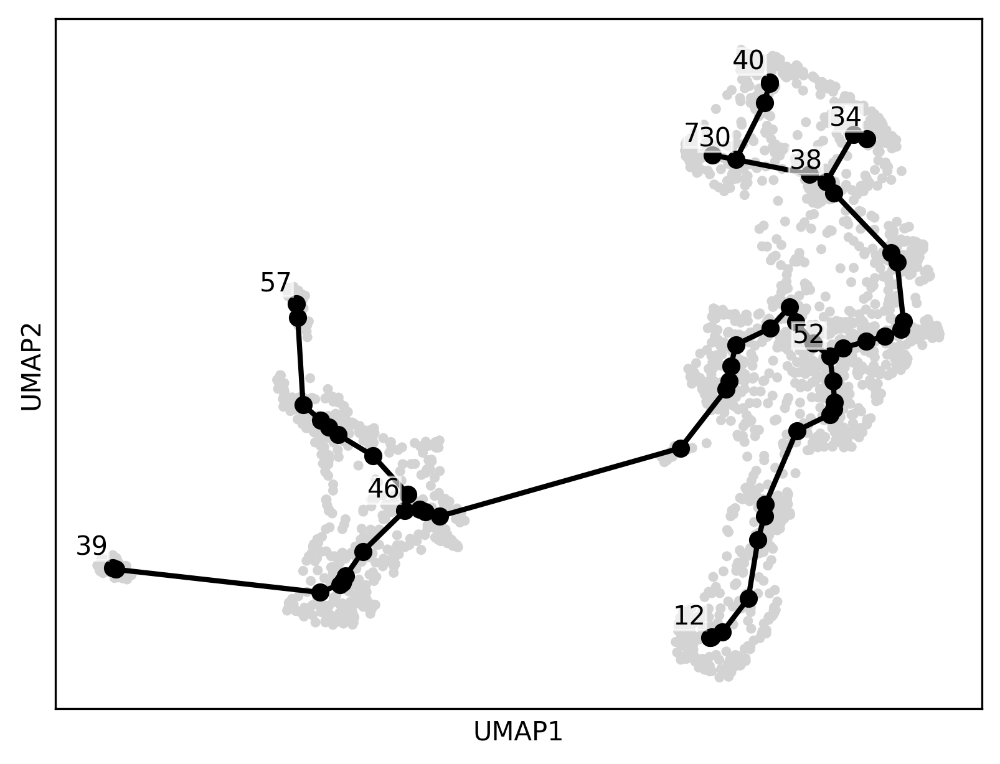

inferring a principal tree --> parameters used 
    40 principal points, sigma = 0.8, lambda = 1, metric = euclidean
    fitting:  42%|████▏     | 42/100 [00:00<00:00, 63.47it/s]
    converged
    finished (0:00:00) --> added 
    .uns['ppt'], dictionnary containing inferred tree.
    .obsm['X_R'] soft assignment of cells to principal points.
    .uns['graph']['B'] adjacency matrix of the principal points.
    .uns['graph']['F'] coordinates of principal points in representation space.


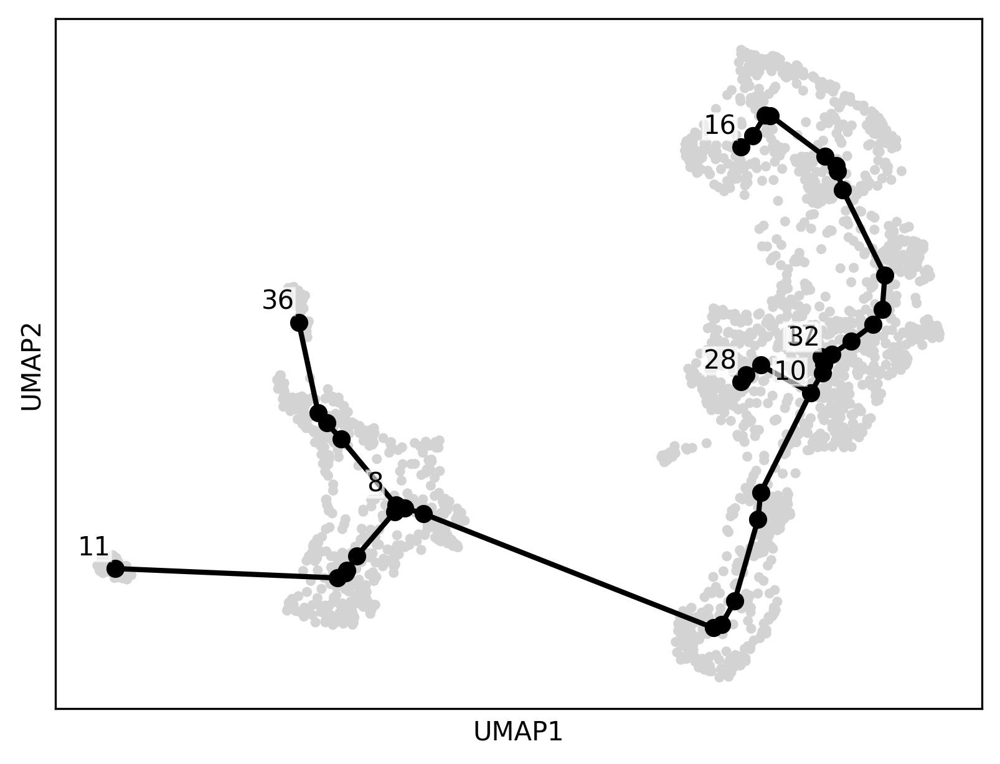

In [ ]:
# 60 principal points, sigma = 0.6, lambda = 1
scf.tl.tree(adNorm_Mesoderm_subset, method ='ppt',Nodes = 60, use_rep = 'X_umap', ppt_lmabda =100, ppt_sigma= 0.6, ppt_nsteps = 100)
scf.pl.graph(adNorm_Mesoderm_subset, basis='umap')
# 20 principal points, sigma = 0.5, lambda = 1
scf.tl.tree(adNorm_Mesoderm_subset, method ='ppt',Nodes = 20, use_rep = 'X_umap', ppt_lmabda =100, ppt_sigma= 0.5, ppt_nsteps = 100)
scf.pl.graph(adNorm_Mesoderm_subset, basis='umap')
# 45 principal points, sigma = 0.8, lambda = 1
scf.tl.tree(adNorm_Mesoderm_subset, method ='ppt',Nodes = 45, use_rep = 'X_umap', ppt_lmabda =100, ppt_sigma= 0.8, ppt_nsteps = 100)
scf.pl.graph(adNorm_Mesoderm_subset, basis='umap')
# 50 principal points, sigma = 0.5, lambda = 1;
scf.tl.tree(adNorm_Mesoderm_subset, method ='ppt',Nodes = 50, use_rep = 'X_umap', ppt_lmabda =100, ppt_sigma= 0.5, ppt_nsteps = 100)
scf.pl.graph(adNorm_Mesoderm_subset, basis='umap')
# 50 principal points, sigma = 0.6, lambda = 1;
scf.tl.tree(adNorm_Mesoderm_subset, method ='ppt',Nodes = 50, use_rep = 'X_umap', ppt_lmabda =100, ppt_sigma= 0.6, ppt_nsteps = 100)
scf.pl.graph(adNorm_Mesoderm_subset, basis='umap')
# 50 principal points, sigma = 0.7, lambda = 1;
scf.tl.tree(adNorm_Mesoderm_subset, method ='ppt',Nodes = 50, use_rep = 'X_umap', ppt_lmabda =100, ppt_sigma= 0.7, ppt_nsteps = 100)
scf.pl.graph(adNorm_Mesoderm_subset, basis='umap')
# 60 principal points, sigma = 0.5, lambda = 1;
scf.tl.tree(adNorm_Mesoderm_subset, method ='ppt',Nodes = 60, use_rep = 'X_umap', ppt_lmabda =100, ppt_sigma= 0.5, ppt_nsteps = 100)
scf.pl.graph(adNorm_Mesoderm_subset, basis='umap')
# 40 principal points, sigma = 0.8, lambda = 1
scf.tl.tree(adNorm_Mesoderm_subset, method ='ppt',Nodes = 40, use_rep = 'X_umap', ppt_lmabda =100, ppt_sigma= 0.8, ppt_nsteps = 100)
scf.pl.graph(adNorm_Mesoderm_subset, basis='umap')

 50 principal points, sigma = 0.6, lambda = 1 and  60 principal points, sigma = 0.8, lambda = 1; seems to generate the best fitting, continue with this parameters

inferring a principal tree --> parameters used 
    60 principal points, sigma = 0.8, lambda = 1, metric = euclidean
    fitting:  82%|████████▏ | 82/100 [00:01<00:00, 41.27it/s]
    converged
    finished (0:00:02) --> added 
    .uns['ppt'], dictionnary containing inferred tree.
    .obsm['X_R'] soft assignment of cells to principal points.
    .uns['graph']['B'] adjacency matrix of the principal points.
    .uns['graph']['F'] coordinates of principal points in representation space.


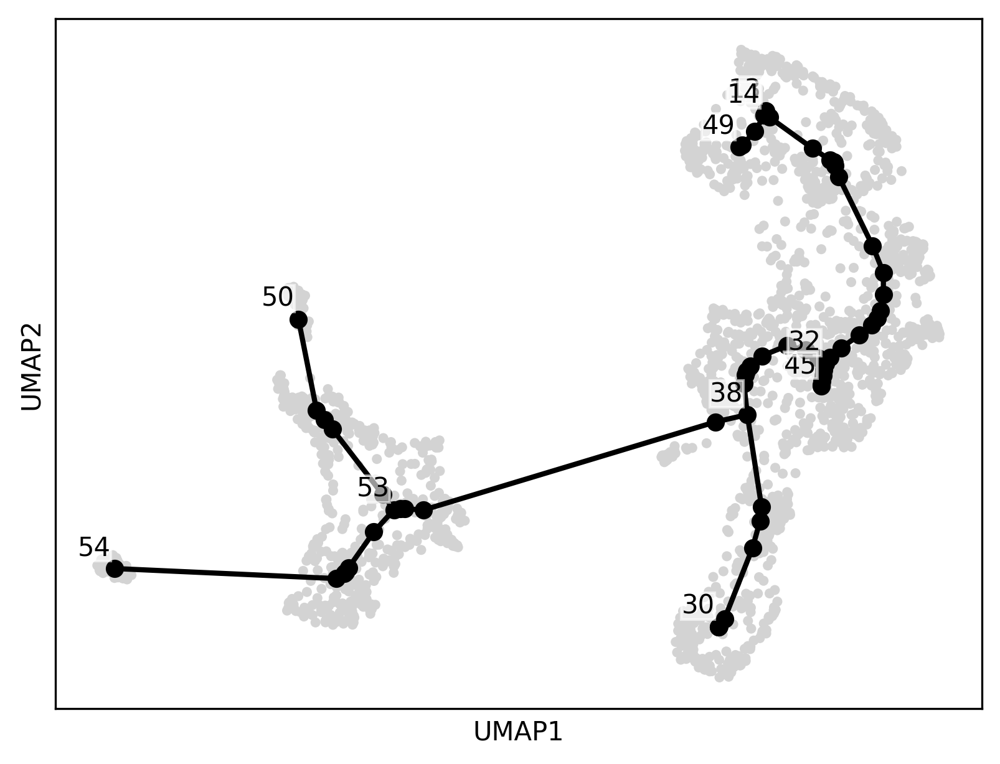

inferring a principal tree --> parameters used 
    50 principal points, sigma = 0.6, lambda = 1, metric = euclidean
    fitting:  49%|████▉     | 49/100 [00:00<00:00, 67.05it/s]
    converged
    finished (0:00:00) --> added 
    .uns['ppt'], dictionnary containing inferred tree.
    .obsm['X_R'] soft assignment of cells to principal points.
    .uns['graph']['B'] adjacency matrix of the principal points.
    .uns['graph']['F'] coordinates of principal points in representation space.


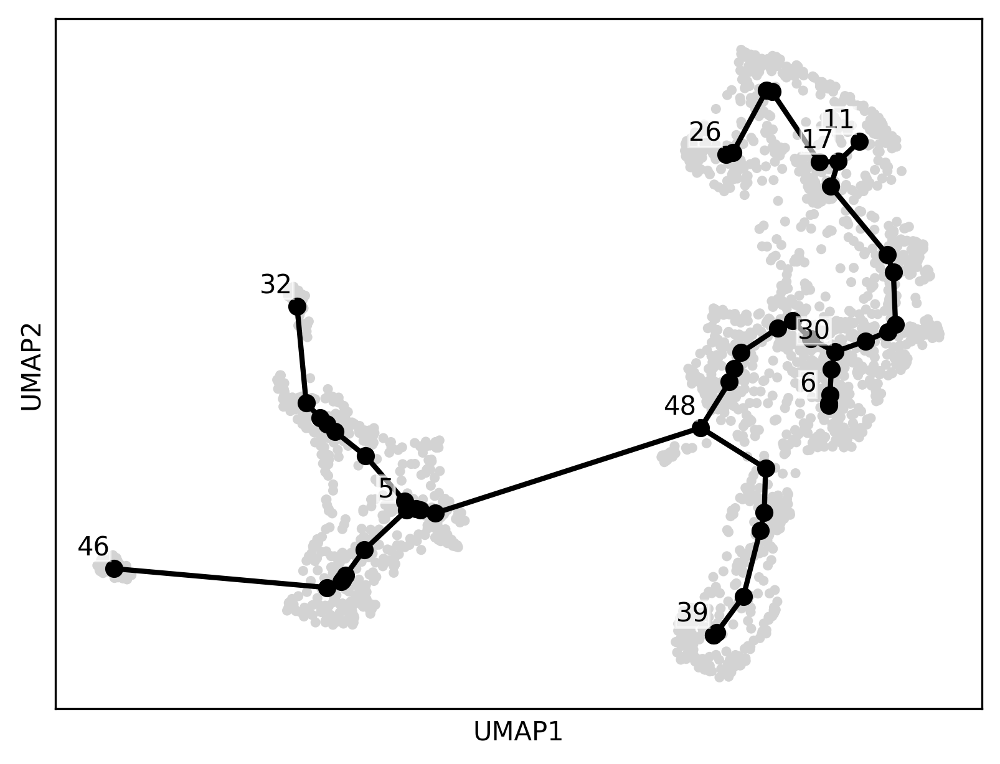

inferring a principal tree --> parameters used 
    20 principal points, sigma = 0.5, lambda = 1, metric = euclidean
    fitting:  71%|███████   | 71/100 [00:01<00:00, 50.81it/s]
    converged
    finished (0:00:01) --> added 
    .uns['ppt'], dictionnary containing inferred tree.
    .obsm['X_R'] soft assignment of cells to principal points.
    .uns['graph']['B'] adjacency matrix of the principal points.
    .uns['graph']['F'] coordinates of principal points in representation space.


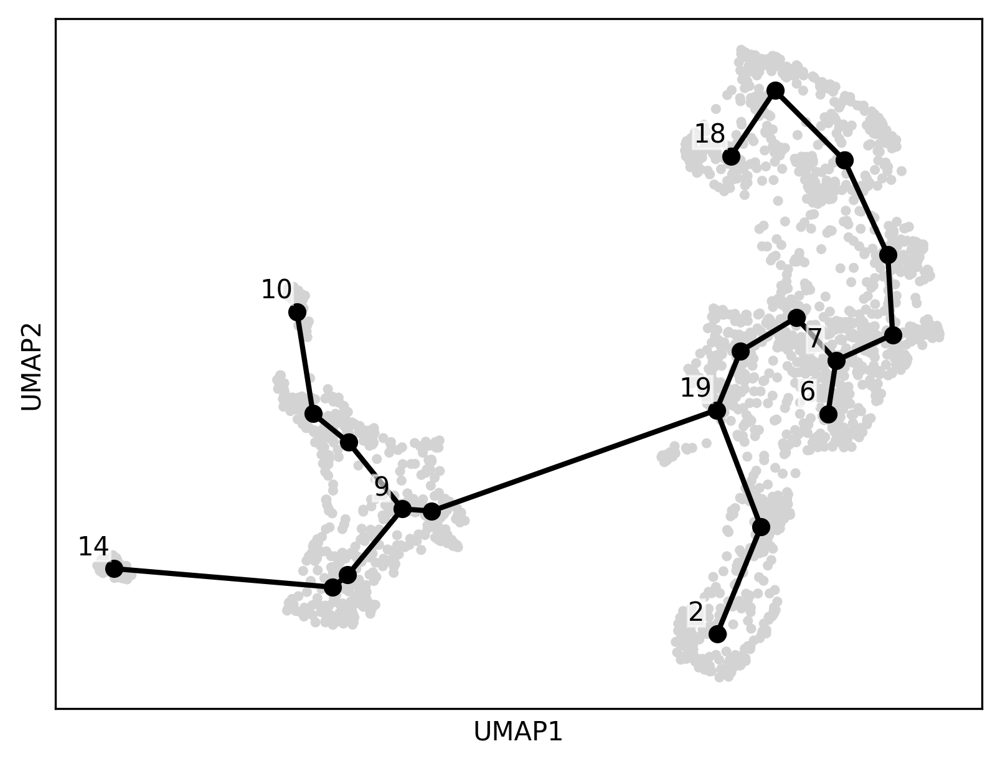

In [ ]:
# rerun the fitting
# sigma= 0.8, Nodes = 60
np.random.seed(19)
scf.tl.tree(adNorm_Mesoderm_subset, method ='ppt',Nodes = 60, use_rep = 'X_umap', ppt_lmabda =100, ppt_sigma= 0.8, ppt_nsteps = 100)
scf.pl.graph(adNorm_Mesoderm_subset, basis='umap')
# sigma= 0.6, Nodes = 50
np.random.seed(17)
scf.tl.tree(adNorm_Mesoderm_subset, method ='ppt',Nodes = 50, use_rep = 'X_umap', ppt_lmabda =100, ppt_sigma= 0.6, ppt_nsteps = 100)
scf.pl.graph(adNorm_Mesoderm_subset, basis='umap')
# sigma= 0.5, Nodes = 20
np.random.seed(17)
scf.tl.tree(adNorm_Mesoderm_subset, method ='ppt',Nodes = 20, use_rep = 'X_umap', ppt_lmabda =100, ppt_sigma= 0.5, ppt_nsteps = 100)
scf.pl.graph(adNorm_Mesoderm_subset, basis='umap')


node 6 selected as a root --> added
    .uns['graph']['root'] selected root.
    .uns['graph']['pp_info'] for each PP, its distance vs root and segment assignment.
    .uns['graph']['pp_seg'] segments network information.
projecting cells onto the principal graph
    finished (0:00:03) --> added
    .obs['edge'] assigned edge.
    .obs['t'] pseudotime value.
    .obs['seg'] segment of the tree assigned.
    .obs['milestones'] milestone assigned.
    .uns['pseudotime_list'] list of cell projection from all mappings.


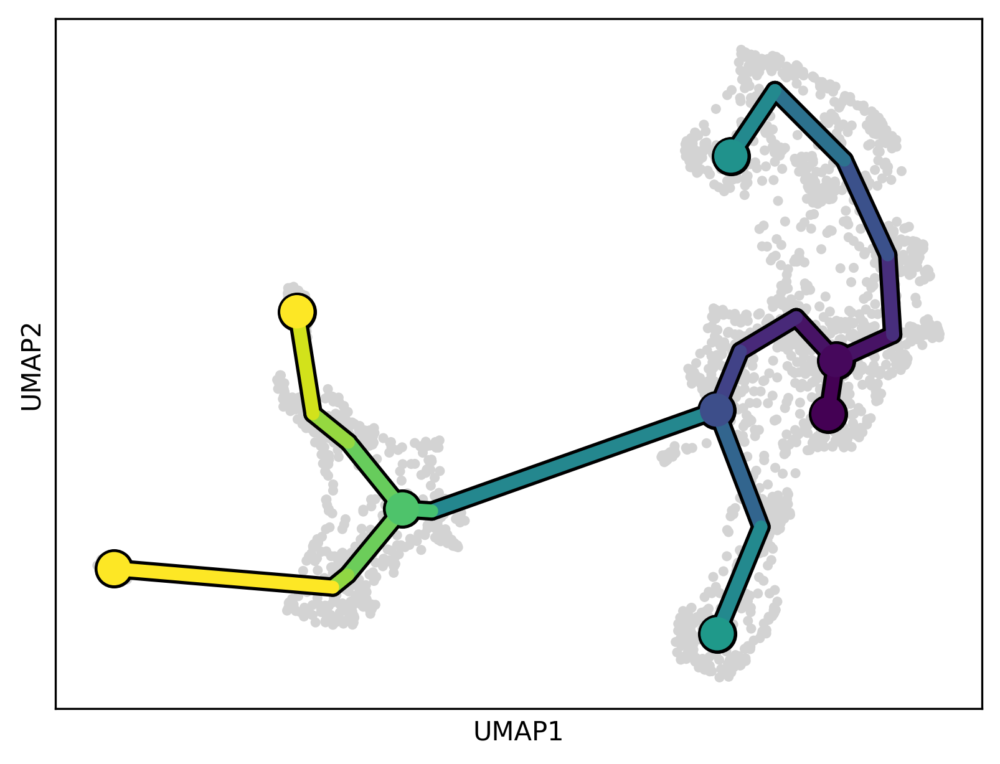

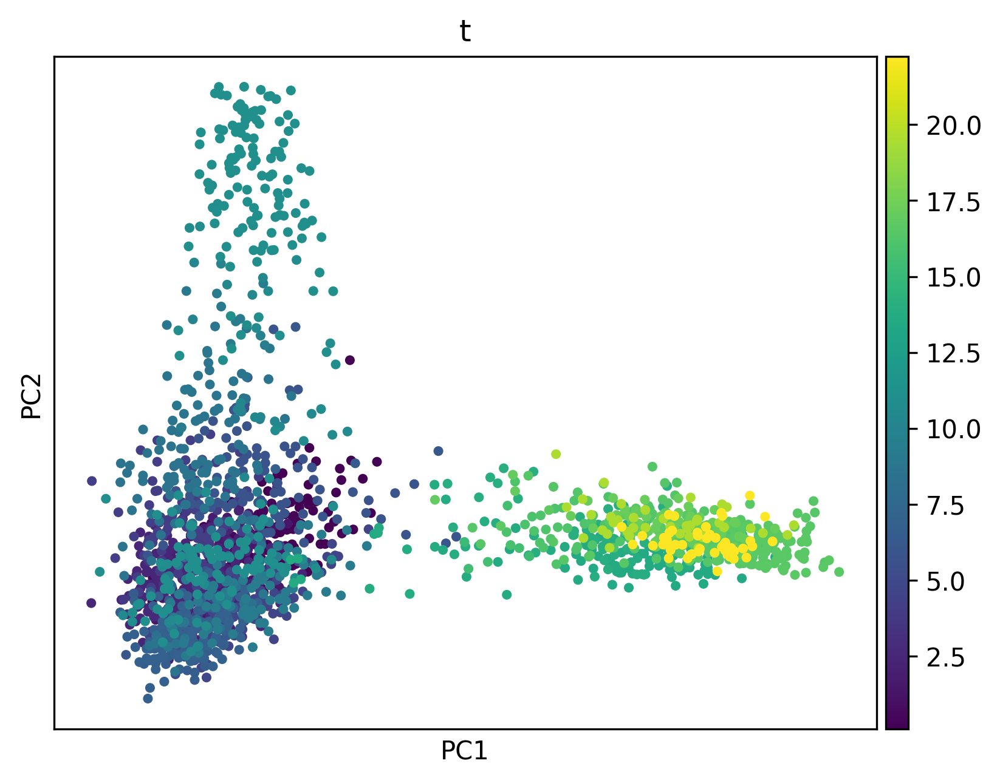

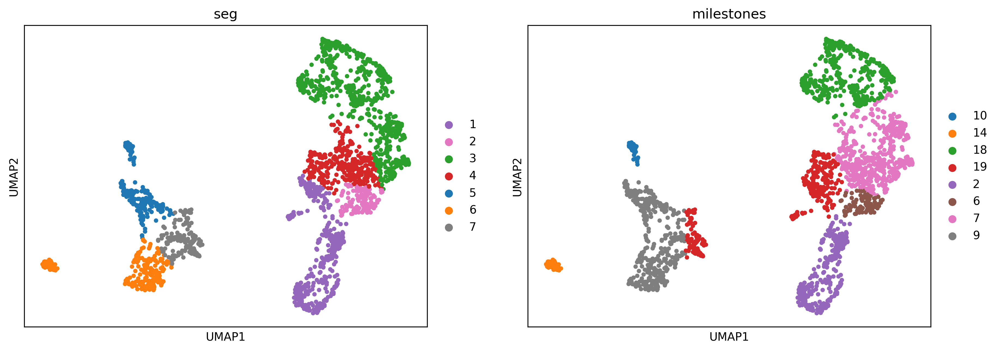

Generating dendrogram of tree
    segment : 100%|██████████| 7/7 [00:09<00:00,  1.29s/it]
    finished (0:00:09) --> added 
    .obsm['X_dendro'], new embedding generated.
    .uns['dendro_segments'] tree segments used for plotting.


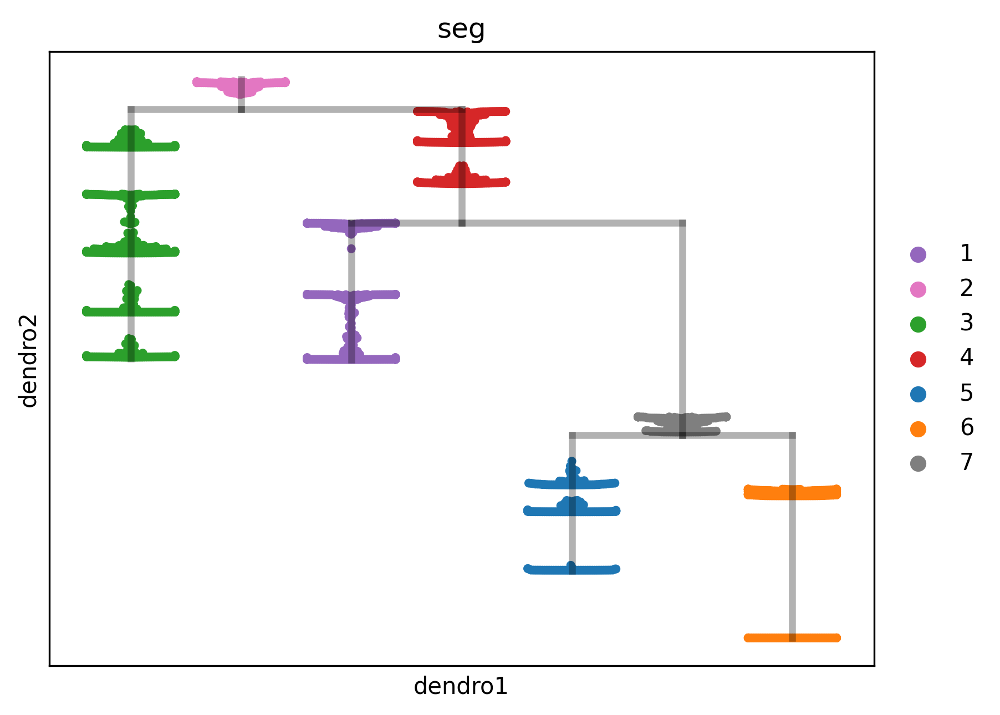

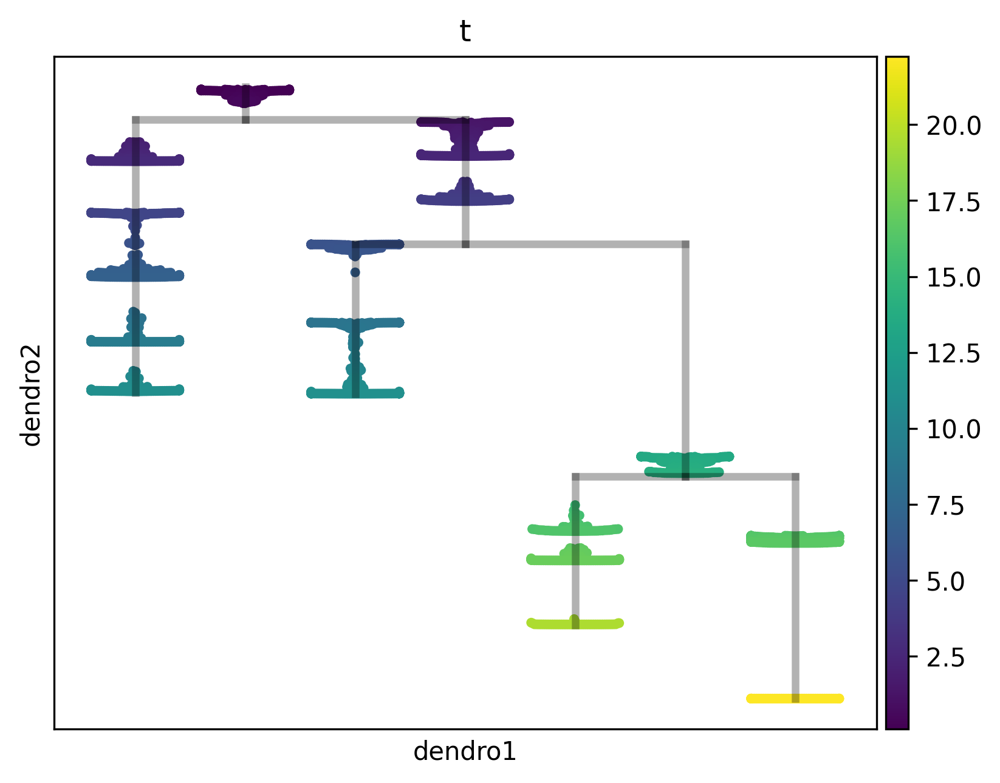

In [ ]:
# artificially defining the root, supervised
scf.tl.root(adNorm_Mesoderm_subset,6)
import warnings
# Ignore specific deprecation warnings from libraries
warnings.filterwarnings('ignore', category=DeprecationWarning, message=".*Graph.shortest_paths.*")
warnings.filterwarnings('ignore', category=DeprecationWarning, message=".*np.find_common_type is deprecated.*")
scf.tl.pseudotime(adNorm_Mesoderm_subset, seed = 17)
scf.pl.trajectory(adNorm_Mesoderm_subset,basis = 'umap')
sc.pl.pca(adNorm_Mesoderm_subset,color = 't')
# visualization
sc.pl.umap(adNorm_Mesoderm_subset, color = ['seg','milestones'])
scf.tl.dendrogram(adNorm_Mesoderm_subset)
scf.pl.dendrogram(adNorm_Mesoderm_subset, color= 'seg')
scf.pl.dendrogram(adNorm_Mesoderm_subset, color ='t')

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


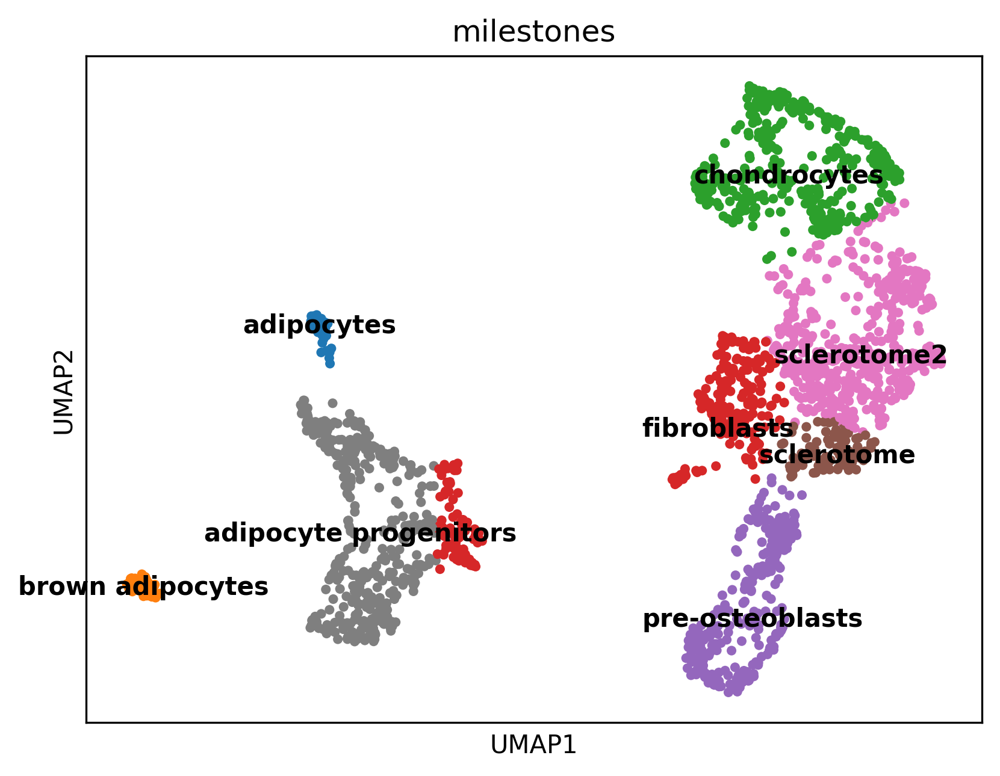

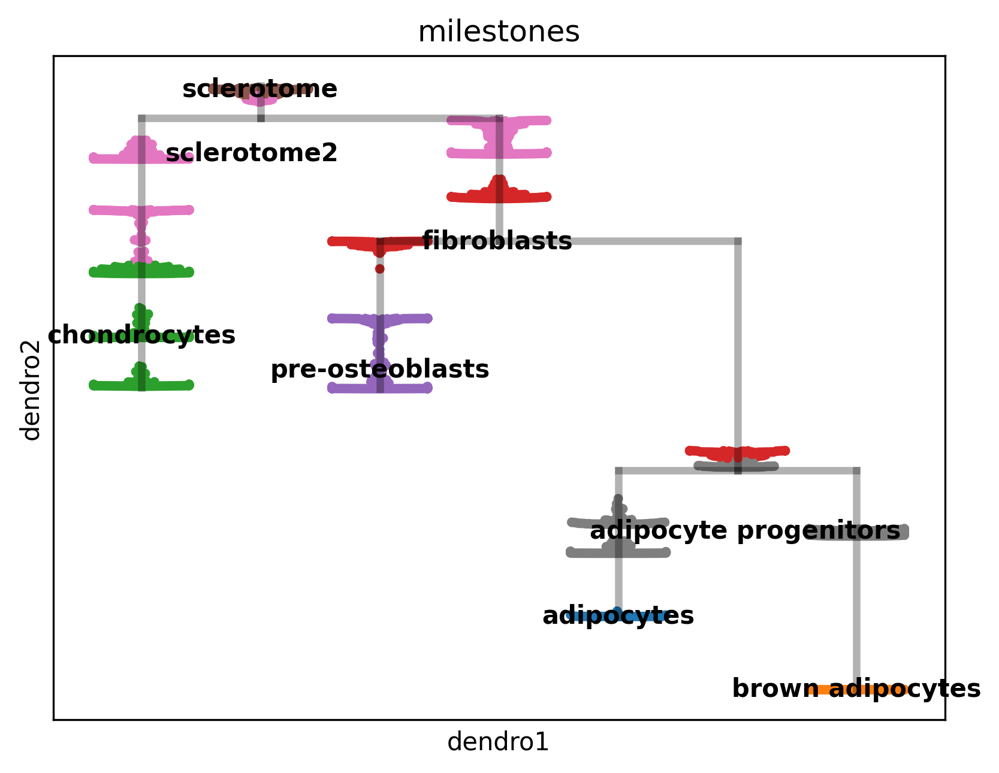

categories: Adipocyte cells (Cyp2e1+), Adipocyte progenitor cells, Brown adipocyte cells, etc.
var_group_labels: Adipocyte cells (Cyp2e1+), Adipocyte progenitor cells, Brown adipocyte cells, etc.


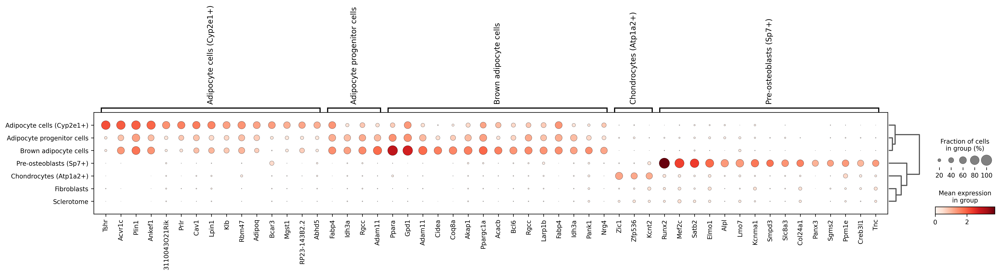

In [ ]:
# renaming milestonesadipocyte pro
scf.tl.rename_milestones(adNorm_Mesoderm_subset, ['adipocytes','brown adipocytes','chondrocytes','fibroblasts','pre-osteoblasts','sclerotome','sclerotome2','adipocyte progenitors'])
sc.pl.umap(adNorm_Mesoderm_subset, color=['milestones'],legend_loc='on data')
# dendrogram on milestones
scf.pl.dendrogram(adNorm_Mesoderm_subset, color ='milestones',legend_loc='on data')
#DEG
sc.tl.rank_genes_groups(adNorm_Mesoderm_subset, use_raw=False, groupby="celltype_update",method='wilcoxon')
sc.tl.filter_rank_genes_groups(adNorm_Mesoderm_subset, min_fold_change=0.3, min_in_group_fraction=0.5, max_out_group_fraction=0.15)
sc.pl.rank_genes_groups_dotplot(adNorm_Mesoderm_subset, n_genes=15, groupby="celltype_update", dendrogram=True, key='rank_genes_groups_filtered')

#### Even though we have literature evidence, here we perform cytoTRACE to validate the pseudotime analysis performed and target cell type development patterns

In [ ]:
np.random.seed(42)
#cytoTRACE preprocessing:copying X matrix into the layers
adcyto= adNorm_Mesoderm_subset.copy()
adcyto.layers["spliced"] = adcyto.X
adcyto.layers["unspliced"] = adcyto.X
scv.pp.moments(adcyto, n_pcs=5, n_neighbors=30)
print(adcyto)
# compute the CytoTRACE score
from cellrank.kernels import CytoTRACEKernel
ctk = CytoTRACEKernel(adcyto).compute_cytotrace()
sc.pl.embedding(
    adcyto,
    color=['ct_pseudotime'],
    basis='X_umap',
    color_map="gnuplot2",
)
# visualize cytoTRACE score quantitatively
sc.pl.violin(adcyto, keys=['ct_pseudotime'], groupby='celltype_update', rotation=90)
# Compute and Visualize a transition matrix
ctk.compute_transition_matrix(threshold_scheme="soft", nu=0.5)
ctk.plot_projection(basis="X_umap", color='celltype_update', legend_loc="right")

# random-walk validation
ctk.plot_random_walks(
    n_sims=500,
    start_ixs={"celltype_update": "Sclerotome"},
    basis="X_umap",
    color="celltype_update",
    legend_loc="right",
    seed=6,
)

The transition graph patterns matches the literature evidence, suggesting the previous pseudotime inference is correct.

test features for association with the trajectory
    single mapping : 100%|██████████| 3974/3974 [27:21<00:00,  2.42it/s]
    found 1625 significant features (0:27:21) --> added
    .var['p_val'] values from statistical test.
    .var['fdr'] corrected values from multiple testing.
    .var['st'] proportion of mapping in which feature is significant.
    .var['A'] amplitue of change of tested feature.
    .var['signi'] feature is significantly changing along pseudotime.
    .uns['stat_assoc_list'] list of fitted features on the graph for all mappings.
fit features associated with the trajectory
    single mapping : 100%|██████████| 1625/1625 [14:54<00:00,  1.82it/s]
    finished (adata subsetted to keep only fitted features!) (0:14:55) --> added
    .layers['fitted'], fitted features on the trajectory for all mappings.
    .raw, unfiltered data.


/usr/local/lib/python3.10/dist-packages/scanpy/_settings.py:450: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)


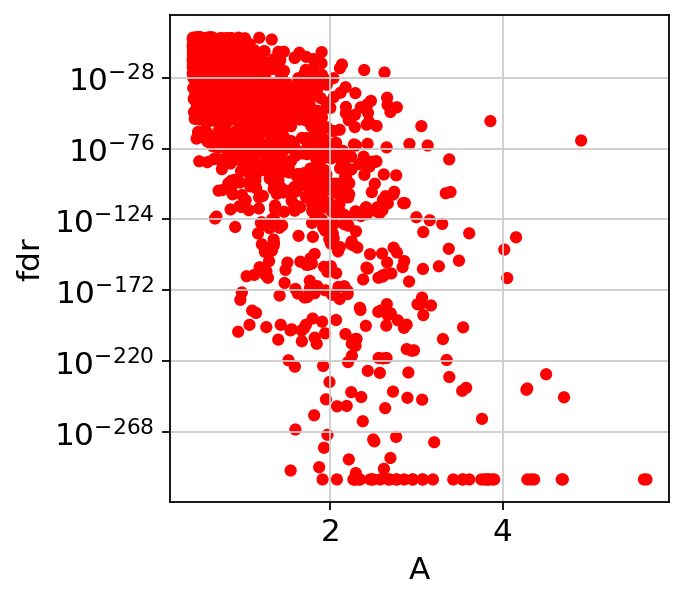

In [ ]:
# subsetting the data to only contain HVG
ad = adNorm_Mesoderm_subset.copy()
ad = adNorm_Mesoderm_subset[:, adNorm_Mesoderm_subset.var['highly_variable']]
ad.shape
scf.tl.test_association(ad, fdr_cut=0.25, A_cut = 0.4)
# fits genes to trajectory
ad_t = ad.copy()
scf.tl.fit(ad_t)
ad_t.var
sc.set_figure_params()
scf.pl.test_association(ad_t)

### All branches DE analysis

In [ ]:
import warnings
warnings.filterwarnings('ignore')
scf.tl.test_fork(ad_t,root_milestone = 'sclerotome',milestones = ['adipocytes','brown adipocytes','chondrocytes','pre-osteoblasts'],rescale = True)
scf.tl.branch_specific(ad_t,root_milestone = 'sclerotome',milestones = ['adipocytes','brown adipocytes','chondrocytes','pre-osteoblasts'],effect = 0.5)


testing fork
    single mapping
    Differential expression: 100%|██████████| 1625/1625 [11:24<00:00,  2.37it/s]
    test for upregulation for each leave vs root
    upreg pre-osteoblasts: 100%|██████████| 415/415 [00:07<00:00, 57.00it/s]
    finished (0:11:51) --> added 
    .uns['sclerotome->adipocytes<>brown adipocytes<>chondrocytes<>pre-osteoblasts']['fork'], DataFrame with fork test results.
    branch specific features: adipocytes: 32, pre-osteoblasts: 31, brown adipocytes: 29, chondrocytes: 9
    finished --> updated 
    .uns['sclerotome->adipocytes<>brown adipocytes<>chondrocytes<>pre-osteoblasts']['fork'], DataFrame updated with additionnal 'branch' column.


Col5a2       pre-osteoblasts
Acadl       brown adipocytes
Erbb4       brown adipocytes
Serpine2     pre-osteoblasts
Cfh          pre-osteoblasts
                  ...       
Mpp7              adipocytes
Lox          pre-osteoblasts
Ppargc1b    brown adipocytes
Prkg1           chondrocytes
Sorbs1            adipocytes
Name: branch, Length: 101, dtype: object


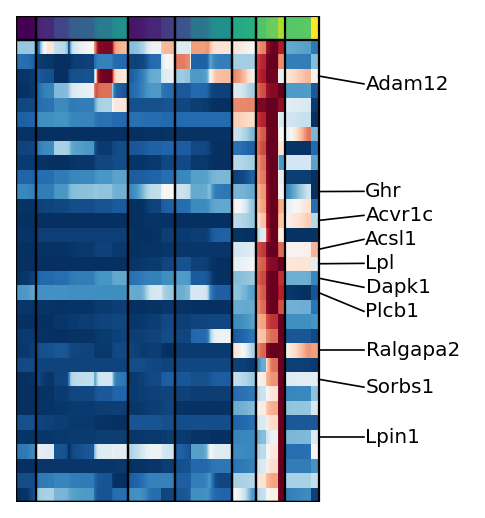

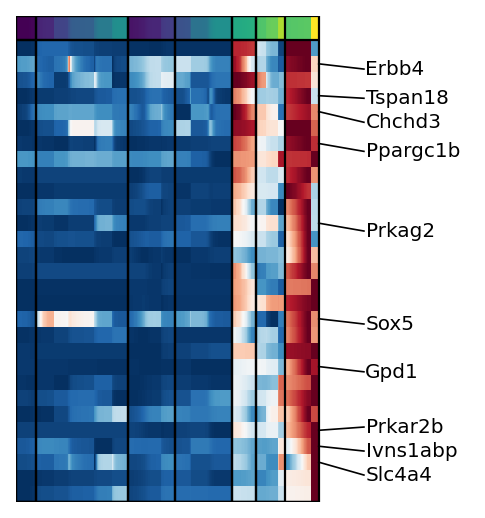

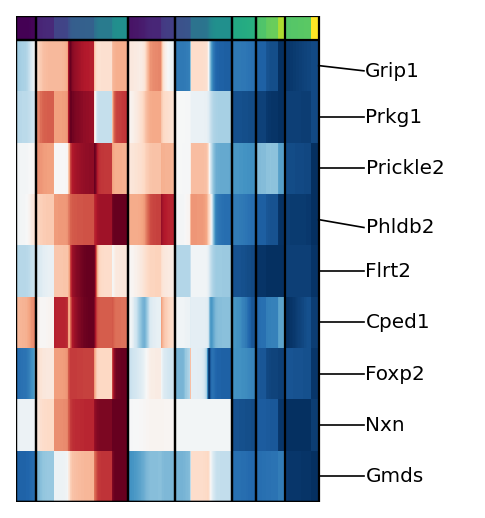

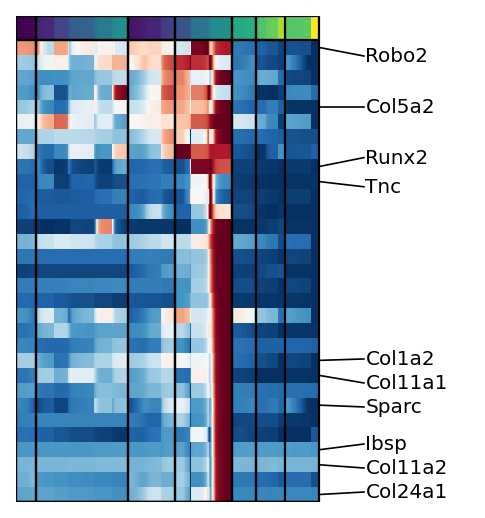

In [ ]:
# displaying results
# adipocytes
g1=scf.pl.trends(ad_t,
                root_milestone='sclerotome',
                 milestones=['adipocytes','brown adipocytes','chondrocytes','pre-osteoblasts'],
                 branch='adipocytes',
                 plot_emb=False,ordering="max",return_genes=True)
# brown adipocytes
g2=scf.pl.trends(ad_t,
                root_milestone='sclerotome',
                 milestones=['adipocytes','brown adipocytes','chondrocytes','pre-osteoblasts'],
                 branch='brown adipocytes',
                 plot_emb=False,ordering="max",return_genes=True)
# chondrocytes
g3=scf.pl.trends(ad_t,
                root_milestone='sclerotome',
                 milestones=['adipocytes','brown adipocytes','chondrocytes','pre-osteoblasts'],
                 branch='chondrocytes',
                 plot_emb=False,ordering="max",return_genes=True)
# pre-osteoblasts
g4=scf.pl.trends(ad_t,
                root_milestone='sclerotome',
                 milestones=['adipocytes','brown adipocytes','chondrocytes','pre-osteoblasts'],
                 branch='pre-osteoblasts',
                 plot_emb=False,ordering="max",return_genes=True)

branch_column = ad_t.uns['sclerotome->adipocytes<>brown adipocytes<>chondrocytes<>pre-osteoblasts']['fork']['branch']
print(branch_column)

In [ ]:
# separate genes that promote brown adipocytes fates separately
# For adipocytes genes
adipocytes_genes = branch_column[branch_column == "adipocytes"].index.tolist()
# For brown adipocyte genes
brownadipocyte_genes = branch_column[branch_column == "brown adipocytes"].index.tolist()
# For chondrocytes genes
chondrocytes_genes = branch_column[branch_column == "chondrocytes"].index.tolist()
# For pre-osteoblasts genes
preosteoblasts_genes = branch_column[branch_column == "pre-osteoblasts"].index.tolist()
print(adipocytes_genes)
print(brownadipocyte_genes)
print(chondrocytes_genes)
print(preosteoblasts_genes)
#Extract genes that are specific to each branch

with open('/content/drive/MyDrive/allTFs_mm_aertslab_011924.txt', 'r') as file:
    mouse_tfs = [line.strip() for line in file]
mouse_tfs_set = set(mouse_tfs)
adipocytes_genes_set = set(adipocytes_genes)
brownadipocyte_genes_set = set(brownadipocyte_genes)
chondrocytes_genes_set = set(chondrocytes_genes)
preosteoblasts_genes_set = set(preosteoblasts_genes)
tf_in_adipocytes = list(mouse_tfs_set.intersection(adipocytes_genes_set))
tf_in_brownadipocyte = list(mouse_tfs_set.intersection(brownadipocyte_genes_set))
tf_in_chondrocytes = list(mouse_tfs_set.intersection(chondrocytes_genes_set))
tf_in_preosteoblasts = list(mouse_tfs_set.intersection(preosteoblasts_genes_set))
print(tf_in_adipocytes)
print(tf_in_brownadipocyte)
print(tf_in_chondrocytes)
print(tf_in_preosteoblasts)


['Acvr1c', 'Plcb1', 'Ankef1', 'Ralgapa2', 'Bcar3', 'St6galnac5', 'Scarb1', 'Cav1', 'Adamts9', 'Mgst1', 'Man2a2', 'Adam12', 'Insr', 'Tacc1', 'Acsl1', 'Lpl', 'Slc27a1', 'Abhd5', 'Pank3', 'Abca8a', 'Lpin1', 'Smoc1', 'Dapk1', 'Tbc1d4', 'Ghr', 'Slc1a3', 'Adamts12', 'Abcd2', 'Hacd2', 'Nrip1', 'Mpp7', 'Sorbs1']
['Acadl', 'Erbb4', 'Ivns1abp', 'Ppp2r5a', 'Tspan18', 'Trim2', 'Acadm', 'Svep1', 'Prkag2', 'Slc4a4', 'Tspan12', 'Chchd3', 'Sox5', 'Lipe', '4931406P16Rik', 'Fam53b', 'Idh3a', 'Etfa', 'Snrk', 'Acyp2', 'Prkar2b', 'Nampt', 'Rgcc', 'Aco2', 'Gpd1', 'Bcl6', 'Park2', 'Dlgap1', 'Ppargc1b']
['Foxp2', 'Cped1', 'Prickle2', 'Grip1', 'Nxn', 'Flrt2', 'Gmds', 'Phldb2', 'Prkg1']
['Col5a2', 'Serpine2', 'Cfh', 'Camk1d', 'Col5a1', 'Creb3l1', 'Col11a1', 'Col24a1', 'Tnc', 'Ibsp', 'Pcolce', 'Actb', 'Col1a2', 'Ptprz1', 'Rerg', 'Serpinh1', 'H19', 'Col12a1', 'Syne1', 'Fyn', 'Unc5b', 'Ckap4', 'Sparc', 'Myo1d', 'Fkbp10', 'Kcnma1', 'Pdzrn4', 'Robo2', 'Col11a2', 'Runx2', 'Lox']
[]
['Bcl6', 'Gpd1', 'Sox5']
['Foxp2']


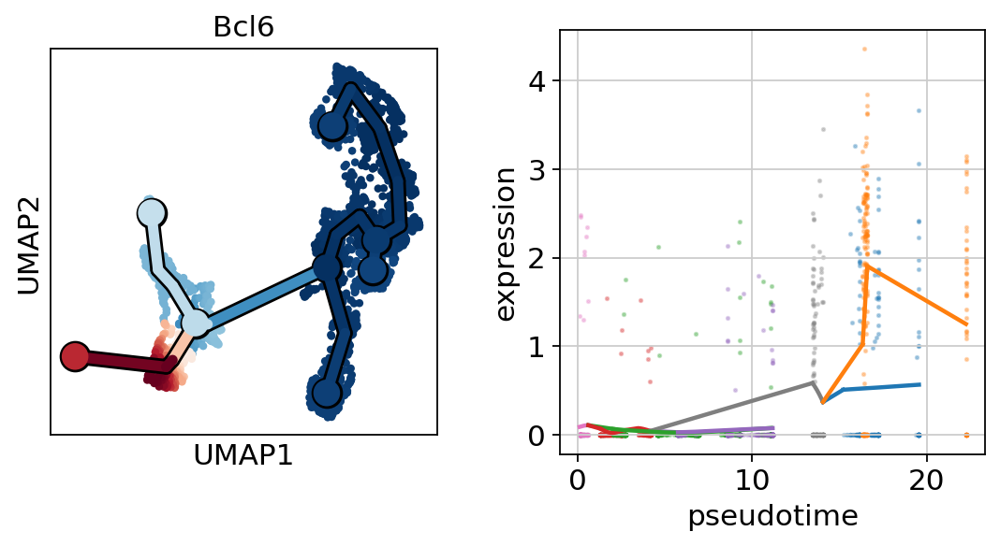

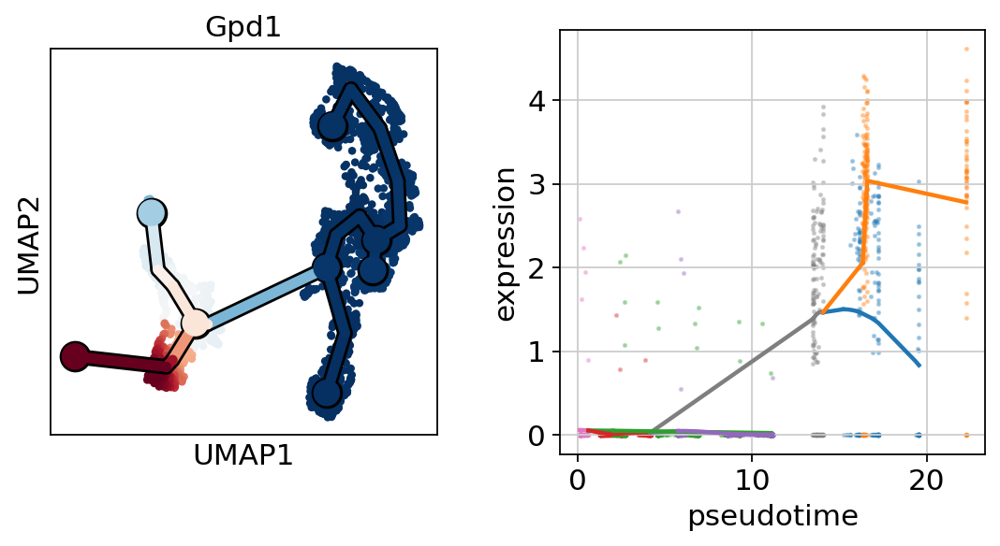

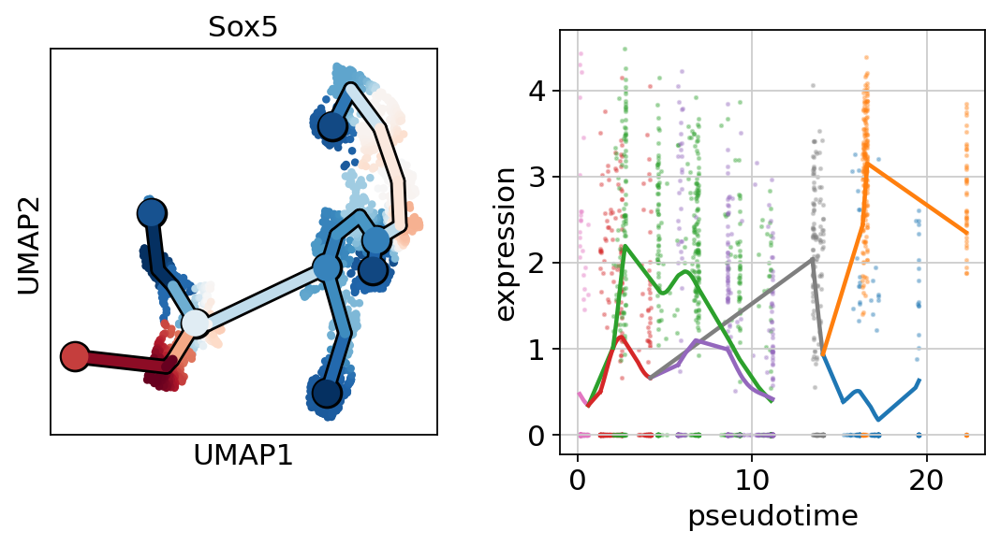

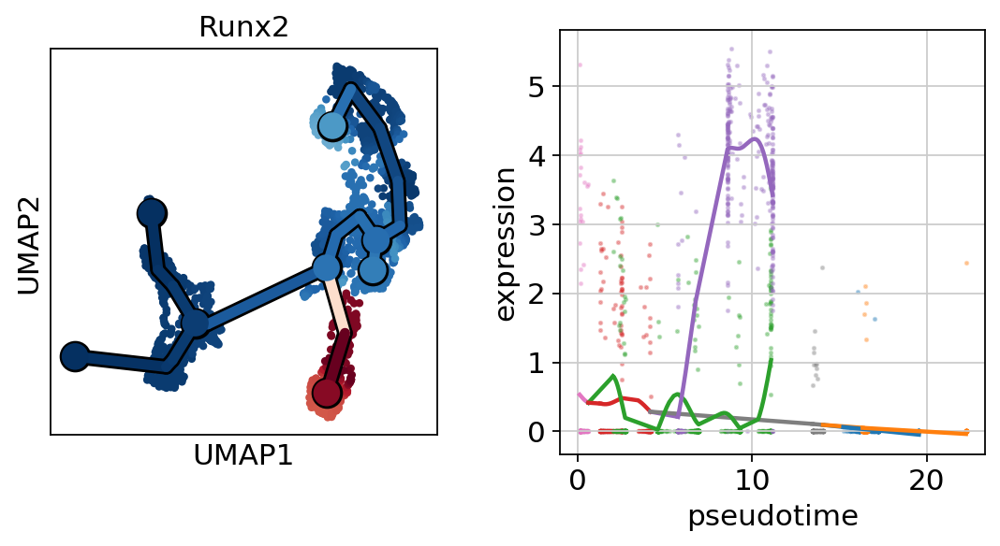

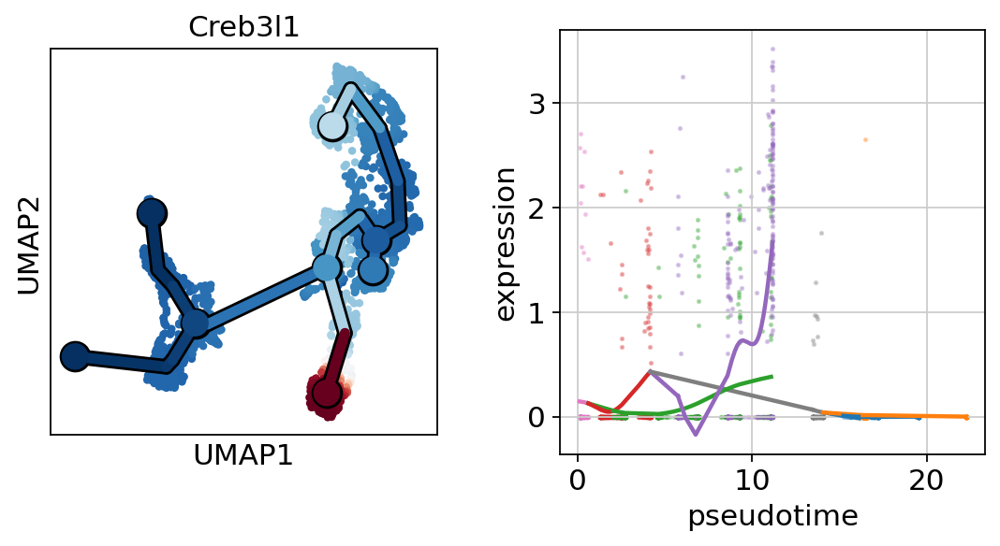

In [ ]:
# view with scf.pl.single_trend
for gene in tf_in_brownadipocyte:
    scf.pl.single_trend(ad_t, gene, basis='umap')
for gene in tf_in_chondrocytes:
    scf.pl.single_trend(ad_t, 'Foxp2', basis='umap')
for gene in tf_in_preosteoblasts:
    scf.pl.single_trend(ad_t, gene, basis='umap')


### **Let's look at specific branches**
#### sclerotome differentation towards fibroblasts or chondrocytes

In [ ]:
import warnings
warnings.filterwarnings('ignore')
scf.tl.test_fork(ad_t,root_milestone = 'sclerotome',milestones = ['chondrocytes','fibroblasts'])
scf.tl.branch_specific(ad_t,root_milestone = 'sclerotome',milestones = ['chondrocytes','fibroblasts'],effect = 0.5)


testing fork
    single mapping
    Differential expression: 100%|██████████| 1625/1625 [06:24<00:00,  4.22it/s]
    test for upregulation for each leave vs root
    upreg fibroblasts: 100%|██████████| 980/980 [00:14<00:00, 68.25it/s]
    finished (0:06:49) --> added 
    .uns['sclerotome->chondrocytes<>fibroblasts']['fork'], DataFrame with fork test results.
    branch specific features: fibroblasts: 17
    finished --> updated 
    .uns['sclerotome->chondrocytes<>fibroblasts']['fork'], DataFrame updated with additionnal 'branch' column.


Col3a1           fibroblasts
Col5a2           fibroblasts
Plcl1            fibroblasts
Spats2l          fibroblasts
Col6a3           fibroblasts
Col5a1           fibroblasts
Postn            fibroblasts
Ank2             fibroblasts
Col1a2           fibroblasts
9430076C15Rik    fibroblasts
Adam12           fibroblasts
Col12a1          fibroblasts
Plagl1           fibroblasts
Phactr2          fibroblasts
Col6a2           fibroblasts
Dlk1             fibroblasts
Ldlrad4          fibroblasts
Name: branch, dtype: object
['Col3a1', 'Col5a2', 'Plcl1', 'Spats2l', 'Col6a3', 'Col5a1', 'Postn', 'Ank2', 'Col1a2', '9430076C15Rik', 'Adam12', 'Col12a1', 'Plagl1', 'Phactr2', 'Col6a2', 'Dlk1', 'Ldlrad4']
[]
['Plagl1']
[]


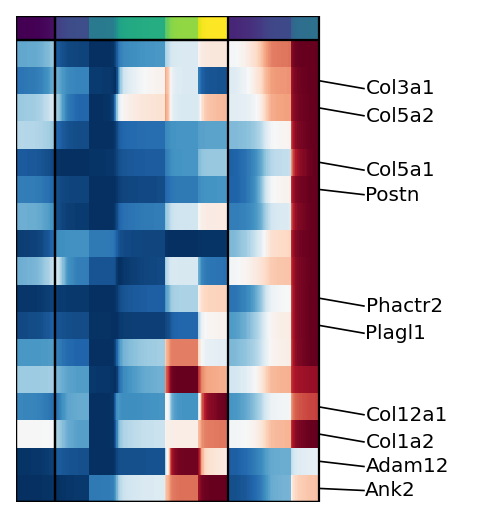

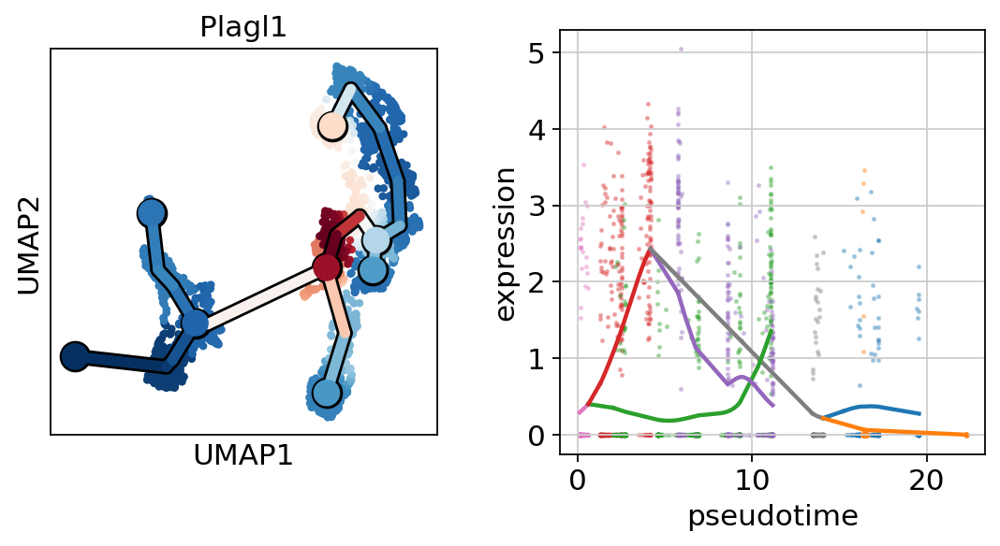

In [ ]:
# displaying results
# fibroblasts
g5 = scf.pl.trends(ad_t,
                root_milestone='sclerotome',
                 milestones=['chondrocytes','fibroblasts'],
                 branch="fibroblasts",
                 plot_emb=False,ordering="max",return_genes=True)
# extract genes of interests
branch_column_sclerotofibrochondro = ad_t.uns['sclerotome->chondrocytes<>fibroblasts']['fork']['branch']
print(branch_column_sclerotofibrochondro)
# separate genes that promote fibroblasts and chondrocytes fates separately
# For fibroblasts genes
fibroblasts_genes = branch_column_sclerotofibrochondro[branch_column_sclerotofibrochondro == "fibroblasts"].index.tolist()
# For Mesoderm genes
chondrocytes_genes = branch_column_sclerotofibrochondro[branch_column_sclerotofibrochondro == "chondrocytes"].index.tolist()
print(fibroblasts_genes)
print(chondrocytes_genes)
# extract TFs from genes
with open('/content/drive/MyDrive/allTFs_mm_aertslab_011924.txt', 'r') as file:
    mouse_tfs = [line.strip() for line in file]
mouse_tfs_set = set(mouse_tfs)
fibroblasts_genes_set = set(fibroblasts_genes)
chondrocytes_genes_set = set(chondrocytes_genes)
tf_in_fibroblasts = list(mouse_tfs_set.intersection(fibroblasts_genes_set))
tf_in_chondrocytes = list(mouse_tfs_set.intersection(chondrocytes_genes_set))
print(tf_in_fibroblasts)
print(tf_in_chondrocytes)
# view with scf.pl.single_trend
for gene in tf_in_fibroblasts:
    scf.pl.single_trend(ad_t, gene, basis='umap')

#### This step identified Plagl1 as an important TF that promote the fibrobast fate.

In [ ]:
scf.tl.activation_lm(ad_t,root_milestone="sclerotome",milestones=['chondrocytes','fibroblasts'],n_jobs=20)
scf.pl.modules(ad_t,root_milestone="sclerotome",milestones=['chondrocytes','fibroblasts'],
               smooth=True,module="early",save="_G.pdf")

In [ ]:
# create non-intersecting windoes of cells
scf.tl.slide_cells(ad_t,root_milestone="Root",milestones=['chondrocytes','fibroblasts'],win=400)
# obtain gene-geen correlation of both branch specific early modules
scf.tl.slide_cors(ad_t,root_milestone="Root",milestones=['chondrocytes','fibroblasts'])
# plotting results
sc.set_figure_params()
scf.pl.slide_cors(ad_t,root_milestone="Root",milestones=['chondrocytes','fibroblasts'],basis="draw_graph_fa",win_keep=[0,2,3,4,5],
                 focus=2,save="_H.pdf")

#### Fibroblasts to adipocyte progenitors / pre-osteoblasts decision

In [ ]:
import warnings
warnings.filterwarnings('ignore')
scf.tl.test_fork(ad_t, root_milestone = 'fibroblasts', milestones = ['adipocyte progenitors','pre-osteoblasts'],rescale=True)
scf.tl.branch_specific(ad_t,root_milestone = 'fibroblasts',milestones = ['adipocyte progenitors','pre-osteoblasts'],effect = 0.5)

testing fork
    single mapping
    Differential expression: 100%|██████████| 1625/1625 [04:03<00:00,  6.68it/s]
    test for upregulation for each leave vs root
    upreg pre-osteoblasts: 100%|██████████| 910/910 [00:13<00:00, 67.78it/s]
    finished (0:04:28) --> added 
    .uns['sclerotome->adipocyte progenitors<>pre-osteoblasts']['fork'], DataFrame with fork test results.
    branch specific features: adipocyte progenitors: 161, pre-osteoblasts: 101
    finished --> updated 
    .uns['sclerotome->adipocyte progenitors<>pre-osteoblasts']['fork'], DataFrame updated with additionnal 'branch' column.


In [ ]:
# displaying results
# fibroblasts
g5 = scf.pl.trends(ad_t,
                root_milestone='fibroblasts',
                 milestones=['adipocyte progenitors','pre-osteoblasts'],
                 branch="adipocyte progenitors",
                 plot_emb=False,ordering="max",return_genes=True)
g6 = scf.pl.trends(ad_t,
                root_milestone='fibroblasts',
                 milestones=['adipocyte progenitors','pre-osteoblasts'],
                 branch="pre-osteoblasts",
                 plot_emb=False,ordering="max",return_genes=True)

# extract genes of interests
branch_column_scleroto = ad_t.uns['fibroblast->chondrocytes<>fibroblasts']['fork']['branch']
print(branch_column_sclerotofibrochondro)
# separate genes that promote fibroblasts and chondrocytes fates separately
# For fibroblasts genes
fibroblasts_genes = branch_column_sclerotofibrochondro[branch_column_sclerotofibrochondro == "fibroblasts"].index.tolist()
# For Mesoderm genes
chondrocytes_genes = branch_column_sclerotofibrochondro[branch_column_sclerotofibrochondro == "chondrocytes"].index.tolist()
print(fibroblasts_genes)
print(chondrocytes_genes)
# extract TFs from genes
with open('/content/drive/MyDrive/allTFs_mm_aertslab_011924.txt', 'r') as file:
    mouse_tfs = [line.strip() for line in file]
mouse_tfs_set = set(mouse_tfs)
fibroblasts_genes_set = set(fibroblasts_genes)
chondrocytes_genes_set = set(chondrocytes_genes)
tf_in_fibroblasts = list(mouse_tfs_set.intersection(fibroblasts_genes_set))
tf_in_chondrocytes = list(mouse_tfs_set.intersection(chondrocytes_genes_set))
print(tf_in_fibroblasts)
print(tf_in_chondrocytes)
# view with scf.pl.single_trend
for gene in tf_in_fibroblasts:
    scf.pl.single_trend(ad_t, gene, basis='umap')

In [ ]:
# dynamic TFs identification
samp_tab = ad_t.obs
exp_tab = ad_t.raw.to_adata().to_df()
exp_tab = exp_tab.T

trajectory_dict = dict()
trajectory_dict['T1'] = ['Epiblast','Mesoderm']
trajectory_dict['T2'] = ['Epiblast','Anterior primitive streak']

cluster_col = 'cell_type'
pt_col = 't'

my_df = onesc.suggest_dynamic_genes(exp_tab.loc[exp_tab.index.isin(mouse_tfs), :].copy(), samp_tab, trajectory_dict, cluster_col, pt_col, adj_p_cutoff = 0.05, log2_change_cutoff = 3, min_exp_cutoff = 0.4)
interesting_TFs = np.unique(my_df.index)
print(interesting_TFs)

### **GRN analysis**

In [ ]:
adTrain_rank, adHeldOut_rank = pySCN.splitCommonAnnData(ad_t, ncells=150,dLevel="celltype_update")
clf = pySCN.train_rank_classifier(adTrain_rank, dLevel="celltype_update")
# Check training and held-out data sizes
print("Training data:", adTrain_rank.shape)
print("Held-out data:", adHeldOut_rank.shape)
# Confirm that all groups are equally represented
print(adTrain_rank.obs['celltype_update'].value_counts())
# Check if the 'cell_type' column exists and has consistent values
print(adTrain_rank.obs['celltype_update'].unique())
print(adHeldOut_rank.obs['celltype_update'].unique())

Fibroblasts : 
391
Pre-osteoblasts (Sp7+) : 
287
Adipocyte cells (Cyp2e1+) : 
193
Brown adipocyte cells : 
194
Chondrocytes (Atp1a2+) : 
395
Sclerotome : 
362
Adipocyte progenitor cells : 
198
Training data: (1050, 1625)
Held-out data: (970, 1625)
Adipocyte cells (Cyp2e1+)     150
Adipocyte progenitor cells    150
Brown adipocyte cells         150
Chondrocytes (Atp1a2+)        150
Fibroblasts                   150
Pre-osteoblasts (Sp7+)        150
Sclerotome                    150
Name: celltype_update, dtype: int64
['Sclerotome', 'Chondrocytes (Atp1a2+)', 'Fibroblasts', 'Pre-osteoblasts (Sp7+)', 'Adipocyte progenitor cells', 'Adipocyte cells (Cyp2e1+)', 'Brown adipocyte cells']
Categories (7, object): ['Adipocyte cells (Cyp2e1+)', 'Adipocyte progenitor cells', 'Brown adipocyte cells',
                         'Chondrocytes (Atp1a2+)', 'Fibroblasts', 'Pre-osteoblasts (Sp7+)', 'Sclerotome']
['Sclerotome', 'Chondrocytes (Atp1a2+)', 'Fibroblasts', 'Pre-osteoblasts (Sp7+)', 'Adipocyte prog

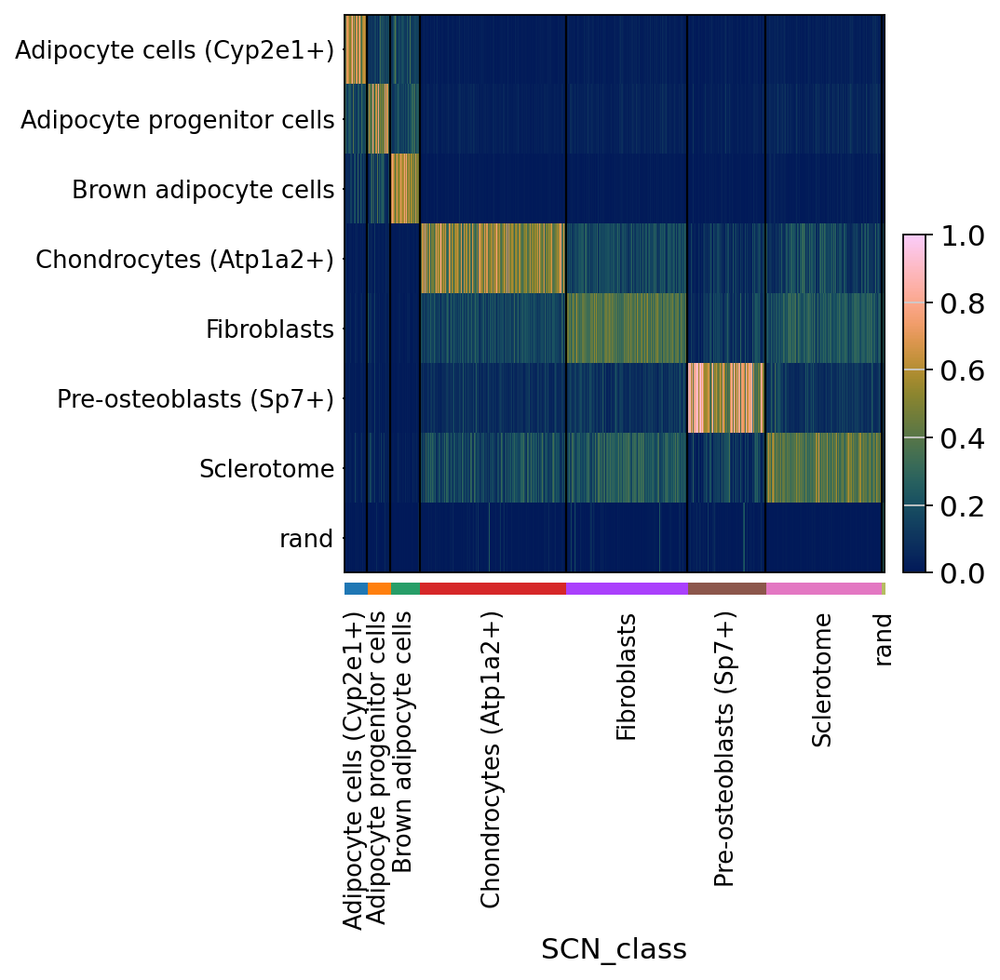

In [ ]:
# Classify the held out data:
pySCN.rank_classify(adHeldOut_rank, clf)
pySCN.heatmap_scores(adHeldOut_rank, groupby='SCN_class')

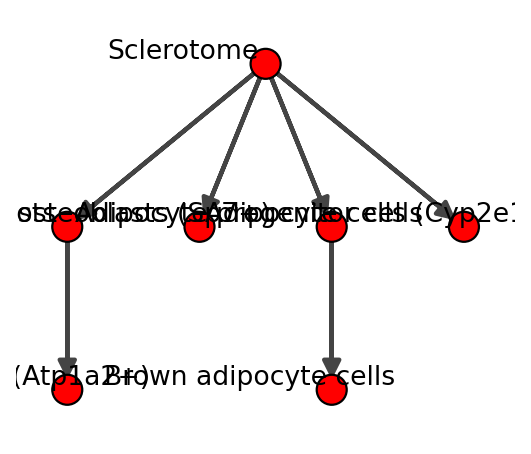

In [ ]:
import networkx as nx
import seaborn as sns
import matplotlib.pyplot as plt
import scipy as sp
import pySingleCellNet as pySCN
from joblib import dump, load
import sys
import igraph as ig
from igraph import Graph
ig.config['plotting.backend'] = 'matplotlib'
# GRN Inference
# Set cell states
initial_clusters = ['Sclerotome']
end_clusters = ['Adipocyte cells (Cyp2e1+)','Brown adipocyte cells','Chondrocytes (Atp1a2+)','Pre-osteoblasts (Sp7+)']
# Automatic infer the directed state graph
state_path = onesc.construct_cluster_graph_adata(ad_t, initial_clusters = initial_clusters, terminal_clusters = end_clusters, cluster_col = "celltype_update", pseudo_col = "t")
onesc.plot_state_graph(state_path)

The automatic inference is wrong,so here we manually set the cel states tree.

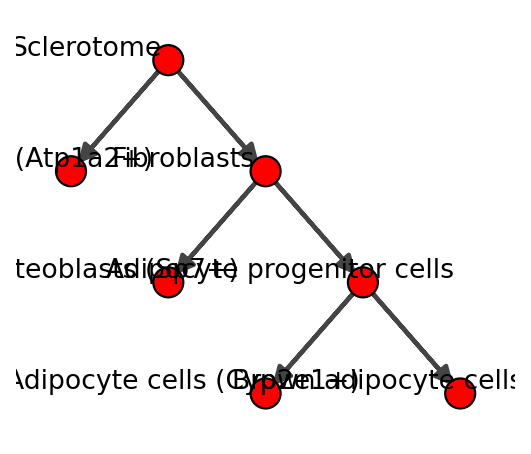

In [ ]:
edge_list = [('Sclerotome','Fibroblasts'), ('Sclerotome','Chondrocytes (Atp1a2+)'),('Fibroblasts','Pre-osteoblasts (Sp7+)'),('Fibroblasts','Adipocyte progenitor cells'),('Adipocyte progenitor cells','Adipocyte cells (Cyp2e1+)'),('Adipocyte progenitor cells','Brown adipocyte cells')]
H = nx.DiGraph(edge_list)
onesc.plot_state_graph(H)


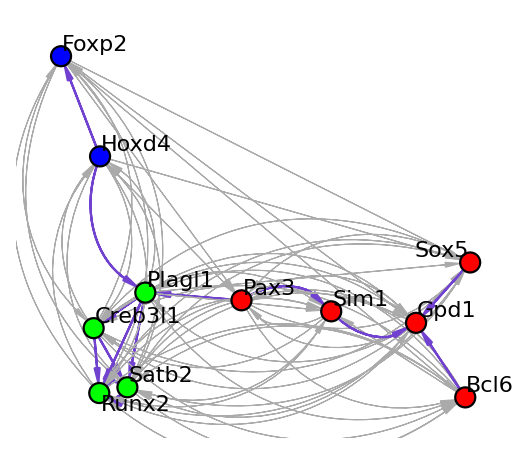

In [ ]:
# Infer the GRN with TFs previously identified
selected_TFs = ['Ebf2', 'Pax3', 'Sim1', 'Hoxd4','Runx2', 'Satb2','Bcl6', 'Gpd1', 'Sox5','Foxp2', 'Creb3l1','Plagl1' ]
# filtering data to contain only the TFs of interests
filtered_ad_t = ad_t[:, ad_t.var_names.isin(selected_TFs)]
start_end_states = {'start': ['Sclerotome'], 'end':['Adipocyte cells (Cyp2e1+)','Brown adipocyte cells','Chondrocytes (Atp1a2+)','Pre-osteoblasts (Sp7+)']}
iGRN = onesc.infer_grn(H, start_end_states, filtered_ad_t, num_generations = 20, sol_per_pop = 30, reduce_auto_reg=True, ideal_edges = 0, GA_seed_list = [1, 3], init_pop_seed_list = [21, 25], cluster_col='celltype_update', pseudoTime_col='t', n_cores=4)
grn_ig = onesc.dataframe_to_igraph(iGRN)
plt.rcParams.update({'font.size': 10})
onesc.plot_grn(grn_ig, layout_method='fr',community_first=True)

#### Gpd1 apparently is an important target for promoting brown adipocyte cell fate, while Runx2 and Satb2 should be inhibited to skew more cells into brown adipocytes fate.

In [ ]:
adsclerotome = ad_t[ad_t.obs['celltype_update'] == 'Sclerotome'].copy()
xstates = onesc.define_states_adata(adsclerotome, min_mean = 0.05, min_percent_cells = 0.20) * 2

In [ ]:
# construct the OneSC simulator object:
netname = 'brownadipoctesdiff'
netsim = onesc.network_structure()
netsim.fit_grn(iGRN)
sim = onesc.OneSC_simulator()
sim.add_network_compilation(netname, netsim)

In [ ]:
# wild-type simulation
simlist_wt = onesc.simulate_parallel_adata(sim, xstates, netname, n_cores = 4, num_sim = 1000, t_interval = 0.01, noise_amp = 0.1)

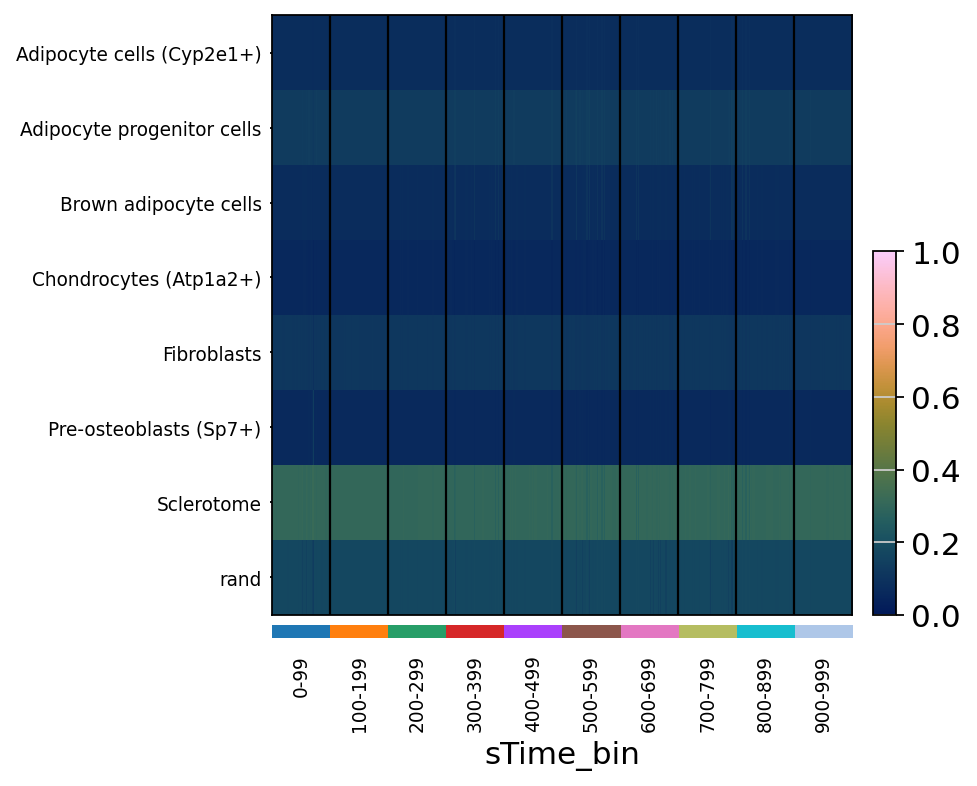

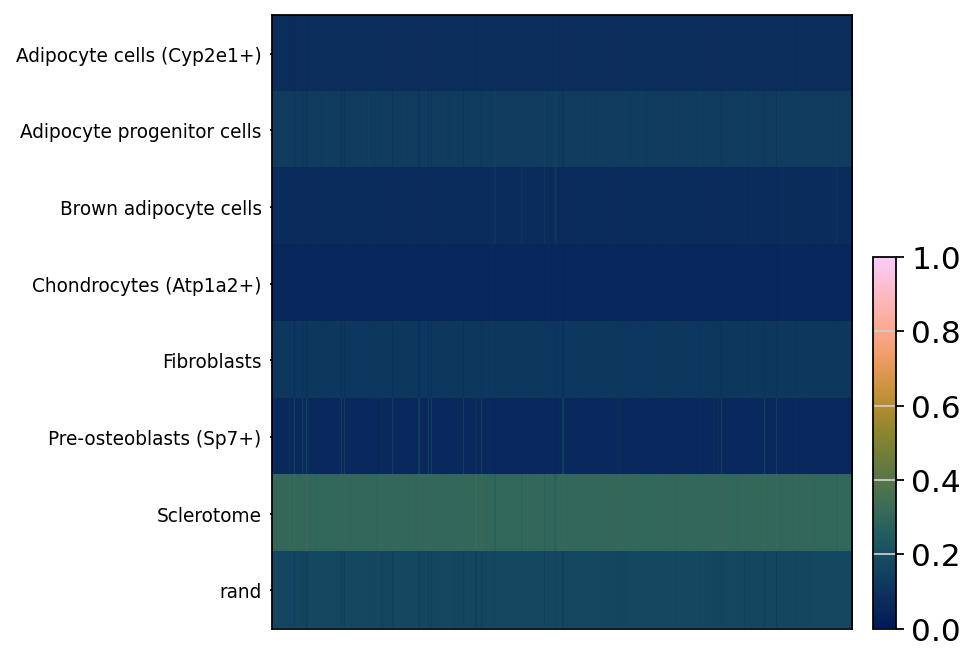

In [ ]:
ad_sim1 = simlist_wt[0].copy()
pySCN.rank_classify(ad_sim1, clf)

# a hack because sc.pl.heatmap requires a 'groupby', so groupby simulation time bin
tmp_obs = ad_sim1.obs.copy()
bins = np.linspace(-1, 999, 11)
labels = [f"{int(bins[i]) + 1}-{int(bins[i+1])}" for i in range(len(bins)-1)]

tmp_obs['sTime_bin'] = pd.cut(tmp_obs['sim_time'], bins=bins, labels=labels)
ad_sim1.obs = tmp_obs
pySCN.heatmap_scores(ad_sim1, groupby = 'sTime_bin')
# specific look into the final stage
ad_wt = onesc.sample_and_compile_anndatas(simlist_wt, X=100, time_bin=(80, 100), sequential_order_column='sim_time')
pySCN.rank_classify(ad_wt, clf)
pySCN.heatmap_scores(ad_wt, groupby = 'SCN_class')

#### Now let's test for perturbations

#### overexpress of Gpd1

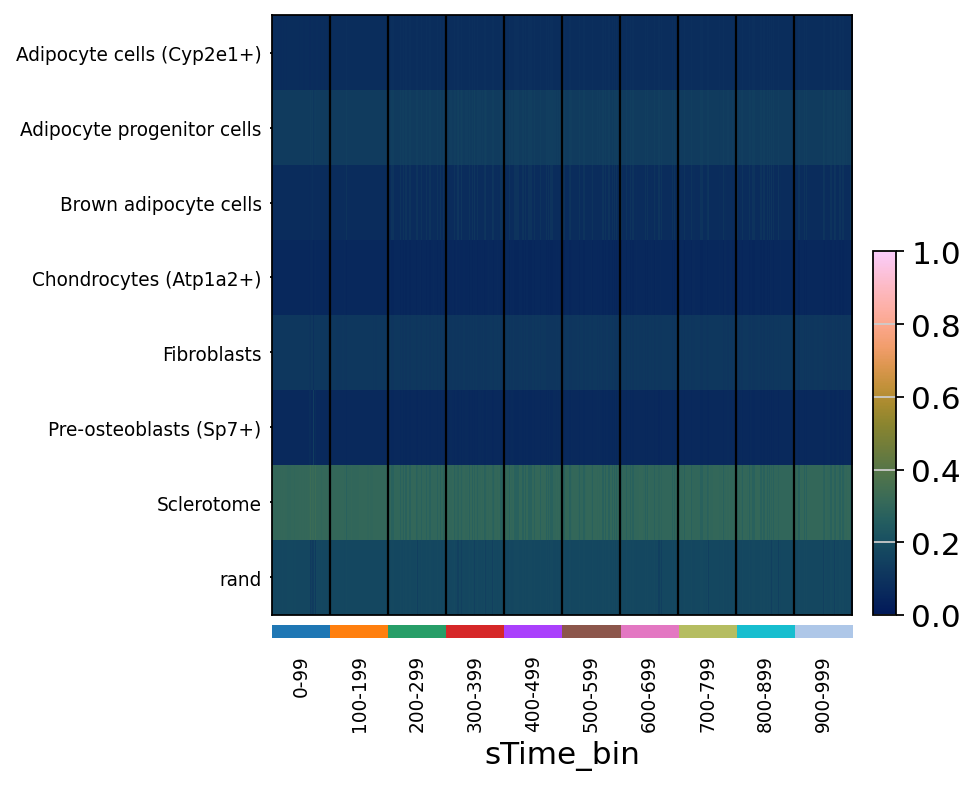

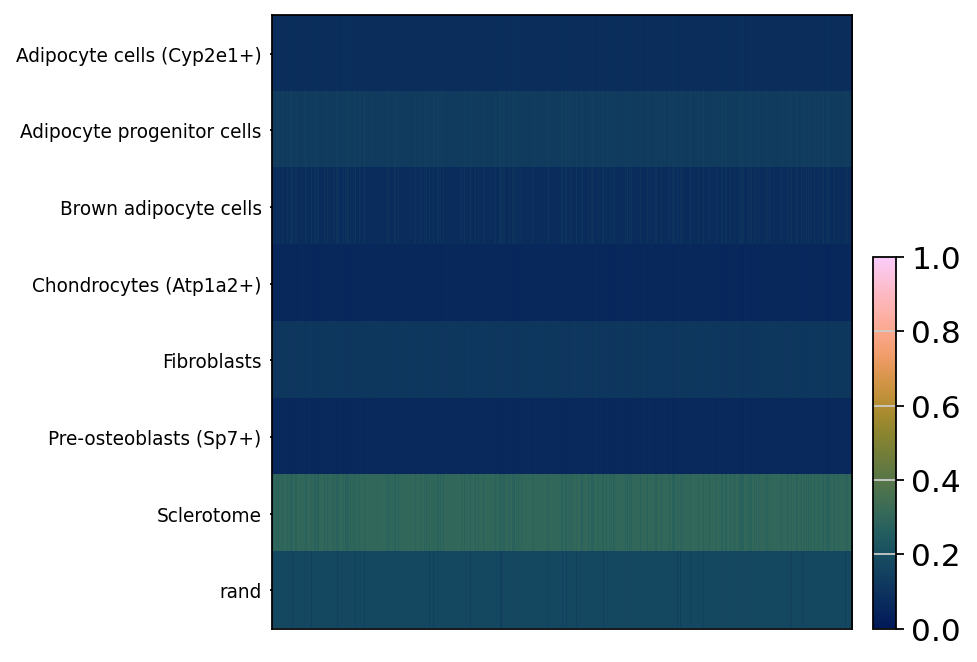

In [ ]:
 #make pertub_dict for Gpd1
perturb_ov_Gpd1 = dict()
perturb_ov_Gpd1['Gpd1'] = 2
simlist_ov_Gpd1 = onesc.simulate_parallel_adata(sim, xstates, 'brownadipoctesdiff', perturb_dict = perturb_ov_Gpd1, n_cores = 4, num_sim = 1000, t_interval = 0.1, noise_amp = 0.5)
# a hack because sc.pl.heatmap requires a 'groupby', so groupby simulation time bin
ad_ov_Gpd1 = simlist_ov_Gpd1[0].copy()
pySCN.rank_classify(ad_ov_Gpd1, clf)
bins = np.linspace(-1, 999, 11)
labels = [f"{int(bins[i]) + 1}-{int(bins[i+1])}" for i in range(len(bins)-1)]
ad_ov_Gpd1.obs['sTime_bin'] = pd.cut(ad_ov_Gpd1.obs['sim_time'], bins=bins, labels=labels)
pySCN.heatmap_scores(ad_ov_Gpd1, groupby='sTime_bin')
# visualization at the later stage
ad_ov_Gpd1 = onesc.sample_and_compile_anndatas(simlist_ov_Gpd1, X=100, time_bin=(80, 100), sequential_order_column='sim_time')
pySCN.rank_classify(ad_ov_Gpd1, clf)
pySCN.heatmap_scores(ad_ov_Gpd1, groupby = 'SCN_class')

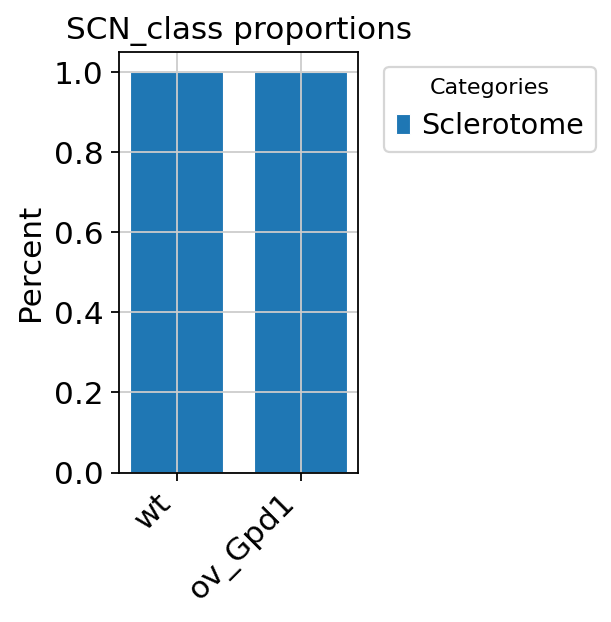

In [ ]:
# Visualize the proportion difference
pySCN.plot_cell_type_proportions([ad_wt,ad_ov_Gpd1], obs_column = "SCN_class", labels=["wt", "ov_Gpd1"])


#### Knockout Runx2

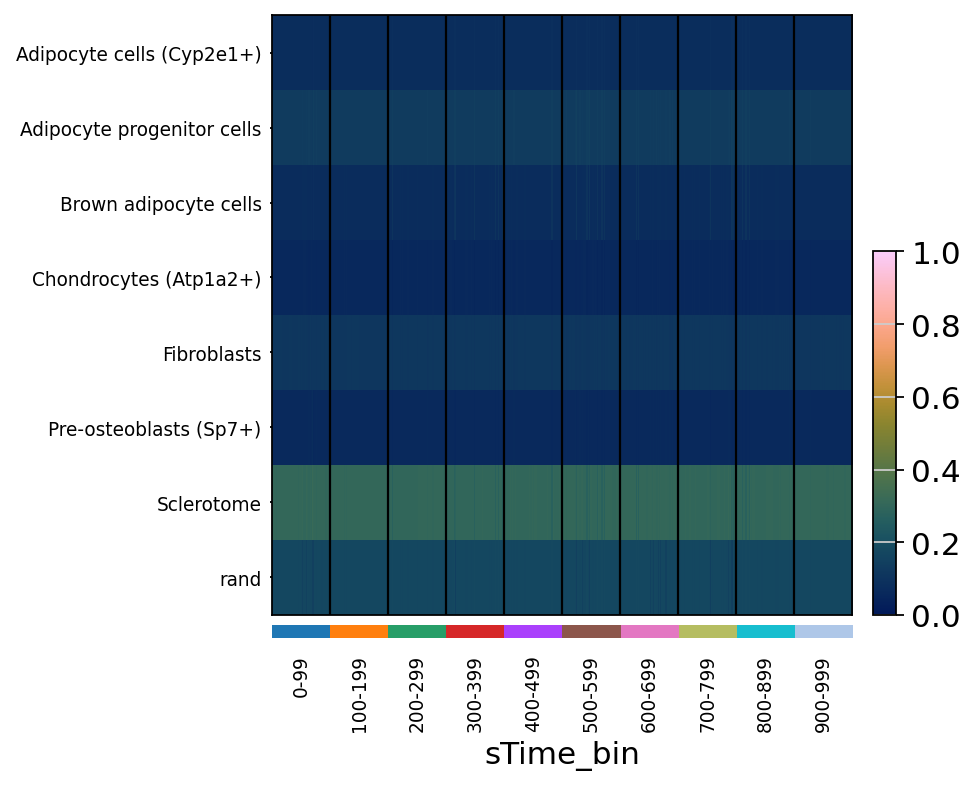

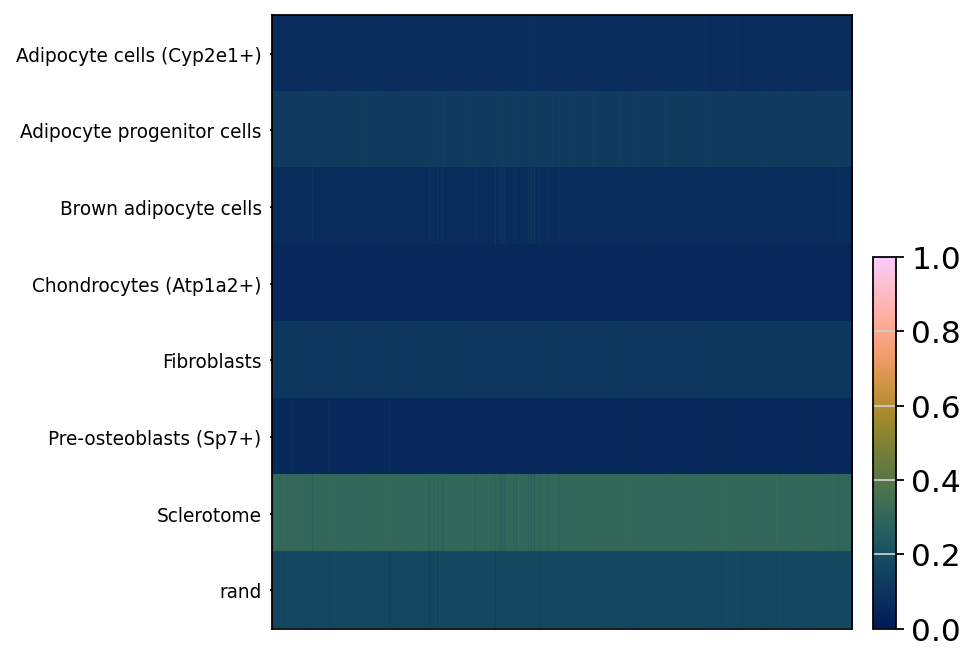

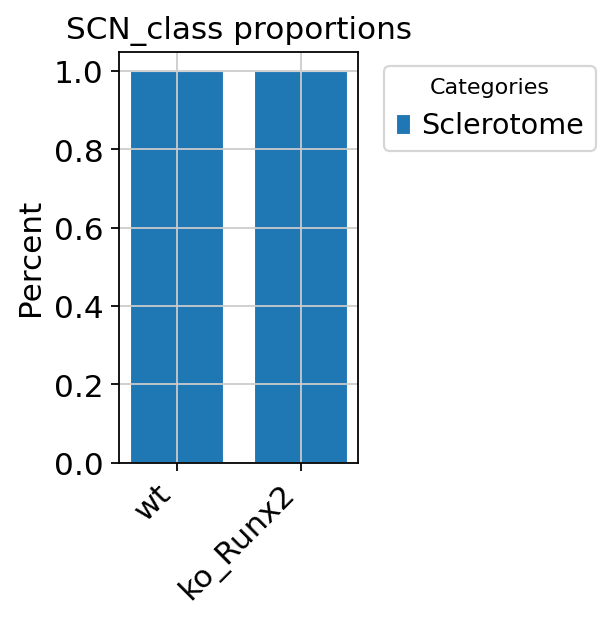

In [ ]:
 #make pertub_dict for Runx2
perturb_ko_Runx2 = dict()
perturb_ko_Runx2['Runx2'] = -2
simlist_ko_Runx2 = onesc.simulate_parallel_adata(sim, xstates, 'brownadipoctesdiff', perturb_dict = perturb_ko_Runx2, n_cores = 4, num_sim = 1000, t_interval = 0.1, noise_amp = 0.5)
# a hack because sc.pl.heatmap requires a 'groupby', so groupby simulation time bin
ad_ko_Runx2 = simlist_ko_Runx2[0].copy()
pySCN.rank_classify(ad_ko_Runx2, clf)
bins = np.linspace(-1, 999, 11)
labels = [f"{int(bins[i]) + 1}-{int(bins[i+1])}" for i in range(len(bins)-1)]
ad_ko_Runx2.obs['sTime_bin'] = pd.cut(ad_ko_Runx2.obs['sim_time'], bins=bins, labels=labels)
pySCN.heatmap_scores(ad_ko_Runx2, groupby='sTime_bin')
# visualization at the later stage
ad_ko_Runx2 = onesc.sample_and_compile_anndatas(simlist_ko_Runx2, X=100, time_bin=(80, 100), sequential_order_column='sim_time')
pySCN.rank_classify(ad_ko_Runx2, clf)
pySCN.heatmap_scores(ad_ko_Runx2, groupby = 'SCN_class')
# Visualize the proportion difference
pySCN.plot_cell_type_proportions([ad_wt,ad_ko_Runx2], obs_column = "SCN_class", labels=["wt", "ko_Runx2"])

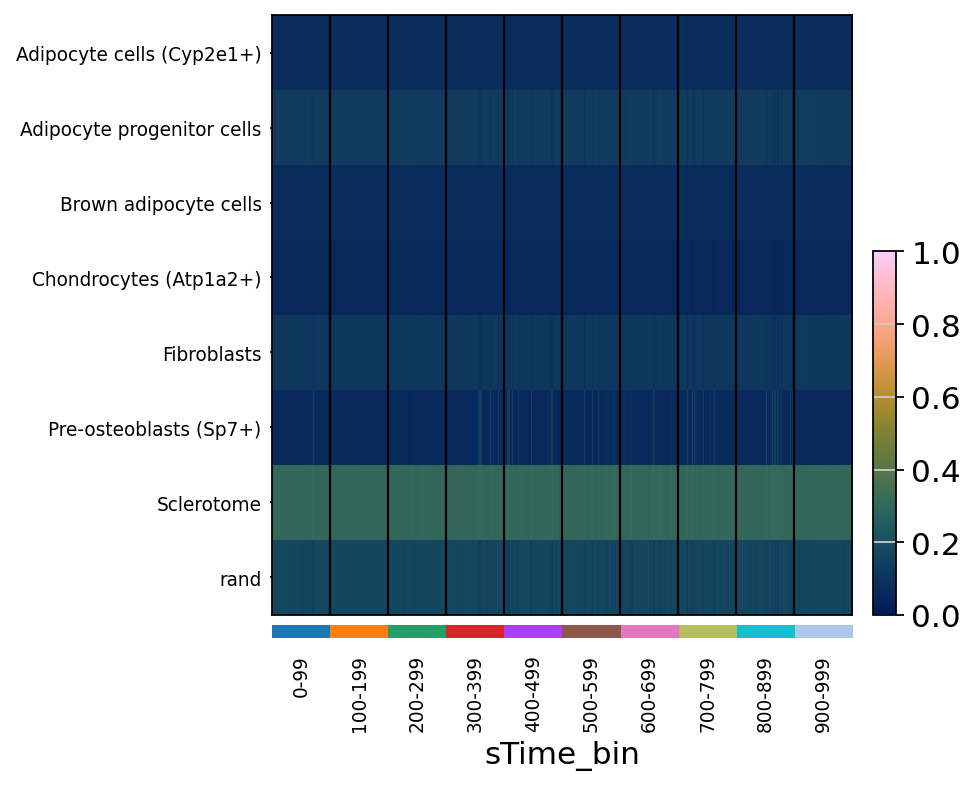

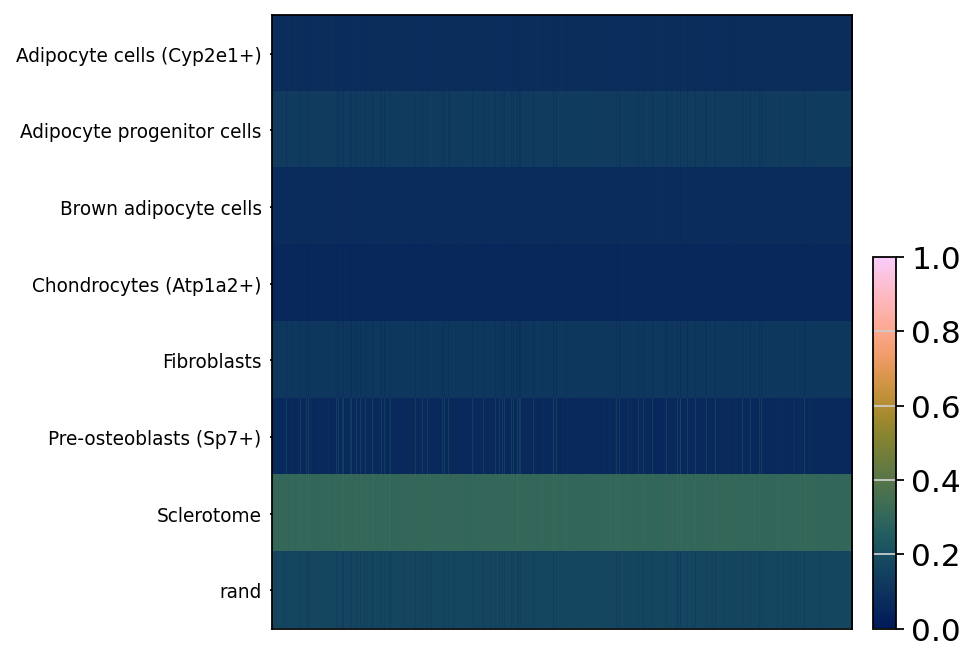

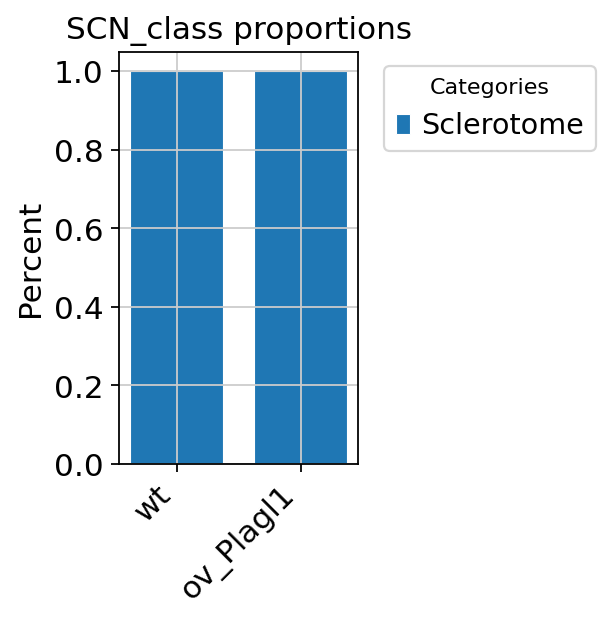

In [ ]:
 #make pertub_dict for Plagl1
perturb_ov_Plagl1 = dict()
perturb_ov_Plagl1['Plagl1'] = 2
simlist_ov_Plagl1 = onesc.simulate_parallel_adata(sim, xstates, 'brownadipoctesdiff', perturb_dict = perturb_ov_Plagl1, n_cores = 4, num_sim = 1000, t_interval = 0.1, noise_amp = 0.5)
# a hack because sc.pl.heatmap requires a 'groupby', so groupby simulation time bin
ad_ov_Plagl1 = simlist_ov_Plagl1[0].copy()
pySCN.rank_classify(ad_ov_Plagl1, clf)
bins = np.linspace(-1, 999, 11)
labels = [f"{int(bins[i]) + 1}-{int(bins[i+1])}" for i in range(len(bins)-1)]
ad_ov_Plagl1.obs['sTime_bin'] = pd.cut(ad_ov_Plagl1.obs['sim_time'], bins=bins, labels=labels)
pySCN.heatmap_scores(ad_ov_Plagl1, groupby='sTime_bin')
# visualization at the later stage
ad_ov_Plagl1 = onesc.sample_and_compile_anndatas(simlist_ov_Plagl1, X=100, time_bin=(80, 100), sequential_order_column='sim_time')
pySCN.rank_classify(ad_ov_Plagl1, clf)
pySCN.heatmap_scores(ad_ov_Plagl1, groupby = 'SCN_class')
# Visualize the proportion difference
pySCN.plot_cell_type_proportions([ad_wt,ad_ov_Plagl1], obs_column = "SCN_class", labels=["wt", "ov_Plagl1"])

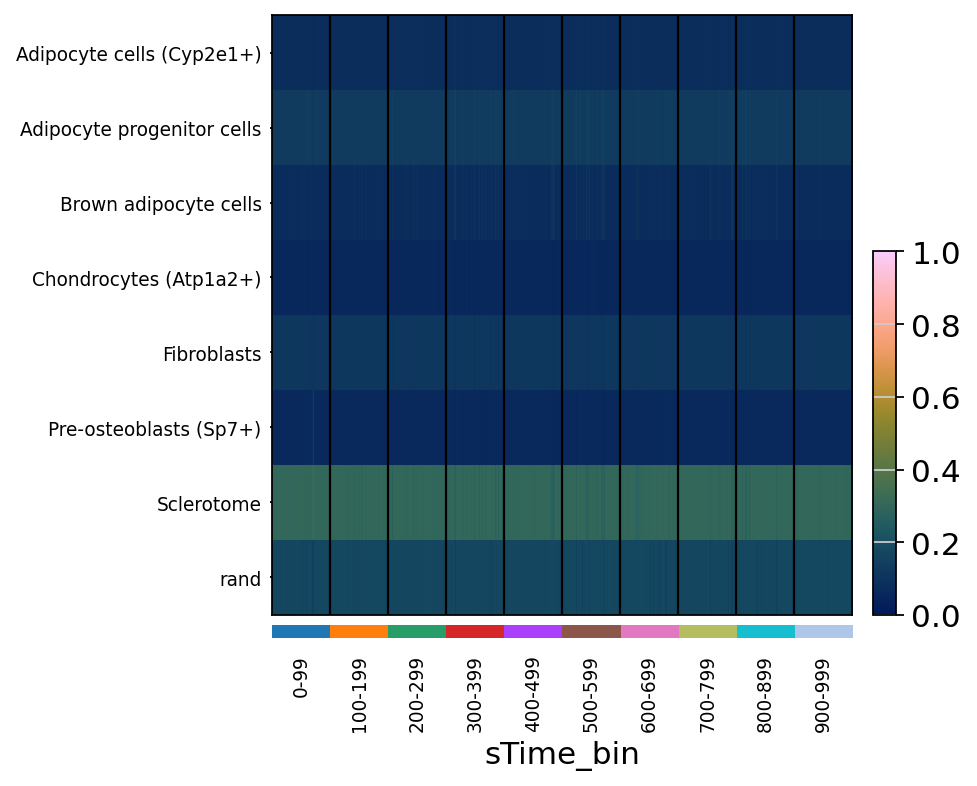

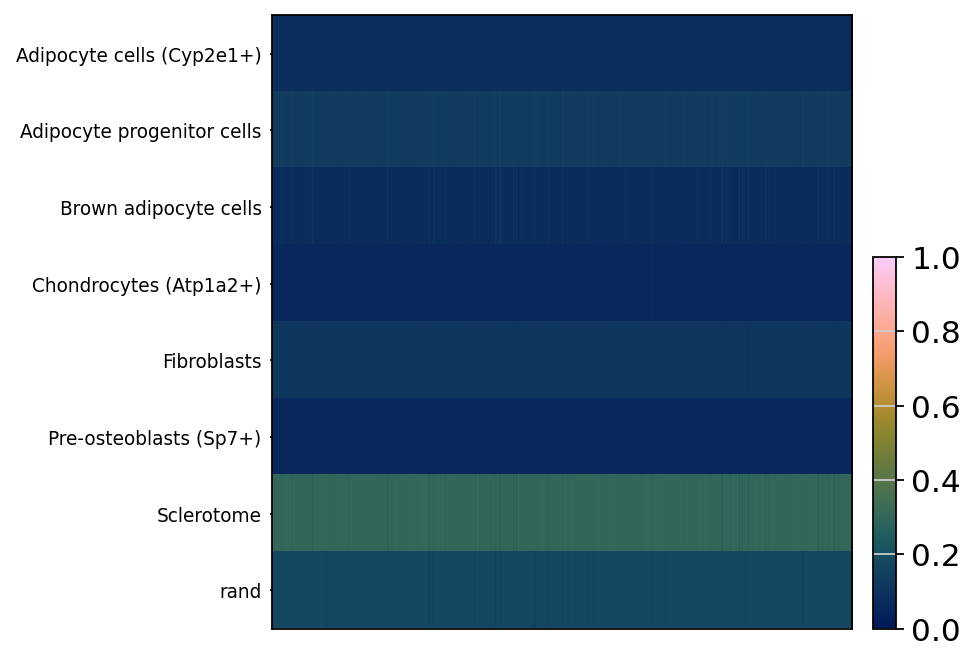

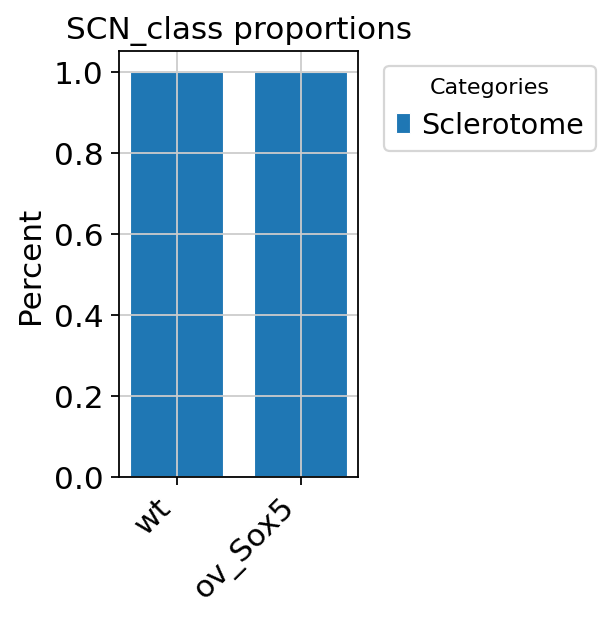

In [ ]:
 #make pertub_dict for Sox5
perturb_ov_Sox5 = dict()
perturb_ov_Sox5['Sox5'] = 2
simlist_ov_Sox5 = onesc.simulate_parallel_adata(sim, xstates, 'brownadipoctesdiff', perturb_dict = perturb_ov_Sox5, n_cores = 4, num_sim = 1000, t_interval = 0.1, noise_amp = 0.5)
# a hack because sc.pl.heatmap requires a 'groupby', so groupby simulation time bin
ad_ov_Sox5 = simlist_ov_Sox5[0].copy()
pySCN.rank_classify(ad_ov_Sox5, clf)
bins = np.linspace(-1, 999, 11)
labels = [f"{int(bins[i]) + 1}-{int(bins[i+1])}" for i in range(len(bins)-1)]
ad_ov_Sox5.obs['sTime_bin'] = pd.cut(ad_ov_Sox5.obs['sim_time'], bins=bins, labels=labels)
pySCN.heatmap_scores(ad_ov_Sox5, groupby='sTime_bin')
# visualization at the later stage
ad_ov_Sox5 = onesc.sample_and_compile_anndatas(simlist_ov_Sox5, X=100, time_bin=(80, 100), sequential_order_column='sim_time')
pySCN.rank_classify(ad_ov_Sox5, clf)
pySCN.heatmap_scores(ad_ov_Sox5, groupby = 'SCN_class')
# Visualize the proportion difference
pySCN.plot_cell_type_proportions([ad_wt,ad_ov_Sox5], obs_column = "SCN_class", labels=["wt", "ov_Sox5"])

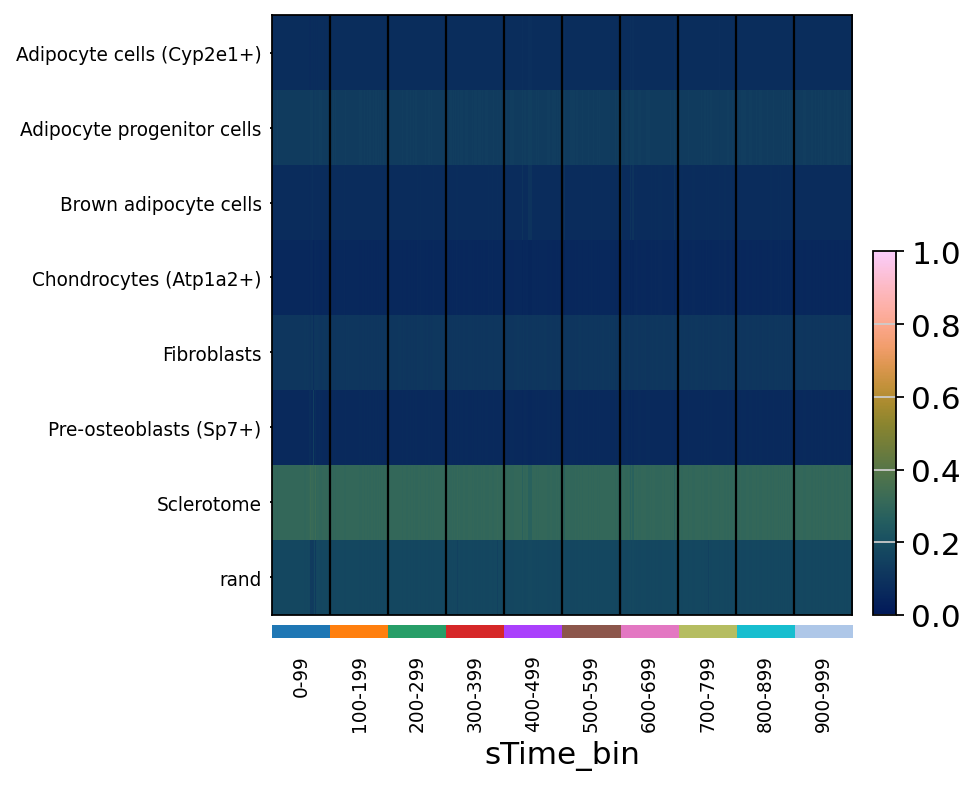

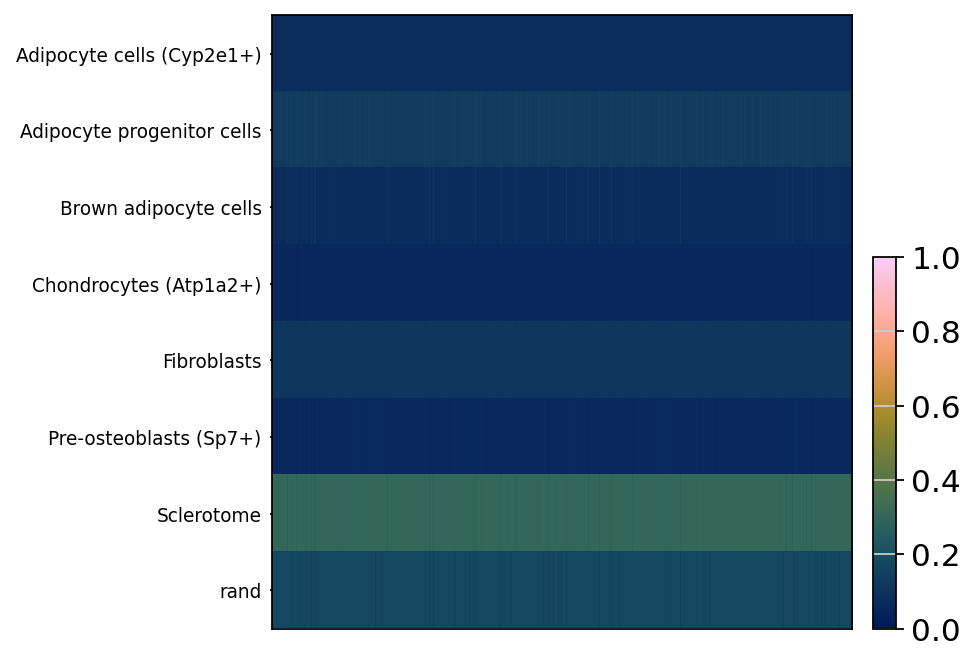

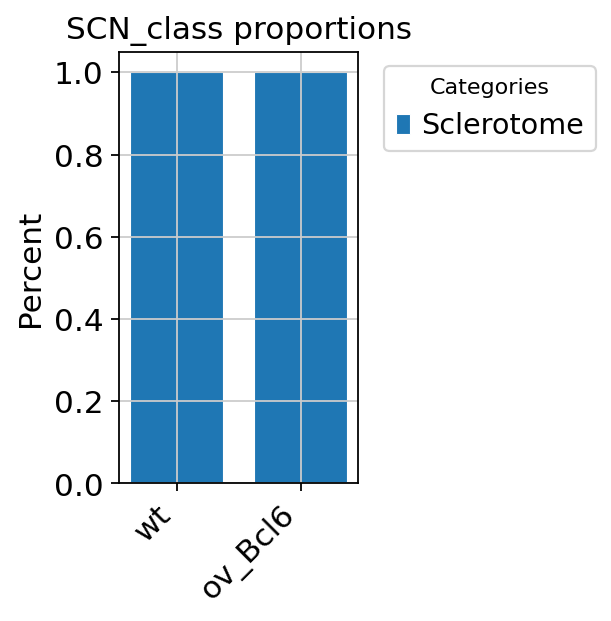

In [ ]:
 #make pertub_dict for Bcl6
perturb_ov_Bcl6 = dict()
perturb_ov_Bcl6['Bcl6'] = 2
simlist_ov_Bcl6 = onesc.simulate_parallel_adata(sim, xstates, 'brownadipoctesdiff', perturb_dict = perturb_ov_Bcl6, n_cores = 4, num_sim = 1000, t_interval = 0.1, noise_amp = 0.5)
# a hack because sc.pl.heatmap requires a 'groupby', so groupby simulation time bin
ad_ov_Bcl6 = simlist_ov_Bcl6[0].copy()
pySCN.rank_classify(ad_ov_Bcl6, clf)
bins = np.linspace(-1, 999, 11)
labels = [f"{int(bins[i]) + 1}-{int(bins[i+1])}" for i in range(len(bins)-1)]
ad_ov_Bcl6.obs['sTime_bin'] = pd.cut(ad_ov_Bcl6.obs['sim_time'], bins=bins, labels=labels)
pySCN.heatmap_scores(ad_ov_Bcl6, groupby='sTime_bin')
# visualization at the later stage
ad_ov_Bcl6 = onesc.sample_and_compile_anndatas(simlist_ov_Bcl6, X=100, time_bin=(80, 100), sequential_order_column='sim_time')
pySCN.rank_classify(ad_ov_Bcl6, clf)
pySCN.heatmap_scores(ad_ov_Bcl6, groupby = 'SCN_class')
# Visualize the proportion difference
pySCN.plot_cell_type_proportions([ad_wt,ad_ov_Bcl6], obs_column = "SCN_class", labels=["wt", "ov_Bcl6"])

## Maturation
### To explore how to push the cell type maturation of the induced brown adipocyte, here we try to subset out the brown adipocyte, which is the target cell type based on cell type annotation provided. DEG and trajectory inference, GRN and oneSC simulation similar to the previous piple will be performed to identify key TFs associated wiht maturation.

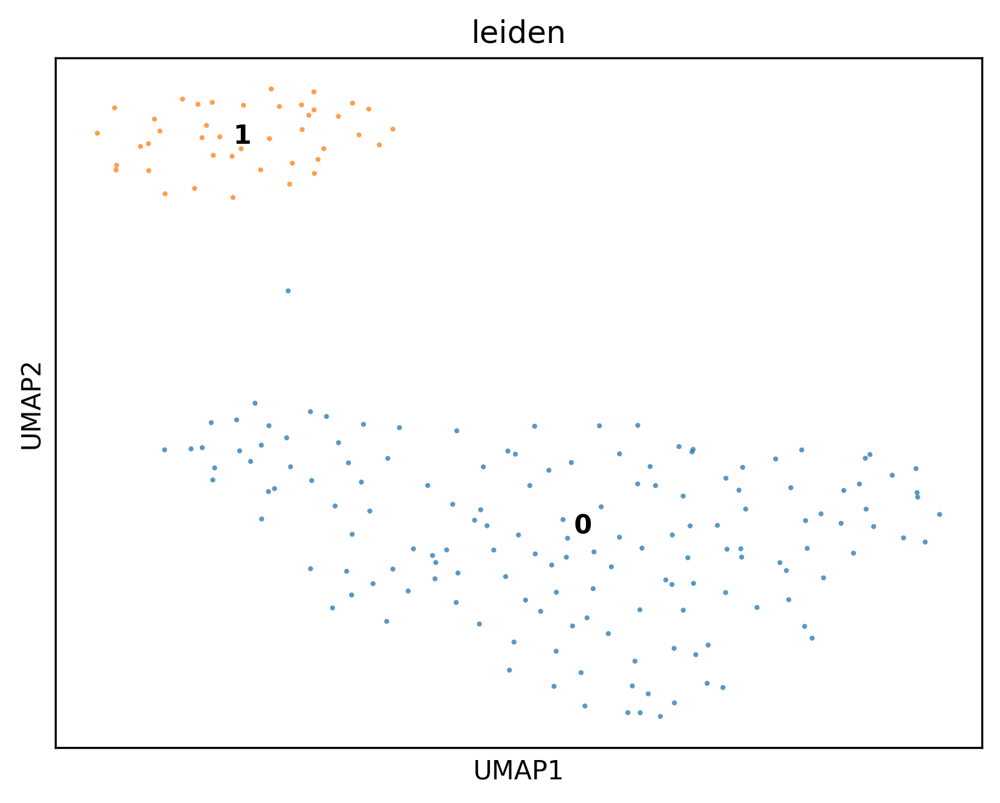

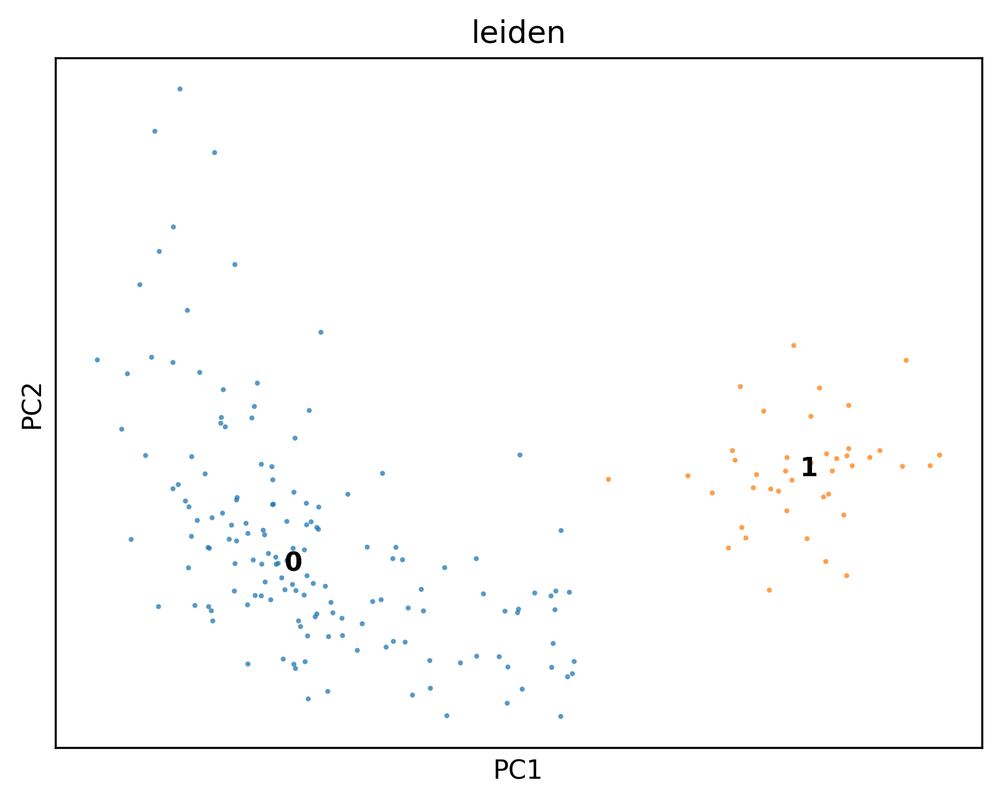

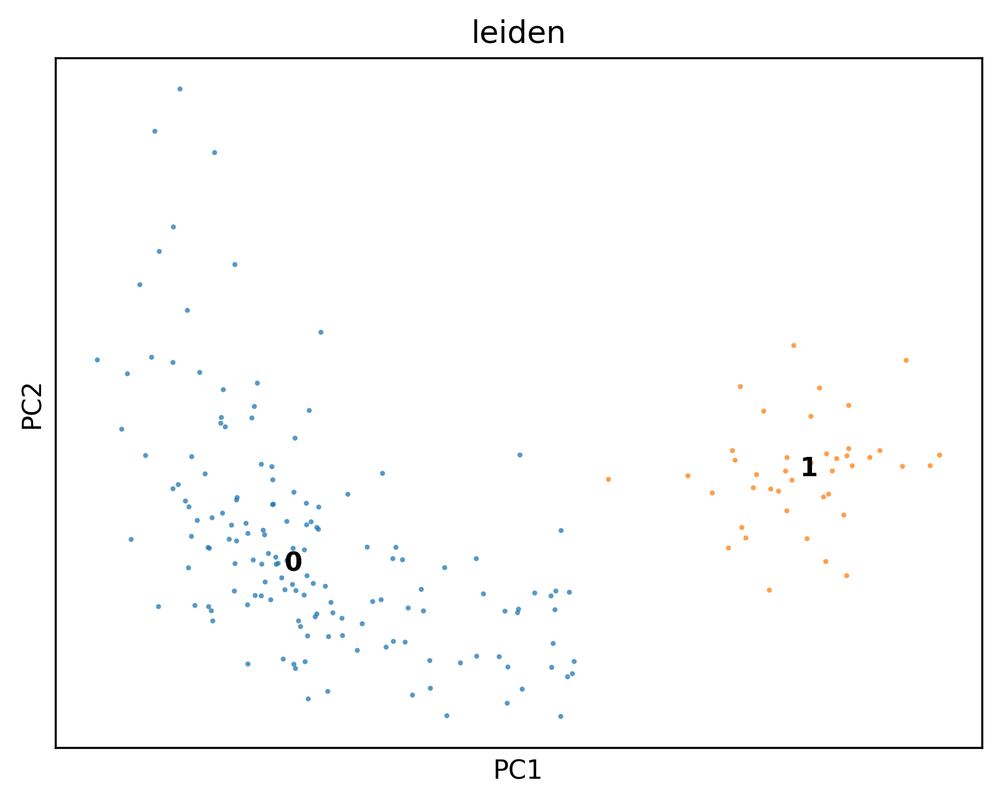

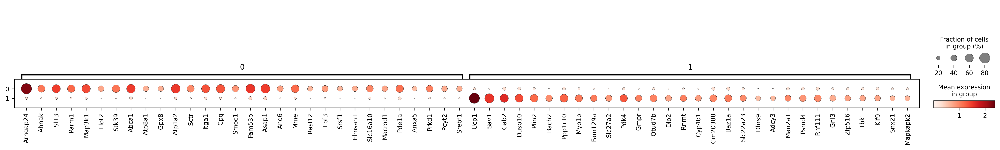

['Ebf3', 'Srebf1', 'Meis2', 'Bbx', 'Pkm', 'Meis1', 'Mecom', 'Pbx1', 'Canx', 'Rfx3', 'Thra', 'Banp', 'Nrf1', 'Zfp438', 'Ywhae', 'Gmeb1', 'Prdm10', 'Smad2']
['Bach2', 'Ppp1r10', 'Zfp516', 'Klf9', 'Ahctf1', 'Stat3', 'Trim33', 'Zfp655', 'Zfp131', 'Crem']


In [ ]:
# SUBSET OUT BROWN ADIPOCYTES
selected_maturation = ['Brown adipocyte cells']
adNorm_maturation = adNorm_Mesoderm[adNorm_Mesoderm.obs['celltype_update'].isin(selected_maturation),:].copy()
# redo HVG,PCA, umap
sc.pp.highly_variable_genes(adNorm_maturation, min_mean=0.05, max_mean=6, min_disp=0.25)
sc.tl.pca(adNorm_maturation, use_highly_variable=True)
n_neighbors = 15
n_pcs = 30
sc.pp.neighbors(adNorm_maturation, n_neighbors=n_neighbors, n_pcs=n_pcs)
sc.tl.leiden(adNorm_maturation,.1)
sc.tl.paga(adNorm_maturation)
sc.pl.paga(adNorm_maturation, plot=False)
sc.tl.umap(adNorm_maturation, 0.25, init_pos='paga')
sc.pl.umap(adNorm_maturation,color=['leiden'], alpha=.75, s=15, legend_loc='on data')
sc.pl.pca(adNorm_maturation,color=['leiden'], alpha=.75, s=15, legend_loc='on data')
sc.pl.pca(adNorm_maturation,color=['leiden'], alpha=.75, s=15, legend_loc='on data')
# PERFORM DEG
sc.tl.rank_genes_groups(adNorm_maturation, use_raw=False, groupby="leiden")
sc.tl.filter_rank_genes_groups(adNorm_maturation, min_fold_change=.3, min_in_group_fraction=.3, max_out_group_fraction=.2)
sc.pl.rank_genes_groups_dotplot(adNorm_maturation, n_genes=30, groupby="leiden", dendrogram=True, key='rank_genes_groups_filtered')
# extract TFs from DEG results
cluster0 = adNorm_maturation.uns['rank_genes_groups_filtered']
groups0 = cluster0['names'].dtype.names
deg_data0 = {group: cluster0['names'][group] for group in groups0}
deg_df0 = pd.DataFrame(deg_data0)
# Filter out genes specific to 'cluster0'
cluster0_genes = deg_df0['0'].dropna().unique()
# Filter out genes specific to 'Dermomyotome'
cluster1_genes = deg_df0['1'].dropna().unique()
# Identify TFs from the fibroblast1 related gene list
with open('/content/drive/MyDrive/allTFs_mm_aertslab_011924.txt', 'r') as file:
    mouse_tfs = [line.strip() for line in file]
#find out Transcription factors
cluster0_tfs = [gene for gene in cluster0_genes if gene in mouse_tfs]
cluster1_tfs = [gene for gene in cluster1_genes if gene in mouse_tfs]
print(cluster0_tfs)
print(cluster1_tfs)


### Inference of clusters maturity

inferring a principal tree --> parameters used 
    10 principal points, sigma = 0.1, lambda = 1, metric = euclidean
    fitting:   2%|▏         | 1/50 [00:01<00:55,  1.14s/it]
    converged
    finished (0:00:01) --> added 
    .uns['ppt'], dictionnary containing inferred tree.
    .obsm['X_R'] soft assignment of cells to principal points.
    .uns['graph']['B'] adjacency matrix of the principal points.
    .uns['graph']['F'] coordinates of principal points in representation space.


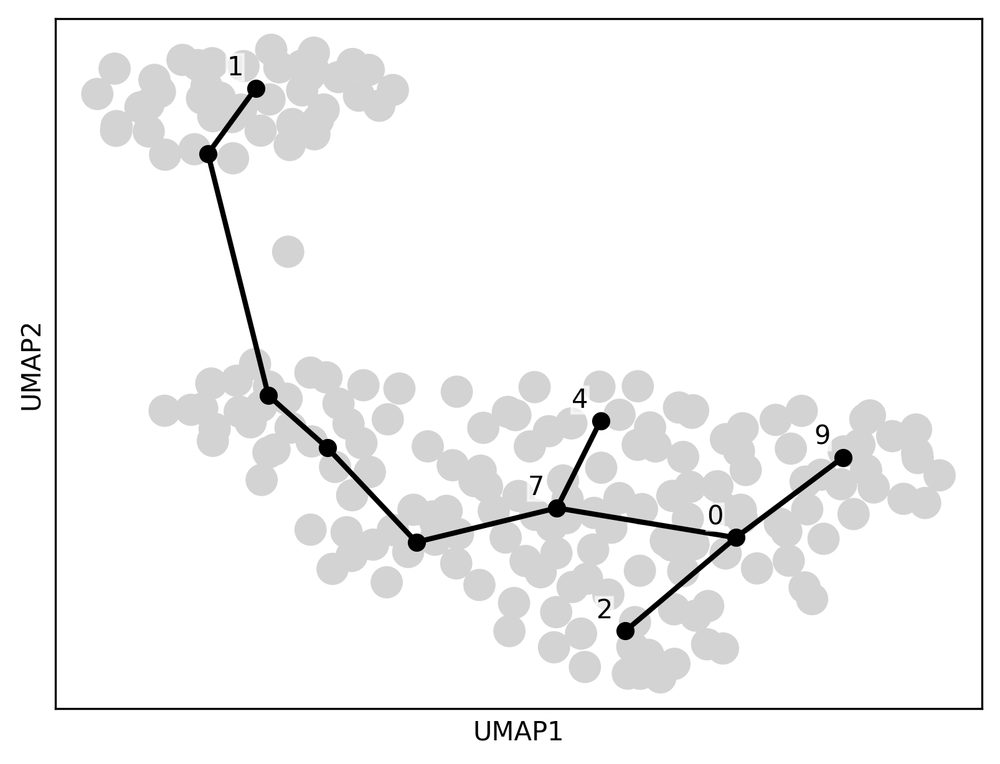

inferring a principal tree --> parameters used 
    20 principal points, sigma = 0.1, lambda = 1, metric = euclidean
    fitting:  42%|████▏     | 21/50 [00:00<00:00, 189.98it/s]
    converged
    finished (0:00:00) --> added 
    .uns['ppt'], dictionnary containing inferred tree.
    .obsm['X_R'] soft assignment of cells to principal points.
    .uns['graph']['B'] adjacency matrix of the principal points.
    .uns['graph']['F'] coordinates of principal points in representation space.


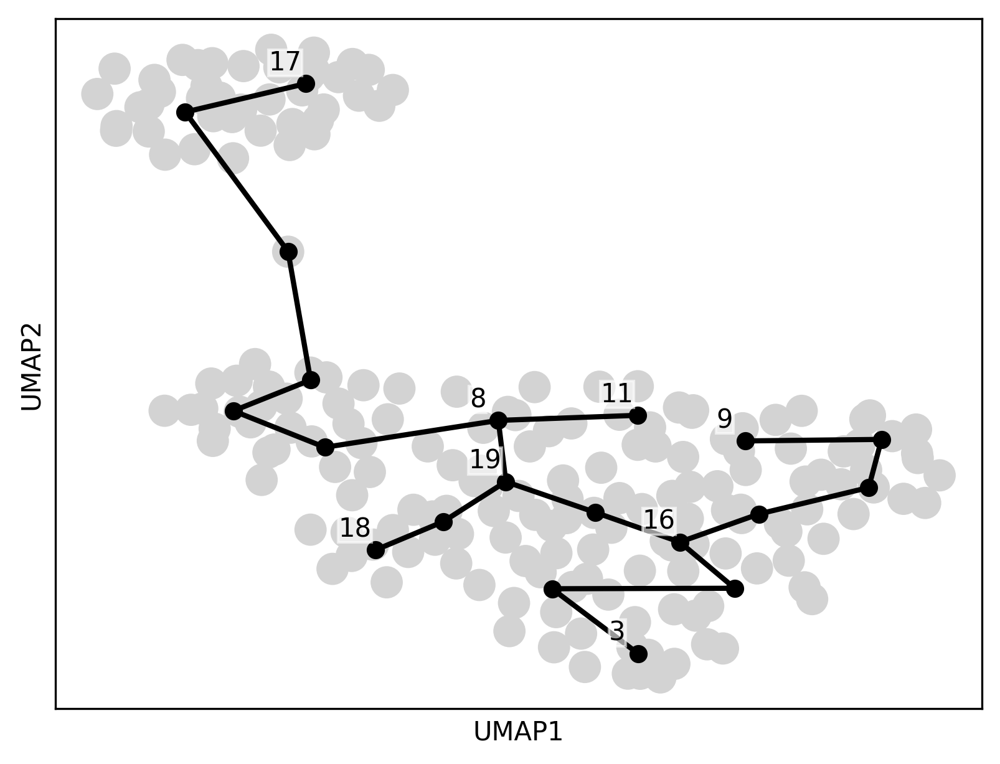

inferring a principal tree --> parameters used 
    40 principal points, sigma = 0.1, lambda = 1, metric = euclidean
    fitting:  32%|███▏      | 16/50 [00:00<00:01, 27.74it/s]
    converged
    finished (0:00:00) --> added 
    .uns['ppt'], dictionnary containing inferred tree.
    .obsm['X_R'] soft assignment of cells to principal points.
    .uns['graph']['B'] adjacency matrix of the principal points.
    .uns['graph']['F'] coordinates of principal points in representation space.


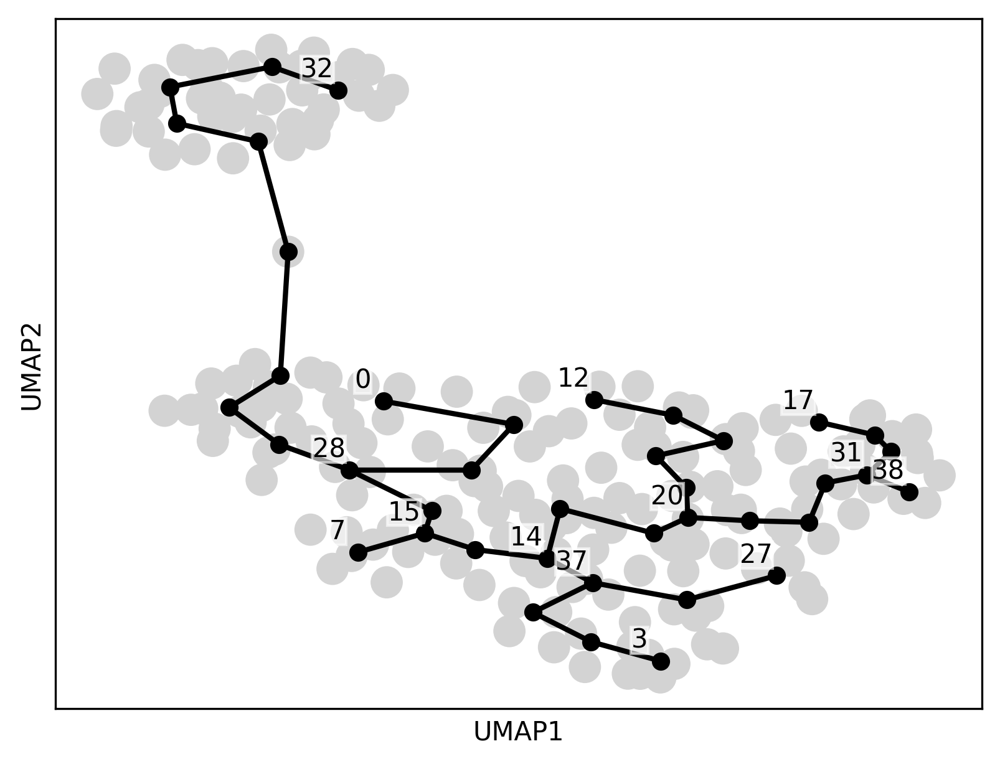

inferring a principal tree --> parameters used 
    40 principal points, sigma = 0.5, lambda = 1, metric = euclidean
    fitting:  25%|██▌       | 25/100 [00:00<00:01, 65.19it/s]
    converged
    finished (0:00:00) --> added 
    .uns['ppt'], dictionnary containing inferred tree.
    .obsm['X_R'] soft assignment of cells to principal points.
    .uns['graph']['B'] adjacency matrix of the principal points.
    .uns['graph']['F'] coordinates of principal points in representation space.


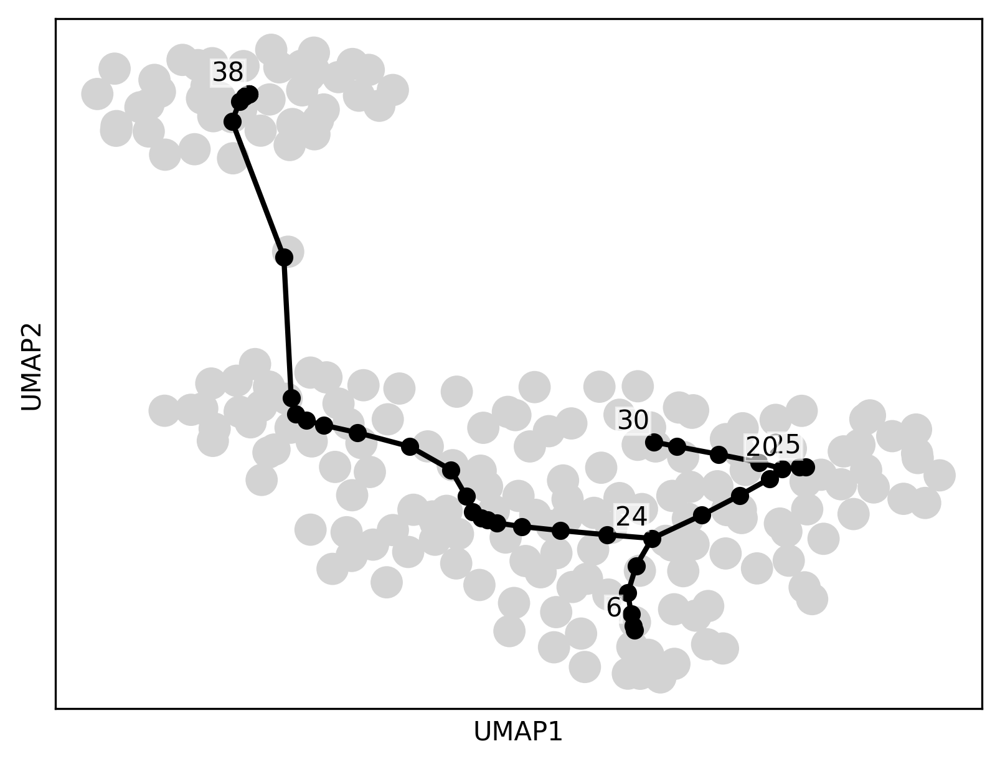

inferring a principal tree --> parameters used 
    40 principal points, sigma = 0.8, lambda = 1, metric = euclidean
    fitting:   9%|▉         | 9/100 [00:00<00:04, 20.52it/s]
    converged
    finished (0:00:00) --> added 
    .uns['ppt'], dictionnary containing inferred tree.
    .obsm['X_R'] soft assignment of cells to principal points.
    .uns['graph']['B'] adjacency matrix of the principal points.
    .uns['graph']['F'] coordinates of principal points in representation space.


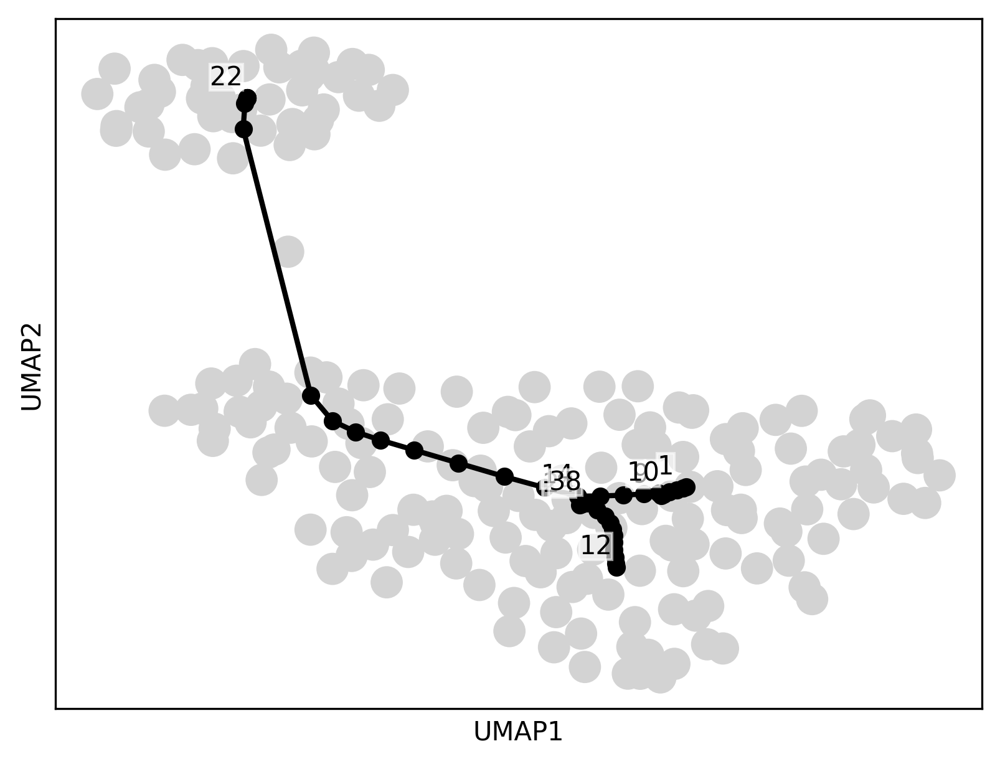

inferring a principal tree --> parameters used 
    40 principal points, sigma = 2, lambda = 1, metric = euclidean
    fitting:  59%|█████▉    | 59/100 [00:01<00:01, 36.30it/s]
    converged
    finished (0:00:01) --> added 
    .uns['ppt'], dictionnary containing inferred tree.
    .obsm['X_R'] soft assignment of cells to principal points.
    .uns['graph']['B'] adjacency matrix of the principal points.
    .uns['graph']['F'] coordinates of principal points in representation space.


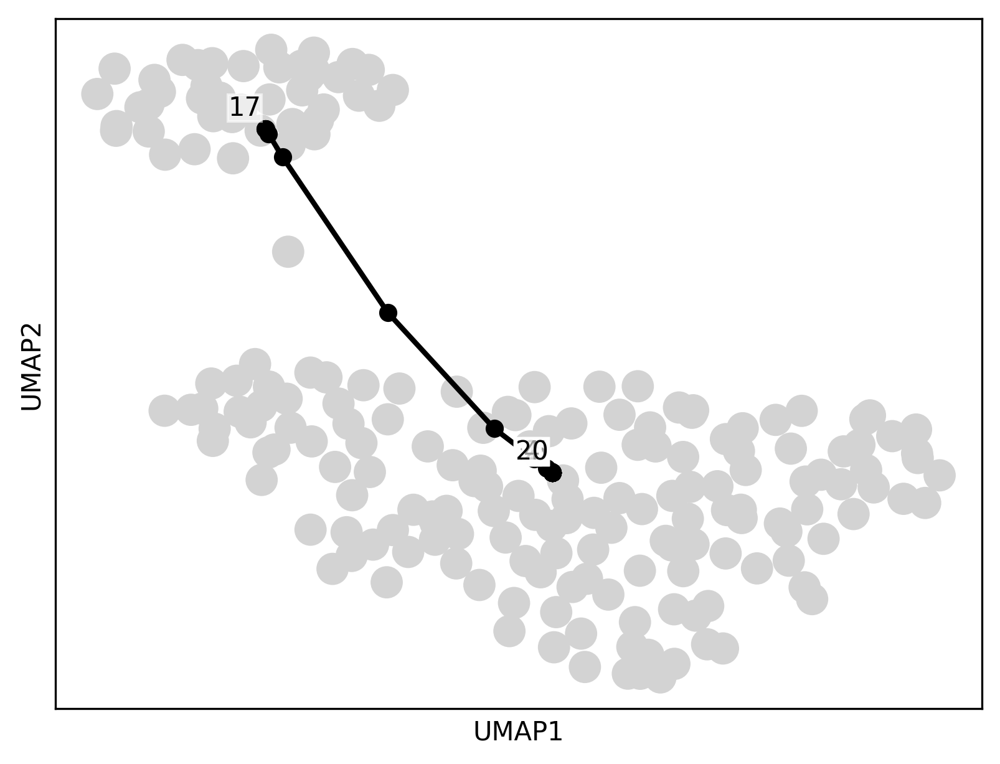

In [ ]:
# trying multiple Nodes number
adNorm_maturation.obsm["X_umap"]=adNorm_maturation.obsm["X_umap"][:,:2].copy()
# Nodes = 10
scf.tl.tree(adNorm_maturation,method="ppt",Nodes=10,use_rep="X_umap")
scf.pl.graph(adNorm_maturation, basis='umap')
# Nodes = 20
scf.tl.tree(adNorm_maturation,method="ppt",Nodes=20,use_rep="X_umap")
scf.pl.graph(adNorm_maturation, basis='umap')
# Nodes = 40
scf.tl.tree(adNorm_maturation,method="ppt",Nodes=40,use_rep="X_umap")
scf.pl.graph(adNorm_maturation, basis='umap')
# trying multiple sigma
# sigma= 0.5
scf.tl.tree(adNorm_maturation, method ='ppt',Nodes = 40, use_rep = 'X_umap', ppt_lmabda =100, ppt_sigma= 0.5, ppt_nsteps = 100)
scf.pl.graph(adNorm_maturation, basis='umap')
# sigma= 0.8
scf.tl.tree(adNorm_maturation, method ='ppt',Nodes = 40, use_rep = 'X_umap', ppt_lmabda =100, ppt_sigma= 0.8, ppt_nsteps = 100)
scf.pl.graph(adNorm_maturation, basis='umap')
# sigma= 2
scf.tl.tree(adNorm_maturation, method ='ppt',Nodes = 40, use_rep = 'X_umap', ppt_lmabda =100, ppt_sigma= 2, ppt_nsteps = 100)
scf.pl.graph(adNorm_maturation, basis='umap')


scanpy==1.9.8 anndata==0.10.7 umap==0.5.6 numpy==1.25.2 scipy==1.11.4 pandas==1.5.3 scikit-learn==1.2.2 statsmodels==0.14.2 igraph==0.11.5 pynndescent==0.5.12
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
AnnData object with n_obs × n_vars = 194 × 17339
    obs: 'cell_id', 'keep', 'day', 'embryo_id', 'experimental_batch', 'major_trajectory', 'celltype_update', 'file_origin', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'n_genes', 'n_counts', 'leiden'
    var: 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'leiden', 'paga', 'leiden_sizes', 'umap', 'leiden_colors', 'rank_genes_groups', 'rank_genes_groups_filtered', 'graph', 'ppt'
    obsm: 'X_pca', 'X_umap', 'X_R'
  

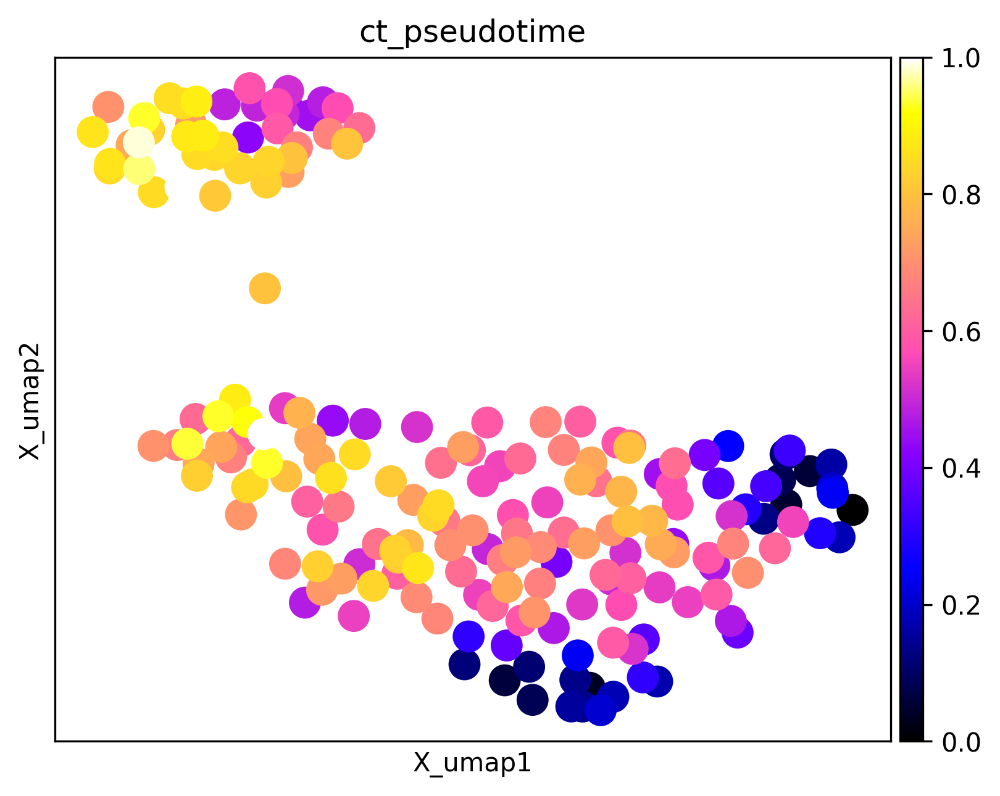

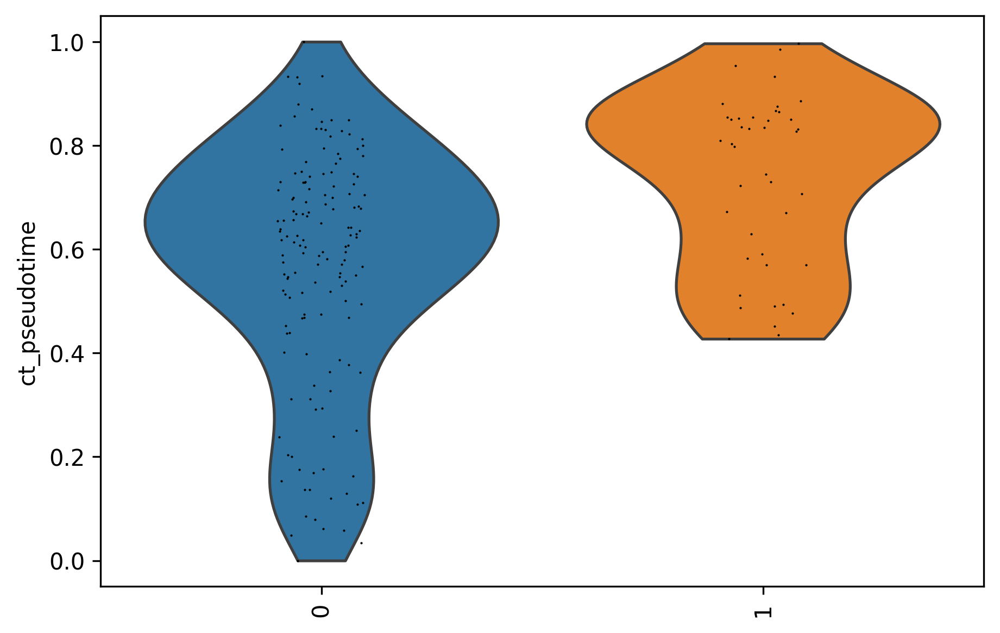

  0%|          | 0/194 [00:00<?, ?cell/s]

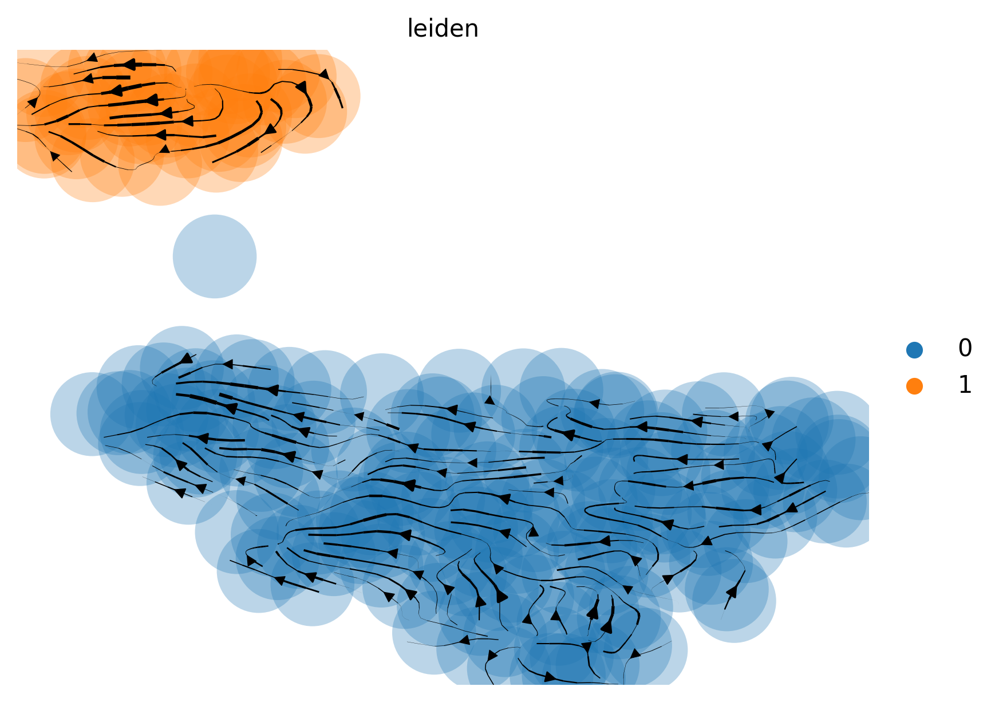

  0%|          | 0/500 [00:00<?, ?sim/s]

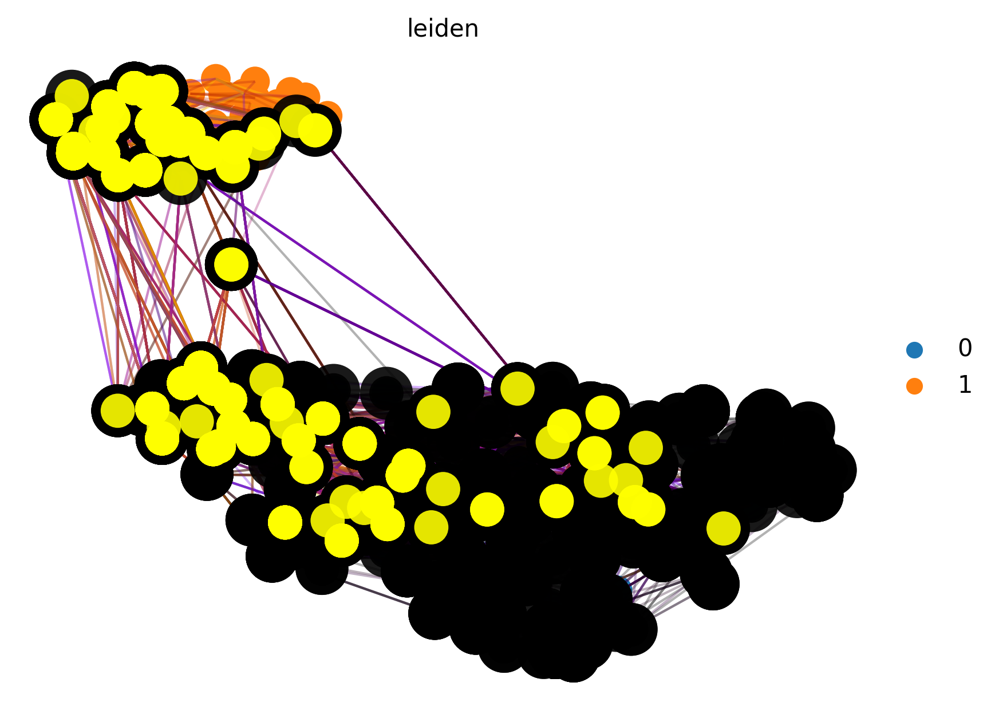

In [ ]:
!pip install cellrank
!pip install scvelo
import cellrank as cr
import scvelo as scv
plt.rcParams['figure.dpi'] = 300
sc.logging.print_header()
# cytoTRACE for stemness scoring
np.random.seed(42)
adcyto_maturation= adNorm_maturation.copy()
adcyto_maturation.layers["spliced"] = adcyto_maturation.X
adcyto_maturation.layers["unspliced"] = adcyto_maturation.X
scv.pp.moments(adcyto_maturation, n_pcs=5, n_neighbors=10)
print(adcyto_maturation)
# compute the CytoTRACE score
from cellrank.kernels import CytoTRACEKernel
ctk_maturation = CytoTRACEKernel(adcyto_maturation).compute_cytotrace()
sc.pl.embedding(
    adcyto_maturation,
    color=['ct_pseudotime'],
    basis='X_umap',
    color_map="gnuplot2",
)
# visualize cytoTRACE score quantitatively
sc.pl.violin(adcyto_maturation, keys=['ct_pseudotime'], groupby='leiden', rotation=90)
# Compute and Visualize a transition matrix
ctk_maturation.compute_transition_matrix(threshold_scheme="soft", nu=0.5)
ctk_maturation.plot_projection(basis="X_umap", color='leiden', legend_loc="right")


# random-walk validation
ctk_maturation.plot_random_walks(
    n_sims=500,
    start_ixs={"leiden": "0"},
    basis="X_umap",
    color="leiden",
    legend_loc="right",
    seed=6,
)


####  The cytoTRACE results clearly define the maturation level of the two leiden clusters 0 and 1, with cluster 0 to be more immature and cluster 1 to be likely more mature cell types. Next, we perform trajectory inference to figure out TFs of interests.

inferring a principal tree --> parameters used 
    30 principal points, sigma = 1, lambda = 1, metric = euclidean
    fitting:  54%|█████▍    | 54/100 [00:01<00:01, 28.52it/s]
    converged
    finished (0:00:01) --> added 
    .uns['ppt'], dictionnary containing inferred tree.
    .obsm['X_R'] soft assignment of cells to principal points.
    .uns['graph']['B'] adjacency matrix of the principal points.
    .uns['graph']['F'] coordinates of principal points in representation space.


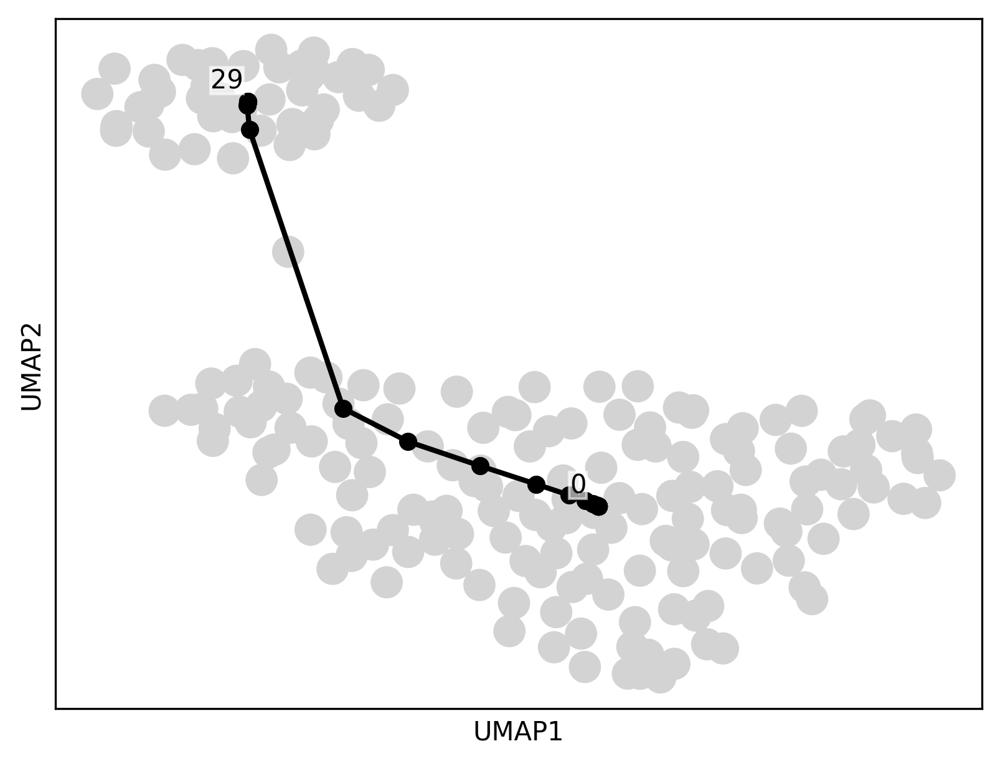

node 0 selected as a root --> added
    .uns['graph']['root'] selected root.
    .uns['graph']['pp_info'] for each PP, its distance vs root and segment assignment.
    .uns['graph']['pp_seg'] segments network information.
projecting cells onto the principal graph
    finished (0:00:00) --> added
    .obs['edge'] assigned edge.
    .obs['t'] pseudotime value.
    .obs['seg'] segment of the tree assigned.
    .obs['milestones'] milestone assigned.
    .uns['pseudotime_list'] list of cell projection from all mappings.


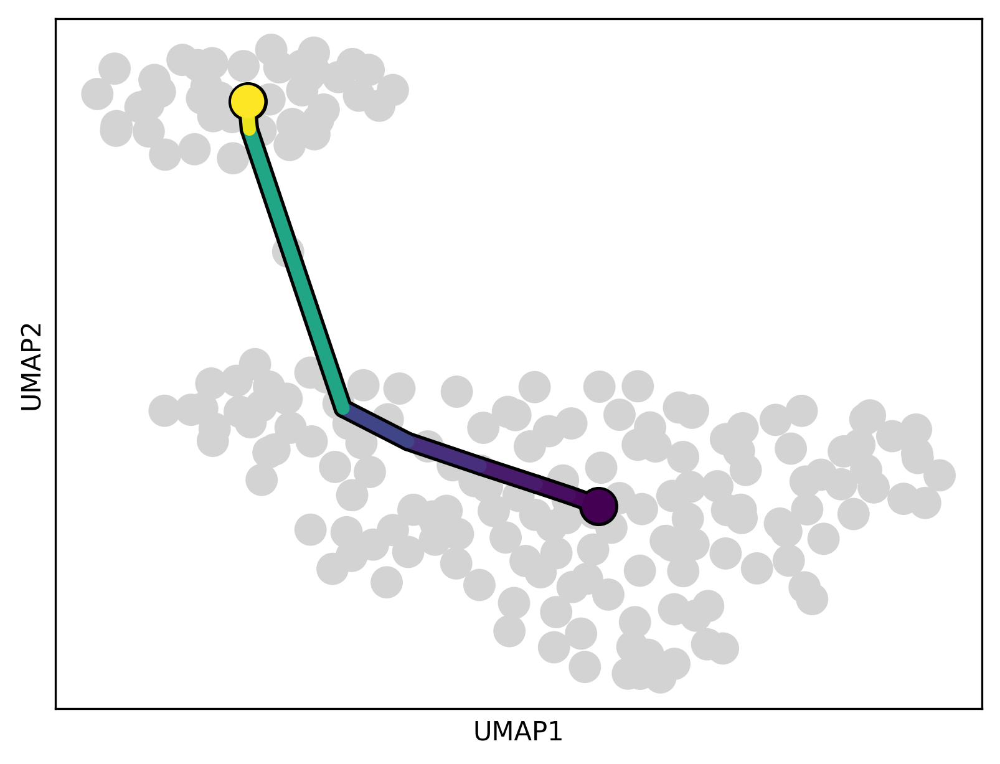

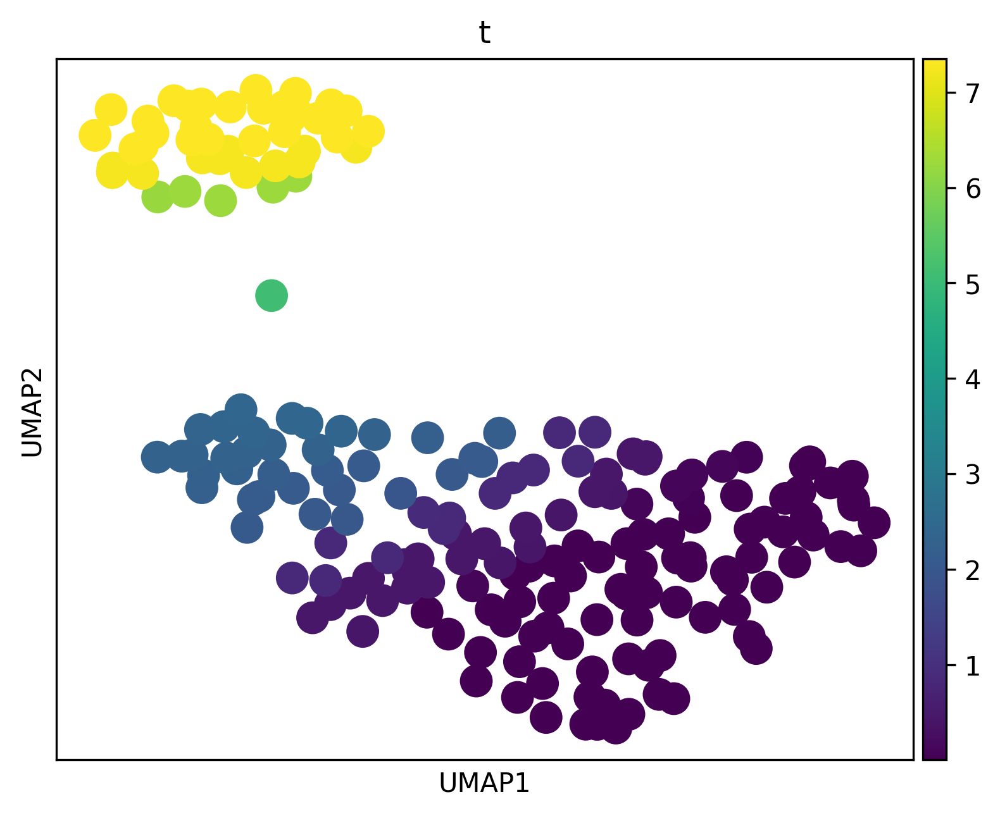

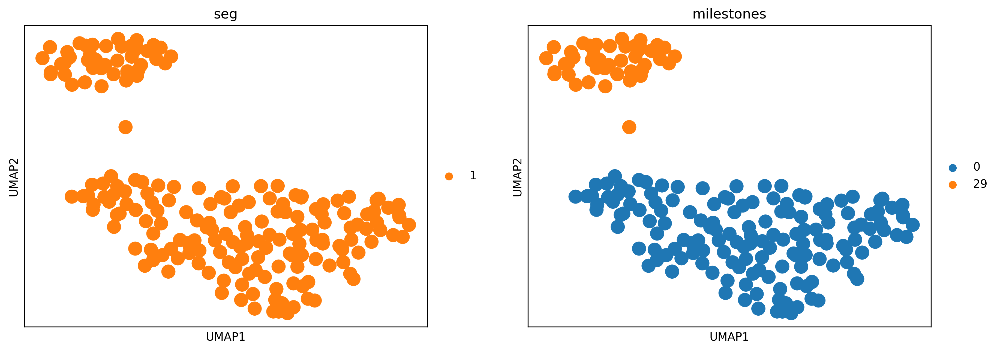

Generating dendrogram of tree
    segment : 100%|██████████| 1/1 [00:00<00:00,  5.84it/s]
    finished (0:00:00) --> added 
    .obsm['X_dendro'], new embedding generated.
    .uns['dendro_segments'] tree segments used for plotting.


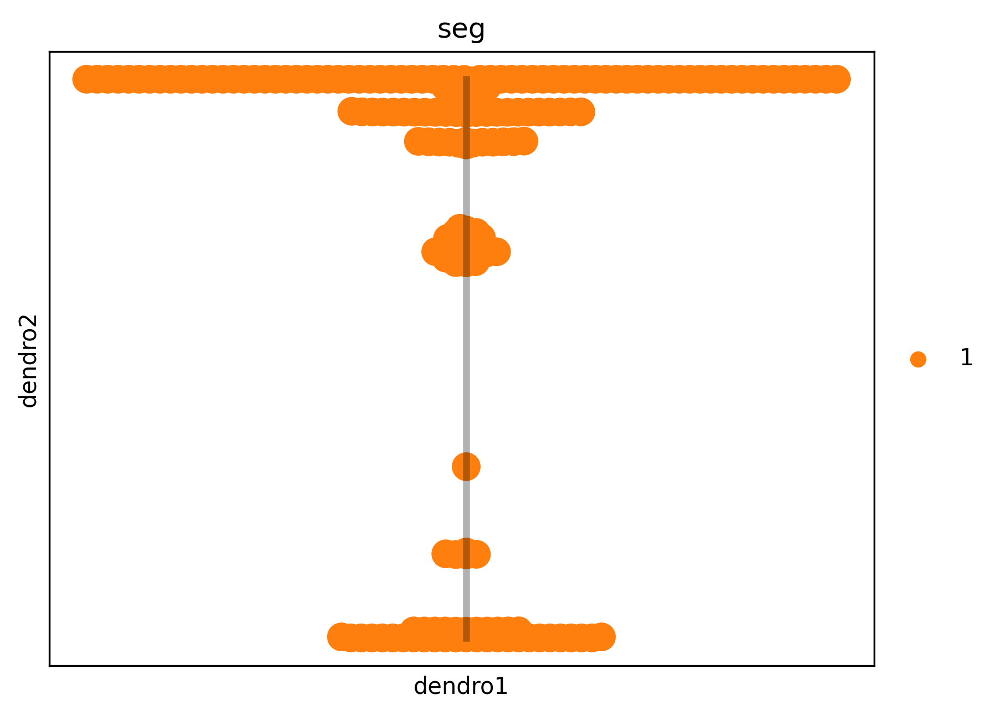

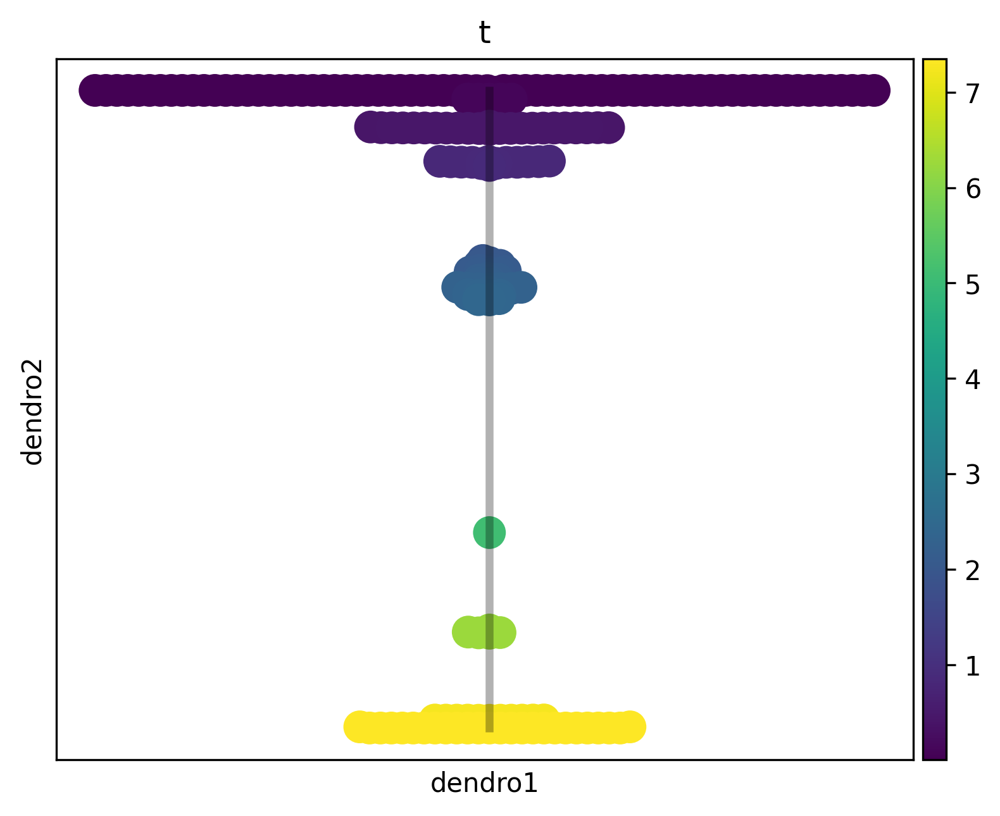

In [ ]:
# select nodes = 30, sigma= 1
np.random.seed(0)
scf.tl.tree(adNorm_maturation, method ='ppt',Nodes = 30, use_rep = 'X_umap', ppt_lmabda =100, ppt_sigma= 1, ppt_nsteps = 100)
scf.pl.graph(adNorm_maturation, basis='umap')
# artificially defining the root, supervised
scf.tl.root(adNorm_maturation, 0)

scf.tl.pseudotime(adNorm_maturation,seed = 42)
scf.pl.trajectory(adNorm_maturation,basis = 'umap')
sc.pl.umap(adNorm_maturation,color = 't')
sc.pl.umap(adNorm_maturation, color = ['seg','milestones'])
scf.tl.dendrogram(adNorm_maturation)
scf.pl.dendrogram(adNorm_maturation,color= 'seg')
scf.pl.dendrogram(adNorm_maturation,color= 't')


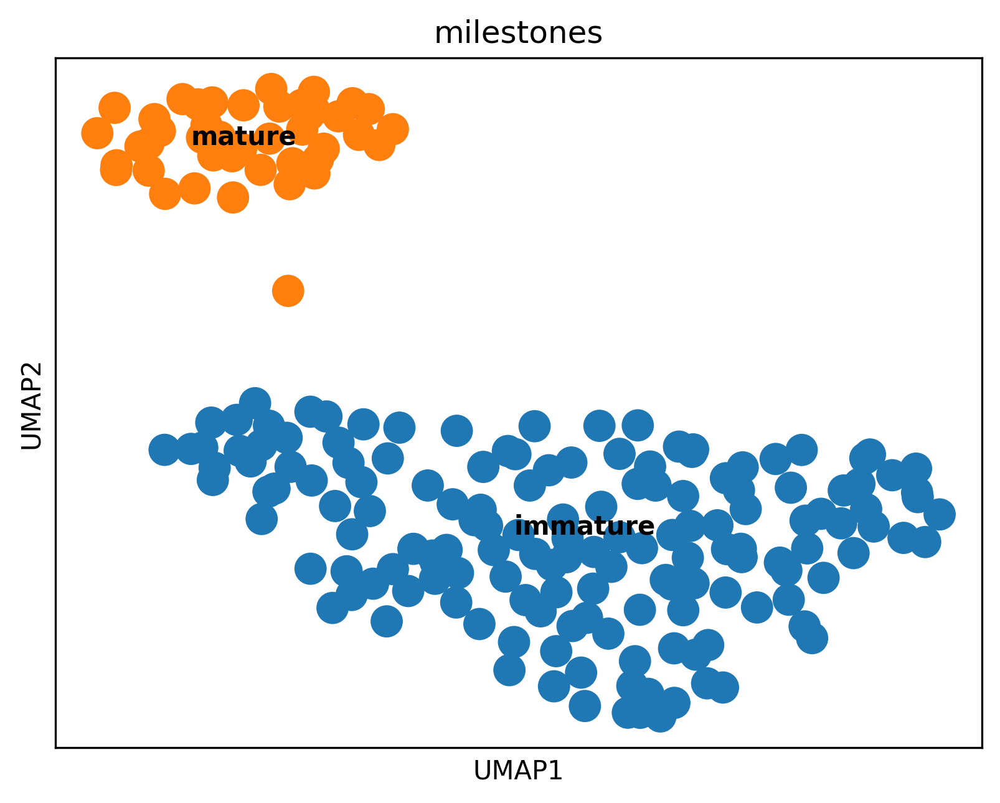

In [ ]:
# renaming milestones
scf.tl.rename_milestones(adNorm_maturation, ['immature','mature'])
sc.pl.umap(adNorm_maturation, color=['milestones'],legend_loc='on data')

Since the development pattern is very clean between two clusters, we can directly use the TFs we identified from DEG for downstream GRN

## **Below are for comparison: Discussion part**: Attempt to separate each timepoint and analyze separately, see if further subsetting cell types that are specific to each bifurcation can improve the sensitivity of DEG analysis at that bifurcation **(You can skip this part for grading) **

### Here we will re-subset the data set, and perform DEG, trajectory inference and dynamic TFs identification to figure out TFs that promote Sclerotome differentiation into the fibroblast fate instead of Chondrocytes.



### **Part 2.1 DEG between three cell types:Sclerotome, chondrocytes(Atp1a2+) and fibroblast**

/usr/local/lib/python3.10/dist-packages/pandas/core/algorithms.py:522: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps_array.dtype], [])
/usr/local/lib/python3.10/dist-packages/pandas/core/dtypes/cast.py:1641: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  return np.find_common_type(types, [])
/usr/local/lib/python3.10/dist-packages/pandas/core/algorithms.py:522: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  comm

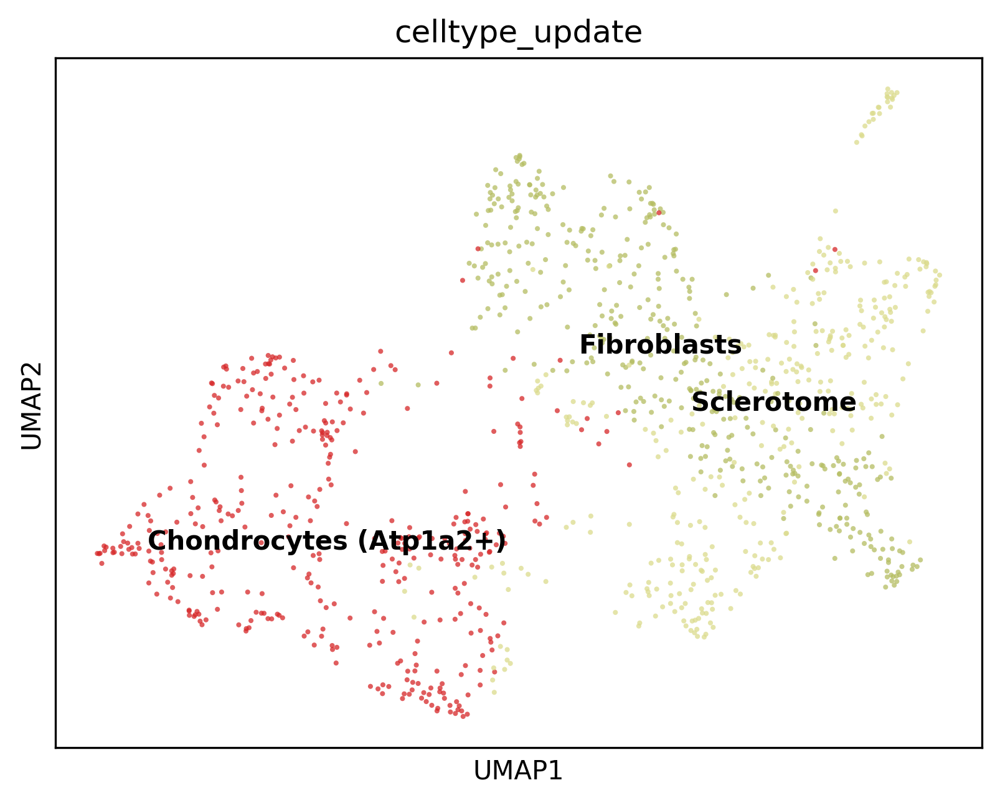

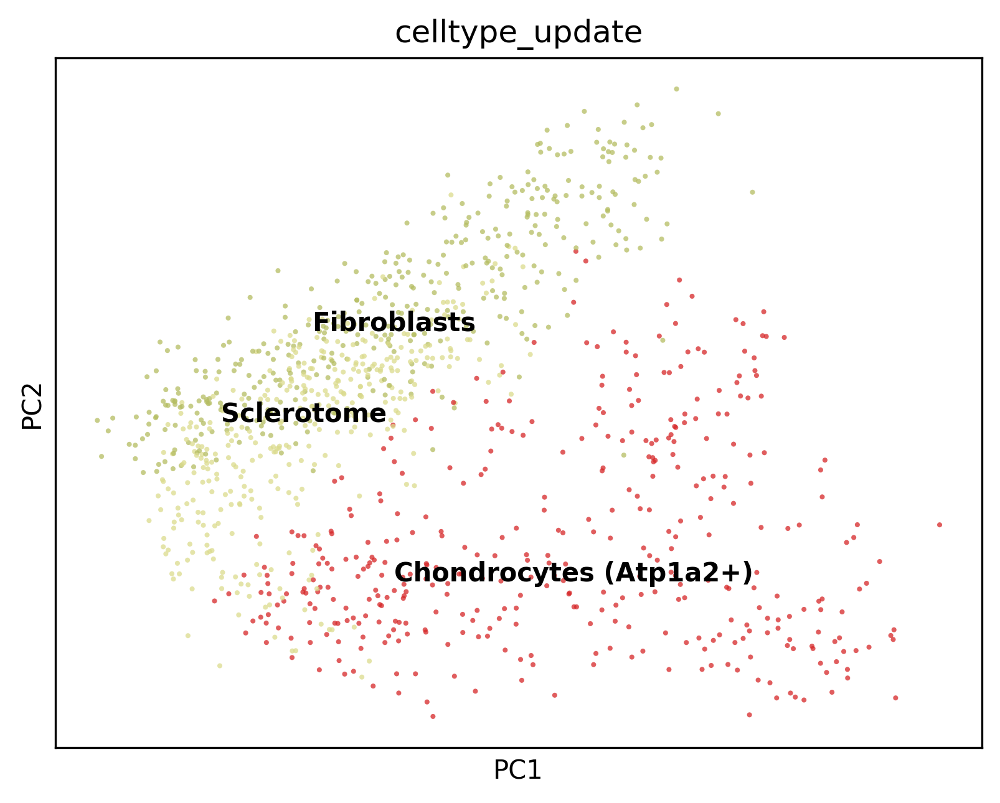

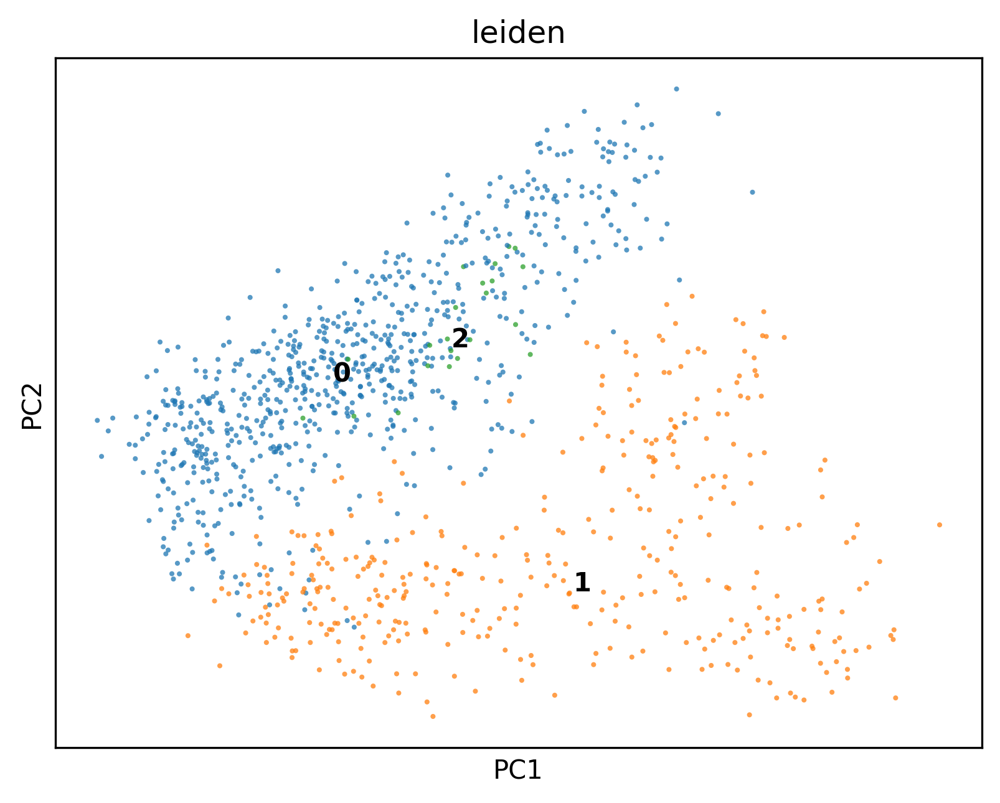

In [ ]:
# subsetting the late-stage data from sclerotome to fibroblast and Chondrocytes
selected_cell_types1 = ['Sclerotome','Chondrocytes (Atp1a2+)','Fibroblasts']
adNorm_Mesoderm_subset1 = adNorm_Mesoderm[adNorm_Mesoderm.obs['celltype_update'].isin(selected_cell_types1),:].copy()
# redo HVG,PCA, umap
sc.pp.highly_variable_genes(adNorm_Mesoderm_subset1, min_mean=0.05, max_mean=6, min_disp=0.25)
sc.tl.pca(adNorm_Mesoderm_subset1, use_highly_variable=True)
n_neighbors = 15
n_pcs = 30
sc.pp.neighbors(adNorm_Mesoderm_subset1, n_neighbors=n_neighbors, n_pcs=n_pcs)
sc.tl.leiden(adNorm_Mesoderm_subset1,.1)
sc.tl.paga(adNorm_Mesoderm_subset1)
sc.pl.paga(adNorm_Mesoderm_subset1, plot=False)
sc.tl.umap(adNorm_Mesoderm_subset1, 0.25, init_pos='paga')
sc.pl.umap(adNorm_Mesoderm_subset1,color=['celltype_update'], alpha=.75, s=15, legend_loc='on data')
sc.pl.pca(adNorm_Mesoderm_subset1,color=['celltype_update'], alpha=.75, s=15, legend_loc='on data')
sc.pl.pca(adNorm_Mesoderm_subset1,color=['leiden'], alpha=.75, s=15, legend_loc='on data')



/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
/usr/local/lib/python3.10/dist-packages/pandas/core/algorithms.py:522: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps_array.dtype], [])
/usr/local/lib/python3.10/dist-packages/pandas/core/dtypes/cast.py:1641: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecat

/usr/local/lib/python3.10/dist-packages/pandas/core/algorithms.py:522: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps_array.dtype], [])
/usr/local/lib/python3.10/dist-packages/pandas/core/algorithms.py:522: DeprecationWarning: np.find_common_type is deprecated.  Please use `np.result_type` or `np.promote_types`.
See https://numpy.org/devdocs/release/1.25.0-notes.html and the docs for more information.  (Deprecated NumPy 1.25)
  common = np.find_common_type([values.dtype, comps_array.dtype], [])


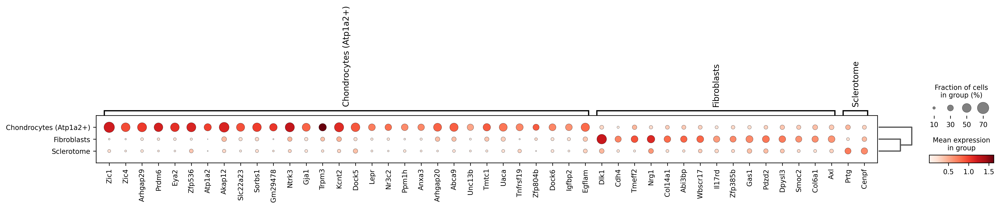

['Ebf2']
['Zic1', 'Zic4', 'Prdm6', 'Zfp536', 'Nr3c2', 'Maf', 'Foxo1', 'Pdlim5', 'Ikzf2']
[]


In [ ]:
# DEG of Sclerotome, chondrocytes and fibroblast
sc.tl.rank_genes_groups(adNorm_Mesoderm_subset1, use_raw=False, groupby="celltype_update")
sc.tl.filter_rank_genes_groups(adNorm_Mesoderm_subset1, min_fold_change=.2, min_in_group_fraction=.3, max_out_group_fraction=.2)
sc.pl.rank_genes_groups_dotplot(adNorm_Mesoderm_subset1, n_genes=30, groupby="celltype_update", dendrogram=True, key='rank_genes_groups_filtered')
# Take out DEG list and extract TFs and important receptors genes
result1 = adNorm_Mesoderm_subset1.uns['rank_genes_groups_filtered']
groups1 = result1['names'].dtype.names
deg_data1 = {group: result1['names'][group] for group in groups1}
deg_df1 = pd.DataFrame(deg_data1)

# Filter out genes specific to 'Sclerotome'
Sclerotome_genes_1 = deg_df1['Sclerotome'].dropna().unique()
# Filter out genes specific to 'chondrocytes'
chondrocytes_genes = deg_df1['Chondrocytes (Atp1a2+)'].dropna().unique()
# Filter out genes specific to 'fibroblast'
fibroblast_genes = deg_df1['Fibroblasts'].dropna().unique()
# Identify TFs from the fibroblast1 related gene list
with open('/content/drive/MyDrive/allTFs_mm_aertslab_011924.txt', 'r') as file:
    mouse_tfs = [line.strip() for line in file]
#find out Transcription factors
Sclerotome_tfs_1 = [gene for gene in Sclerotome_genes_1 if gene in mouse_tfs]
chondrocytes_tfs = [gene for gene in chondrocytes_genes if gene in mouse_tfs]
fibroblast_tfs = [gene for gene in fibroblast_genes if gene in mouse_tfs]
print(Sclerotome_tfs)
print(chondrocytes_tfs)
print(fibroblast_tfs)


From the above DEG results, There doesn't seem to be significantly differentially upregulated transcription factors in fibroblast; but a list of TFs that potentially promote chondrocytes(Atp1a2+) fate are identified as: 'Zic1', 'Zic4', 'Prdm6', 'Zfp536', 'Nr3c2', 'Maf', 'Foxo1', 'Pdlim5', 'Ikzf2'. By inhibiting these TFs, the sclerotome development can be potentially skewed to favour the fibroblast cell fate.
Additionally, the Zfp385b gene is a zinc finger protein, which might serve as a transcription factor. Dlk1, even though not a TF, is a transmembrane protein known to be involved in cell differentiation processes.



### **Part 2.2 Attempt to compare further subsetting improving sensitives of bifurcation DEG: Trajectory inference for sclerotome to fibroblast/chondrocytes**

inferring a principal tree --> parameters used 
    10 principal points, sigma = 0.1, lambda = 1, metric = euclidean
    fitting:  50%|█████     | 25/50 [00:00<00:00, 61.60it/s]
    converged
    finished (0:00:00) --> added 
    .uns['ppt'], dictionnary containing inferred tree.
    .obsm['X_R'] soft assignment of cells to principal points.
    .uns['graph']['B'] adjacency matrix of the principal points.
    .uns['graph']['F'] coordinates of principal points in representation space.


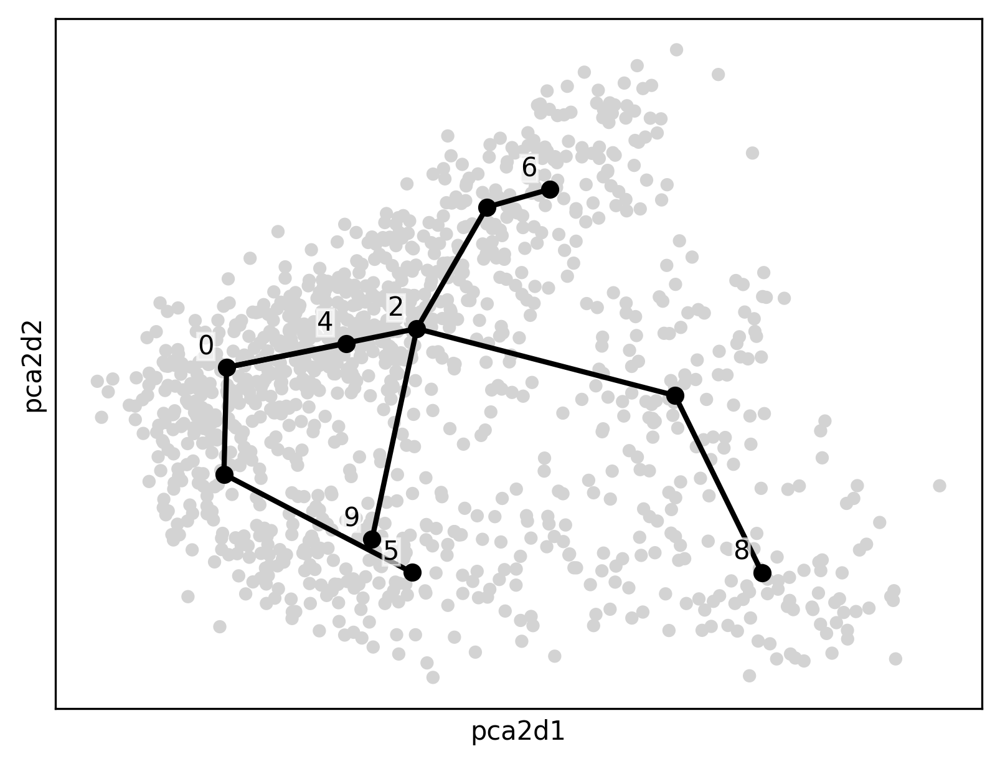

inferring a principal tree --> parameters used 
    15 principal points, sigma = 0.1, lambda = 1, metric = euclidean
    fitting:  46%|████▌     | 23/50 [00:00<00:00, 101.58it/s]
    converged
    finished (0:00:00) --> added 
    .uns['ppt'], dictionnary containing inferred tree.
    .obsm['X_R'] soft assignment of cells to principal points.
    .uns['graph']['B'] adjacency matrix of the principal points.
    .uns['graph']['F'] coordinates of principal points in representation space.


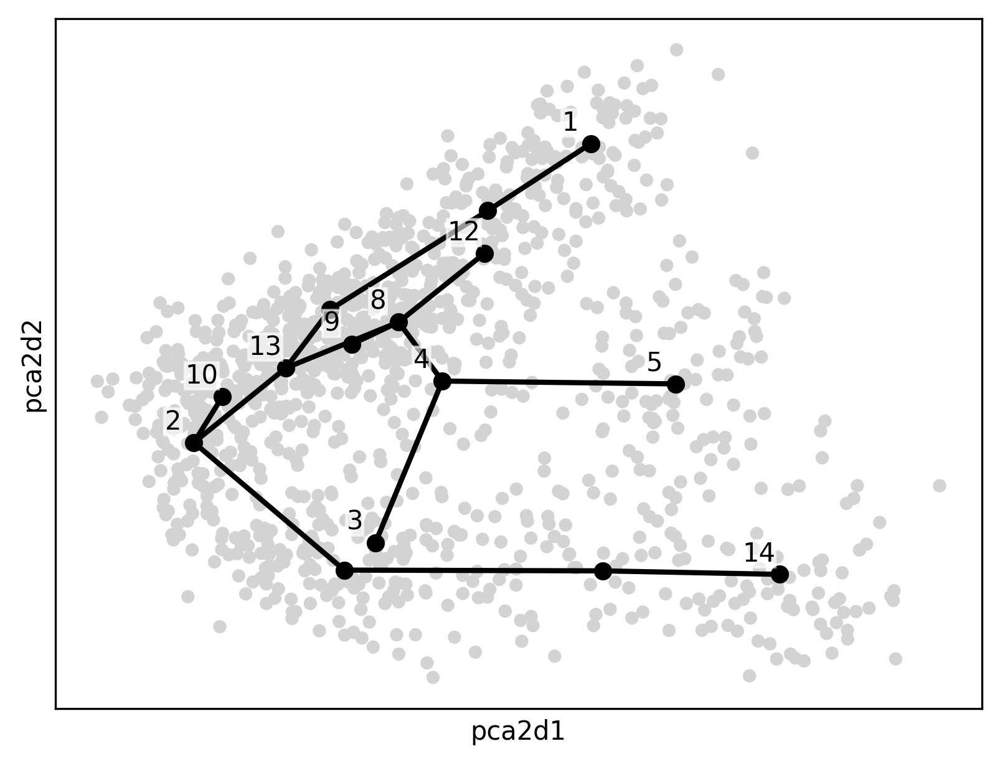

inferring a principal tree --> parameters used 
    20 principal points, sigma = 0.1, lambda = 1, metric = euclidean
    fitting:  56%|█████▌    | 28/50 [00:00<00:00, 56.06it/s]
    converged
    finished (0:00:00) --> added 
    .uns['ppt'], dictionnary containing inferred tree.
    .obsm['X_R'] soft assignment of cells to principal points.
    .uns['graph']['B'] adjacency matrix of the principal points.
    .uns['graph']['F'] coordinates of principal points in representation space.


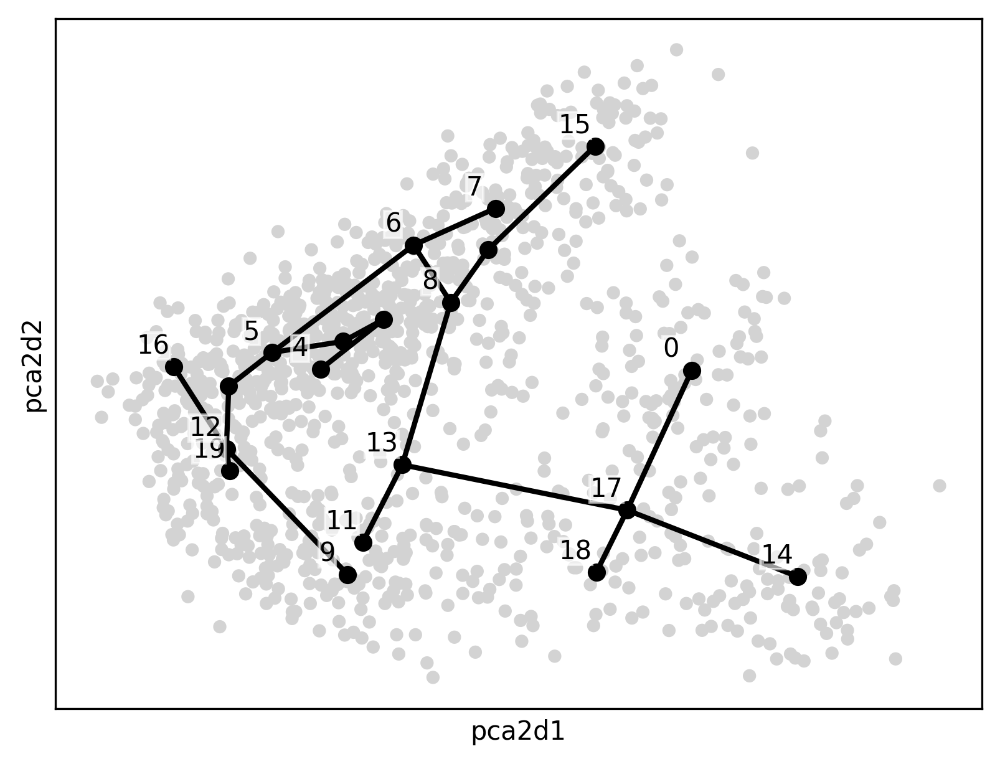

inferring a principal tree --> parameters used 
    30 principal points, sigma = 0.1, lambda = 1, metric = euclidean
    fitting:  42%|████▏     | 21/50 [00:00<00:00, 53.59it/s]
    converged
    finished (0:00:00) --> added 
    .uns['ppt'], dictionnary containing inferred tree.
    .obsm['X_R'] soft assignment of cells to principal points.
    .uns['graph']['B'] adjacency matrix of the principal points.
    .uns['graph']['F'] coordinates of principal points in representation space.


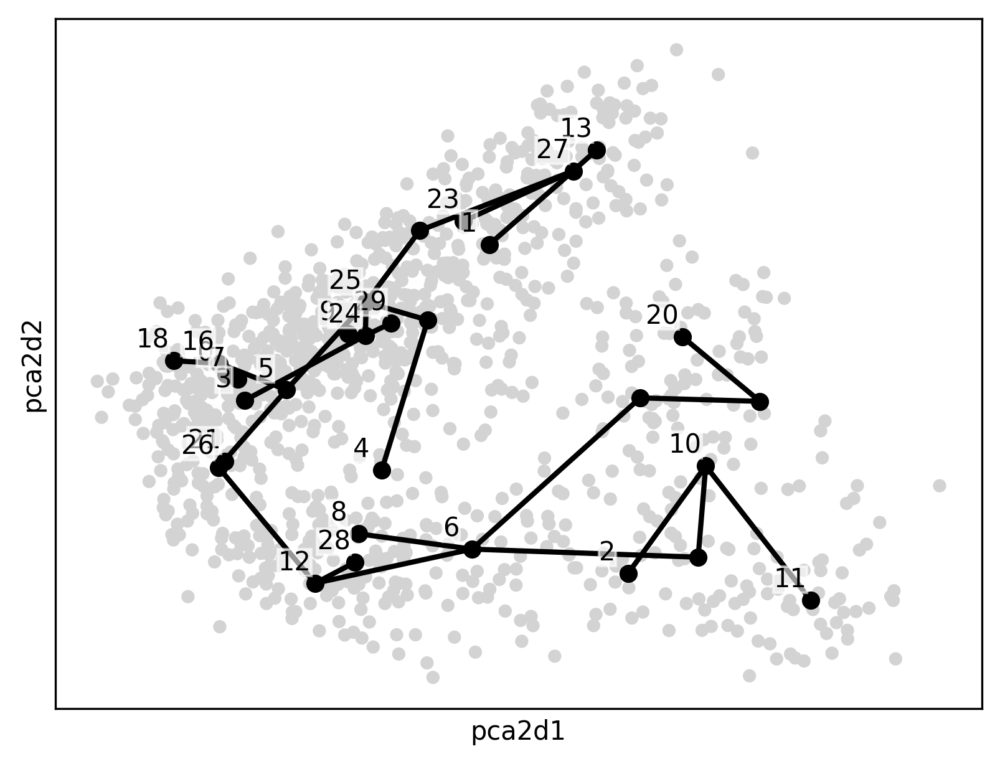

inferring a principal tree --> parameters used 
    40 principal points, sigma = 0.1, lambda = 1, metric = euclidean
    fitting: 100%|██████████| 50/50 [00:00<00:00, 67.21it/s]
    not converged (error: 0.02609825862309265)
    finished (0:00:00) --> added 
    .uns['ppt'], dictionnary containing inferred tree.
    .obsm['X_R'] soft assignment of cells to principal points.
    .uns['graph']['B'] adjacency matrix of the principal points.
    .uns['graph']['F'] coordinates of principal points in representation space.


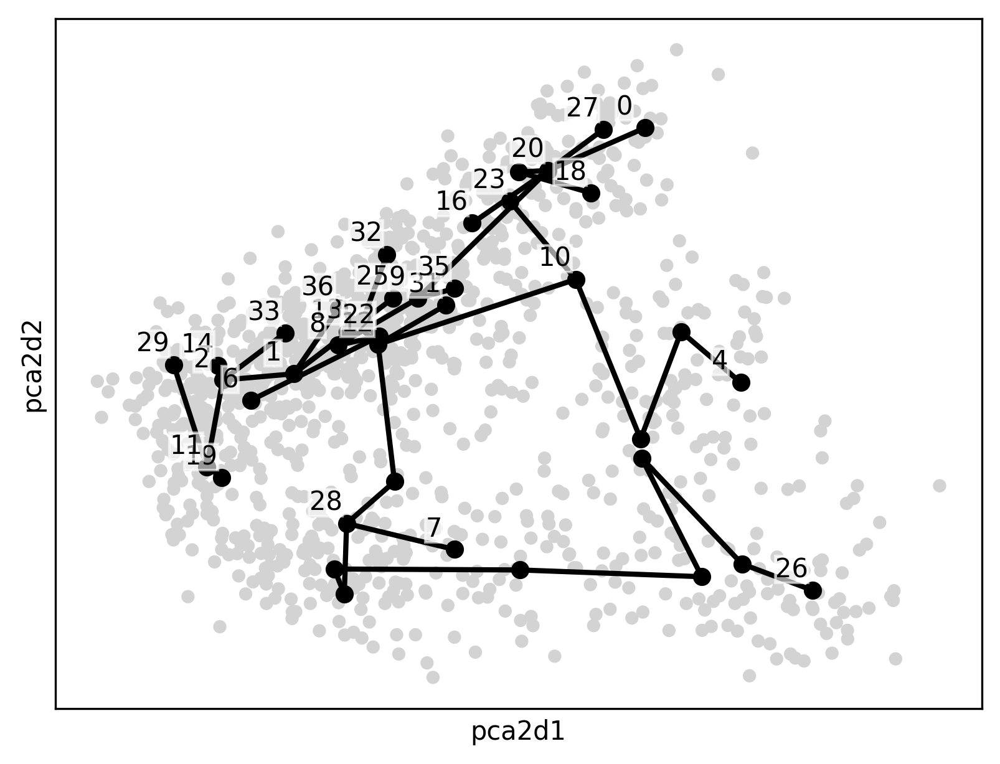

In [ ]:
# trying multiple Nodes number
adNorm_Mesoderm_subset1.obsm["X_pca2d"]=adNorm_Mesoderm_subset1.obsm["X_pca"][:,:2].copy()
# Nodes = 10
scf.tl.tree(adNorm_Mesoderm_subset1,method="ppt",Nodes=10,use_rep="X_pca")
scf.pl.graph(adNorm_Mesoderm_subset1, basis='pca2d')
# Nodes = 15
scf.tl.tree(adNorm_Mesoderm_subset1,method="ppt",Nodes=15,use_rep="X_pca")
scf.pl.graph(adNorm_Mesoderm_subset1, basis='pca2d')
# Nodes = 20
scf.tl.tree(adNorm_Mesoderm_subset1,method="ppt",Nodes=20,use_rep="X_pca")
scf.pl.graph(adNorm_Mesoderm_subset1, basis='pca2d')
# Nodes = 30
scf.tl.tree(adNorm_Mesoderm_subset1,method="ppt",Nodes=30,use_rep="X_pca")
scf.pl.graph(adNorm_Mesoderm_subset1, basis='pca2d')
# Nodes = 40
scf.tl.tree(adNorm_Mesoderm_subset1,method="ppt",Nodes=40,use_rep="X_pca")
scf.pl.graph(adNorm_Mesoderm_subset1, basis='pca2d')

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


inferring a principal tree --> parameters used 
    30 principal points, sigma = 0.025, lambda = 1, metric = euclidean
    fitting:  33%|███▎      | 33/100 [00:00<00:00, 78.60it/s] 
    converged
    finished (0:00:00) --> added 
    .uns['ppt'], dictionnary containing inferred tree.
    .obsm['X_R'] soft assignment of cells to principal points.
    .uns['graph']['B'] adjacency matrix of the principal points.
    .uns['graph']['F'] coordinates of principal points in representation space.


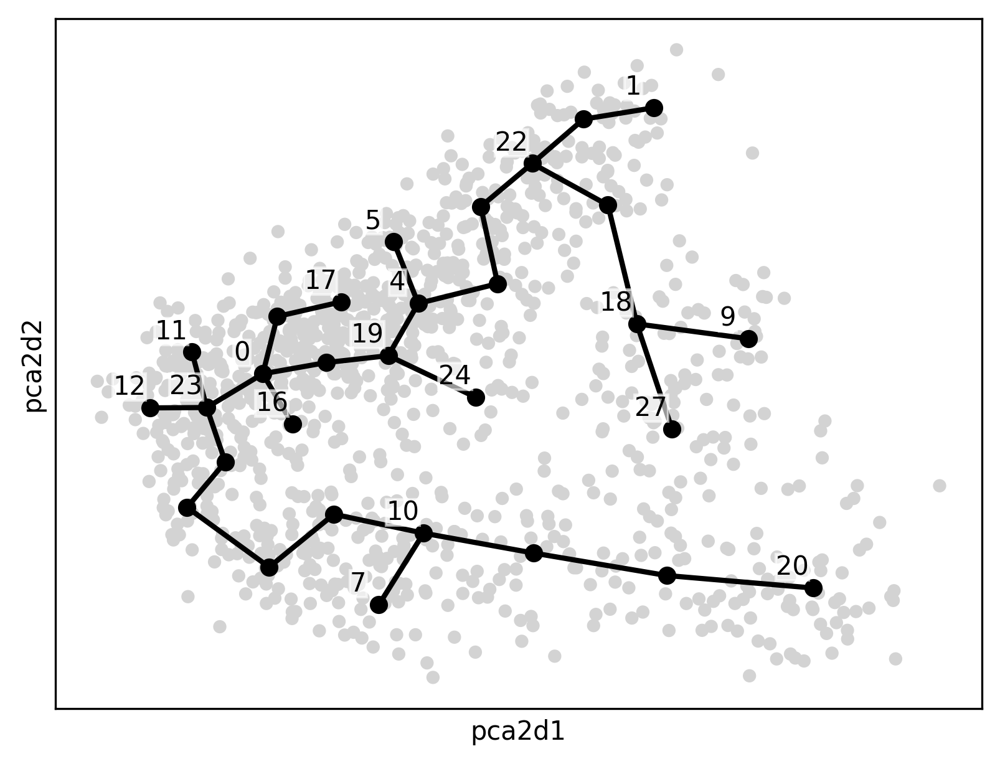

inferring a principal tree --> parameters used 
    30 principal points, sigma = 0.5, lambda = 1, metric = euclidean
    fitting:  70%|███████   | 70/100 [00:00<00:00, 96.45it/s] 
    converged
    finished (0:00:00) --> added 
    .uns['ppt'], dictionnary containing inferred tree.
    .obsm['X_R'] soft assignment of cells to principal points.
    .uns['graph']['B'] adjacency matrix of the principal points.
    .uns['graph']['F'] coordinates of principal points in representation space.


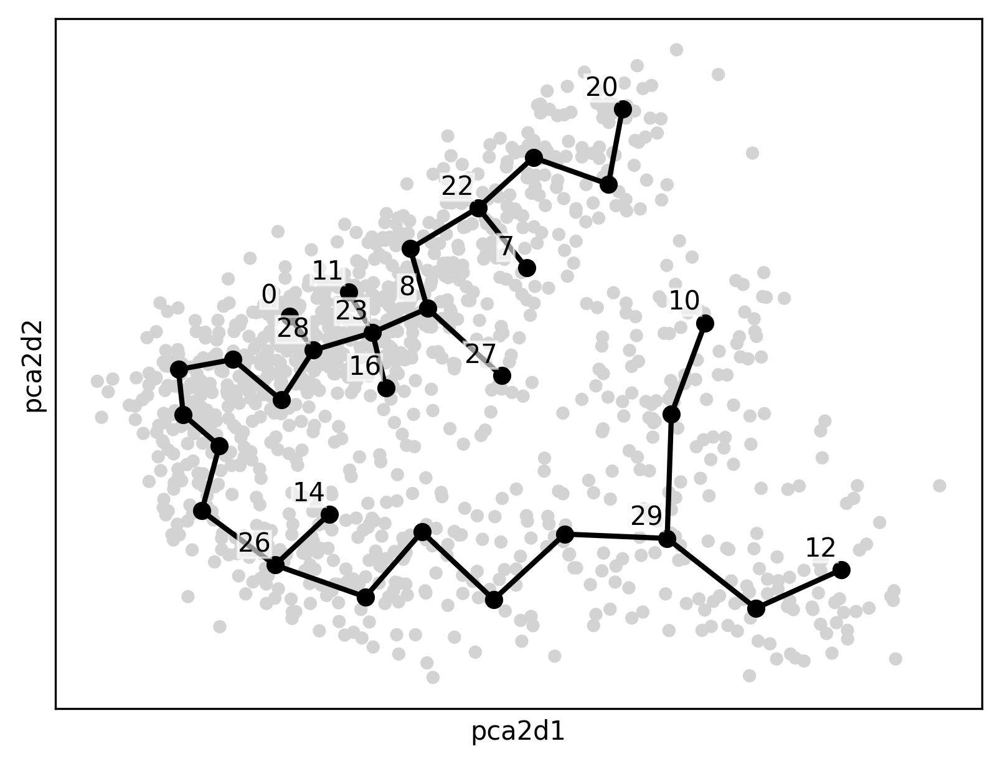

inferring a principal tree --> parameters used 
    30 principal points, sigma = 0.8, lambda = 1, metric = euclidean
    fitting:  55%|█████▌    | 55/100 [00:00<00:00, 73.87it/s] 
    converged
    finished (0:00:00) --> added 
    .uns['ppt'], dictionnary containing inferred tree.
    .obsm['X_R'] soft assignment of cells to principal points.
    .uns['graph']['B'] adjacency matrix of the principal points.
    .uns['graph']['F'] coordinates of principal points in representation space.


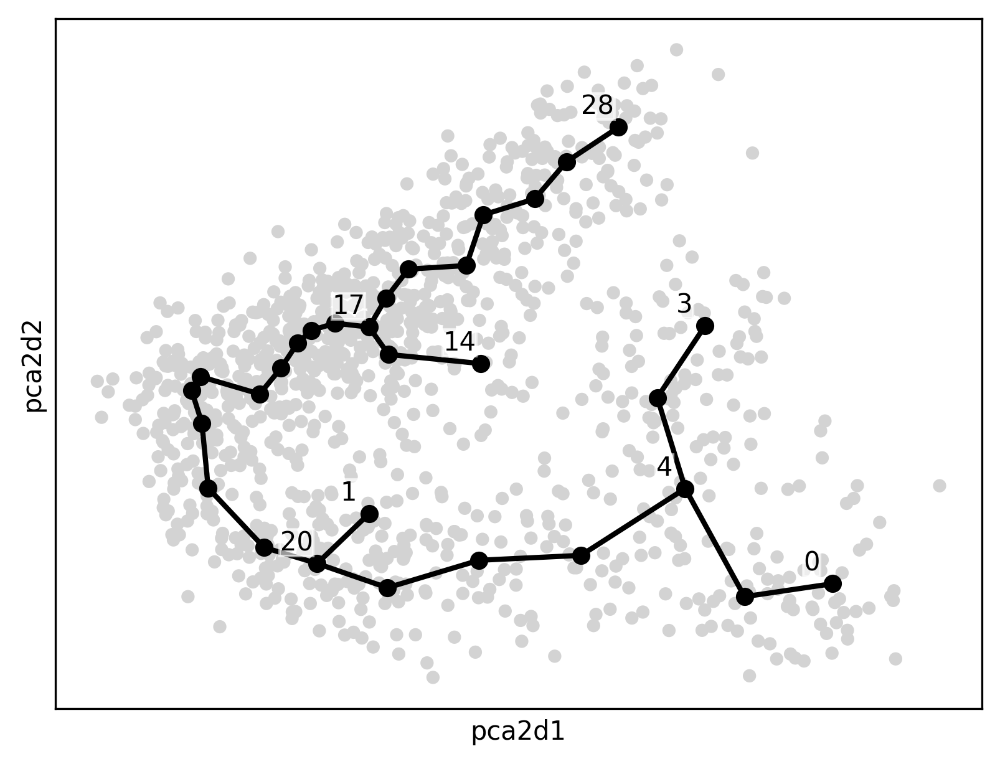

inferring a principal tree --> parameters used 
    30 principal points, sigma = 2, lambda = 1, metric = euclidean
    fitting:  67%|██████▋   | 67/100 [00:00<00:00, 101.77it/s]
    converged
    finished (0:00:00) --> added 
    .uns['ppt'], dictionnary containing inferred tree.
    .obsm['X_R'] soft assignment of cells to principal points.
    .uns['graph']['B'] adjacency matrix of the principal points.
    .uns['graph']['F'] coordinates of principal points in representation space.


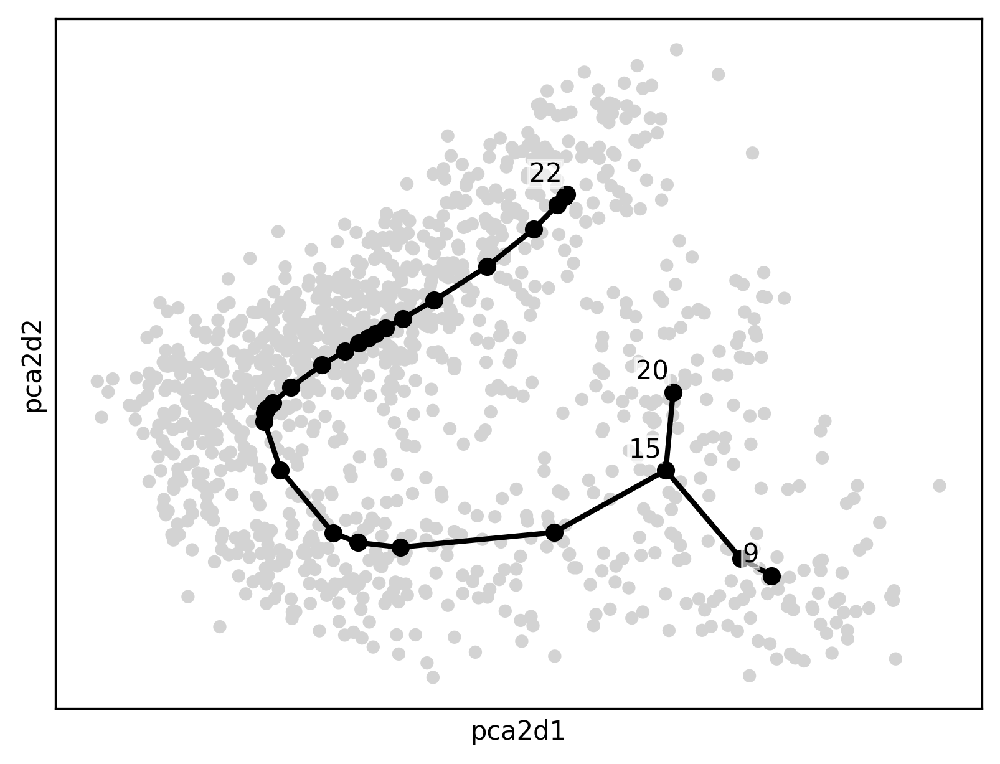

In [ ]:
# trying multiple sigma
# sigma= 0.25
scf.tl.tree(adNorm_Mesoderm_subset1, method ='ppt',Nodes = 30, use_rep = 'X_pca2d', ppt_lmabda =100, ppt_sigma= 0.025, ppt_nsteps = 100)
scf.pl.graph(adNorm_Mesoderm_subset1, basis='pca2d')
# sigma= 0.5
scf.tl.tree(adNorm_Mesoderm_subset1, method ='ppt',Nodes = 30, use_rep = 'X_pca2d', ppt_lmabda =100, ppt_sigma= 0.5, ppt_nsteps = 100)
scf.pl.graph(adNorm_Mesoderm_subset1, basis='pca2d')
# sigma= 0.8
scf.tl.tree(adNorm_Mesoderm_subset1, method ='ppt',Nodes = 30, use_rep = 'X_pca2d', ppt_lmabda =100, ppt_sigma= 0.8, ppt_nsteps = 100)
scf.pl.graph(adNorm_Mesoderm_subset1, basis='pca2d')
# sigma= 2
scf.tl.tree(adNorm_Mesoderm_subset1, method ='ppt',Nodes = 30, use_rep = 'X_pca2d', ppt_lmabda =100, ppt_sigma= 2, ppt_nsteps = 100)
scf.pl.graph(adNorm_Mesoderm_subset1, basis='pca2d')

30 principle points, sigma = 0.8 seems to give decent fitting

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


inferring a principal tree --> parameters used 
    30 principal points, sigma = 0.8, lambda = 1, metric = euclidean
    fitting: 100%|██████████| 100/100 [00:00<00:00, 108.20it/s]
    not converged (error: 0.005059997822745562)
    finished (0:00:00) --> added 
    .uns['ppt'], dictionnary containing inferred tree.
    .obsm['X_R'] soft assignment of cells to principal points.
    .uns['graph']['B'] adjacency matrix of the principal points.
    .uns['graph']['F'] coordinates of principal points in representation space.


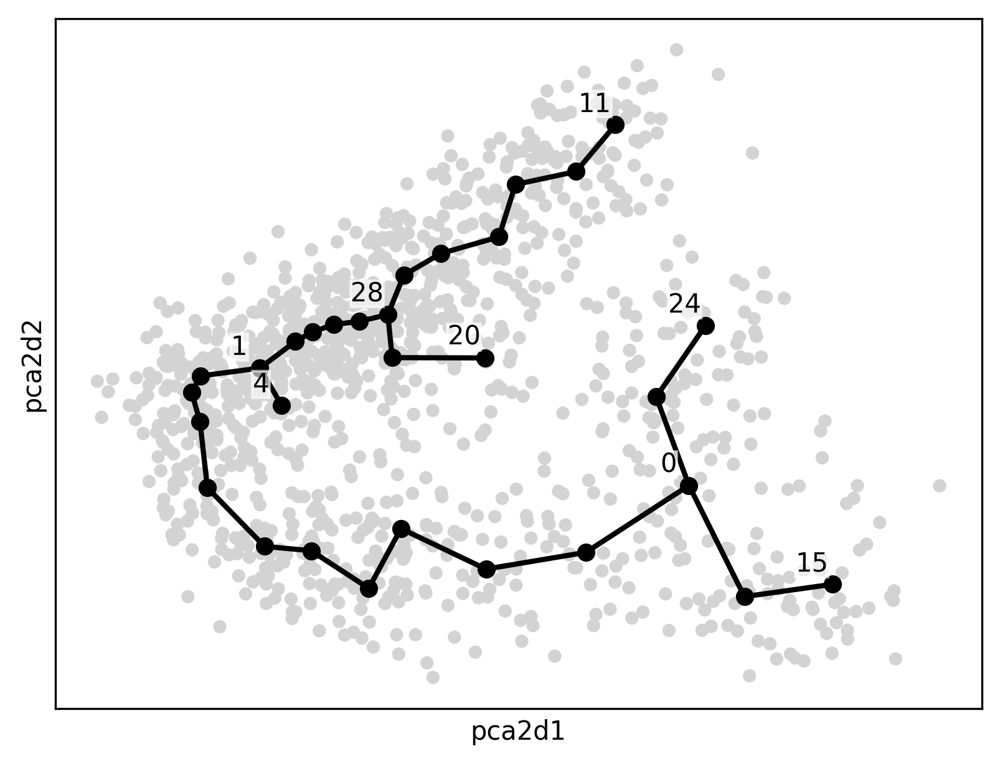

In [ ]:
# rerun the fitting
# sigma= 0.8, Nodes = 30
np.random.seed(1)
scf.tl.tree(adNorm_Mesoderm_subset1, method ='ppt',Nodes = 30, use_rep = 'X_pca2d', ppt_lmabda =100, ppt_sigma= 0.8, ppt_nsteps = 100)
scf.pl.graph(adNorm_Mesoderm_subset1, basis='pca2d')

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


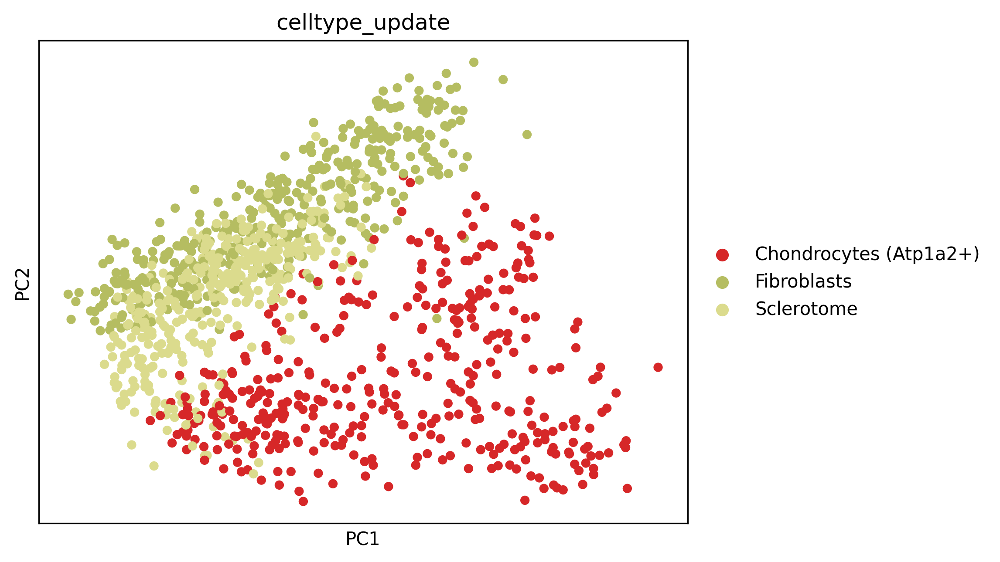

In [ ]:
sc.pl.pca(adNorm_Mesoderm_subset1, color='celltype_update')

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


node 4 selected as a root --> added
    .uns['graph']['root'] selected root.
    .uns['graph']['pp_info'] for each PP, its distance vs root and segment assignment.
    .uns['graph']['pp_seg'] segments network information.
projecting cells onto the principal graph
    finished (0:00:01) --> added
    .obs['edge'] assigned edge.
    .obs['t'] pseudotime value.
    .obs['seg'] segment of the tree assigned.
    .obs['milestones'] milestone assigned.
    .uns['pseudotime_list'] list of cell projection from all mappings.


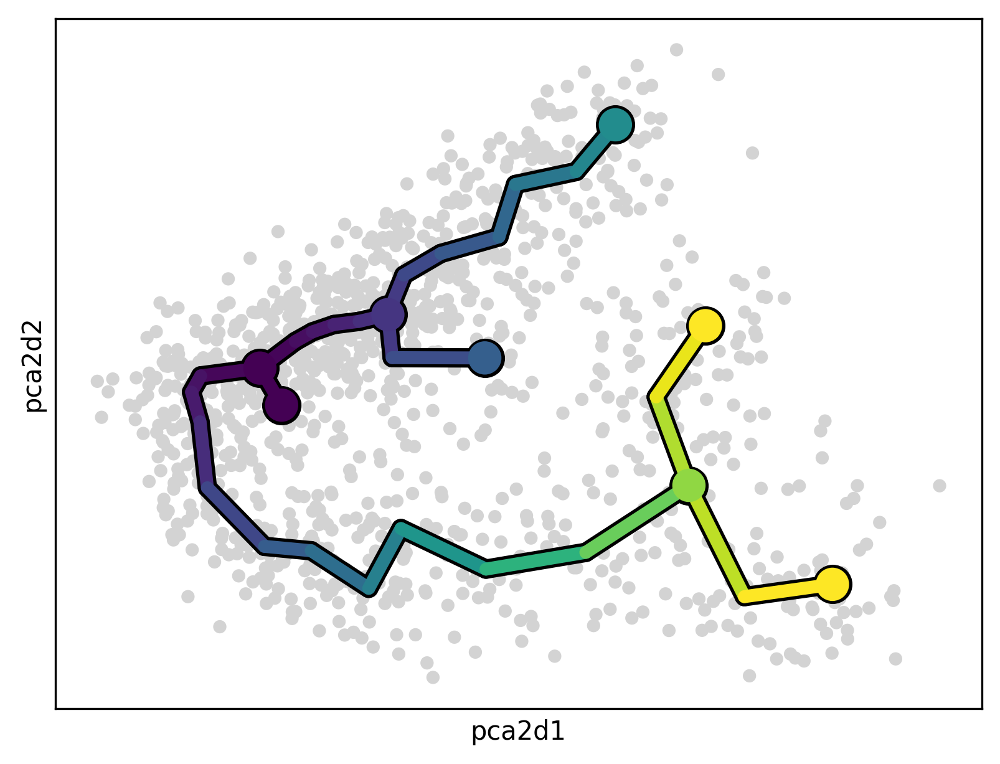

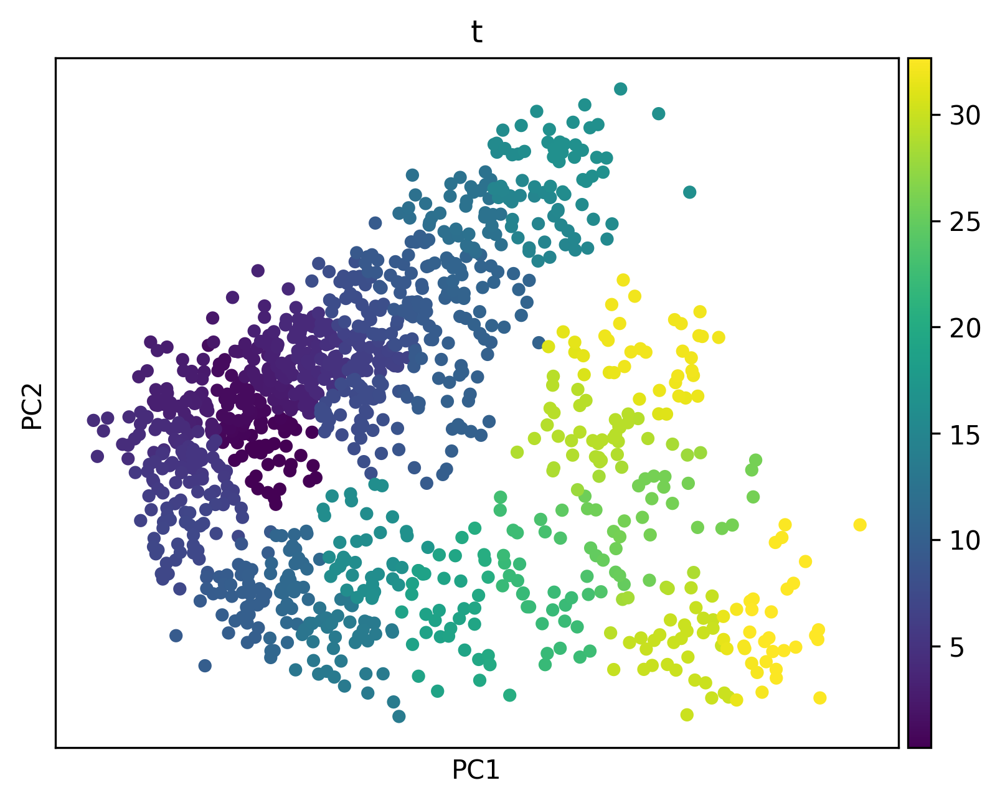

In [ ]:
# artificially defining the root, supervised
import warnings
# Ignore specific deprecation warnings from libraries
warnings.filterwarnings('ignore', category=DeprecationWarning, message=".*Graph.shortest_paths.*")
warnings.filterwarnings('ignore', category=DeprecationWarning, message=".*np.find_common_type is deprecated.*")
scf.tl.root(adNorm_Mesoderm_subset1,4)
scf.tl.pseudotime(adNorm_Mesoderm_subset1, seed = 1)
scf.pl.trajectory(adNorm_Mesoderm_subset1,basis = 'pca2d')
sc.pl.pca(adNorm_Mesoderm_subset1,color = 't')

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


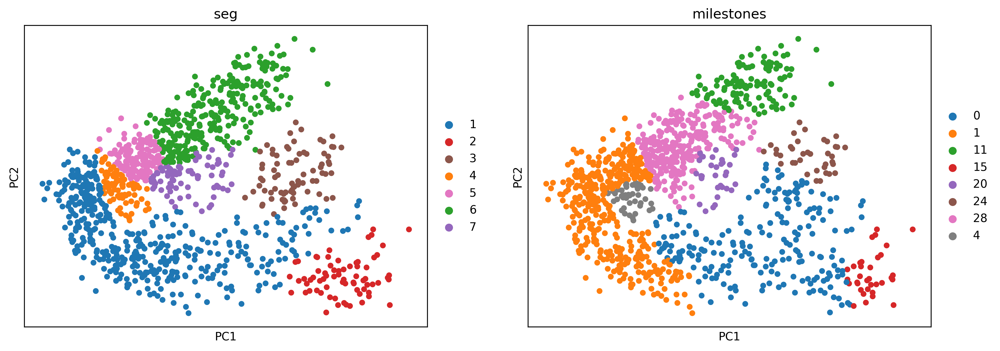

In [ ]:
sc.pl.pca(adNorm_Mesoderm_subset1, color = ['seg','milestones'])

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Generating dendrogram of tree
    segment : 100%|██████████| 7/7 [00:00<00:00, 13.02it/s]
    finished (0:00:00) --> added 
    .obsm['X_dendro'], new embedding generated.
    .uns['dendro_segments'] tree segments used for plotting.


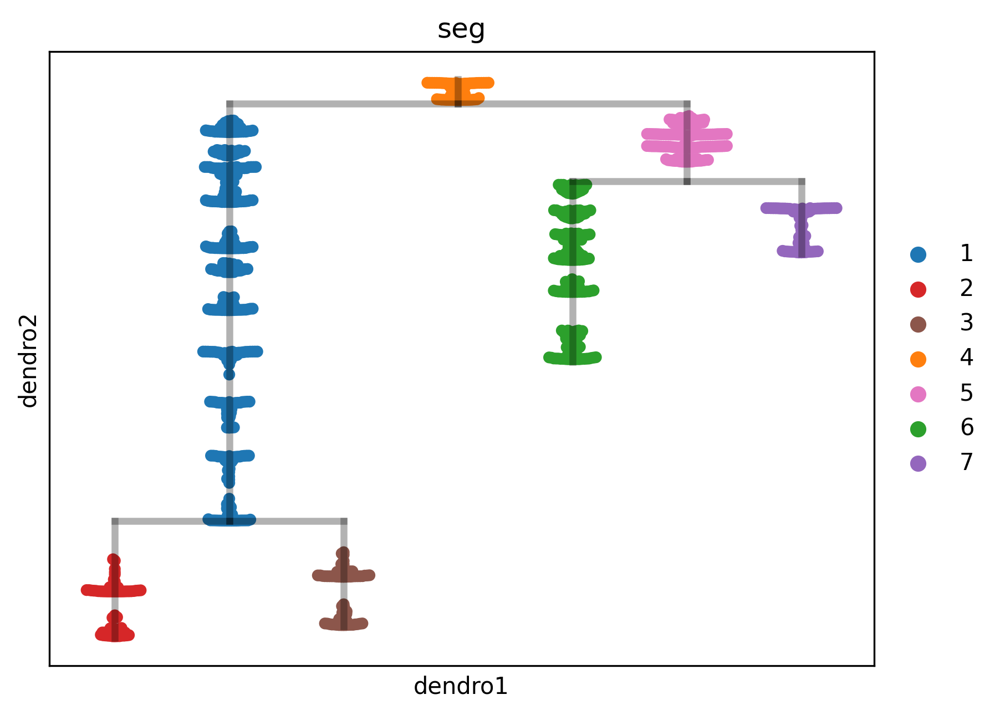

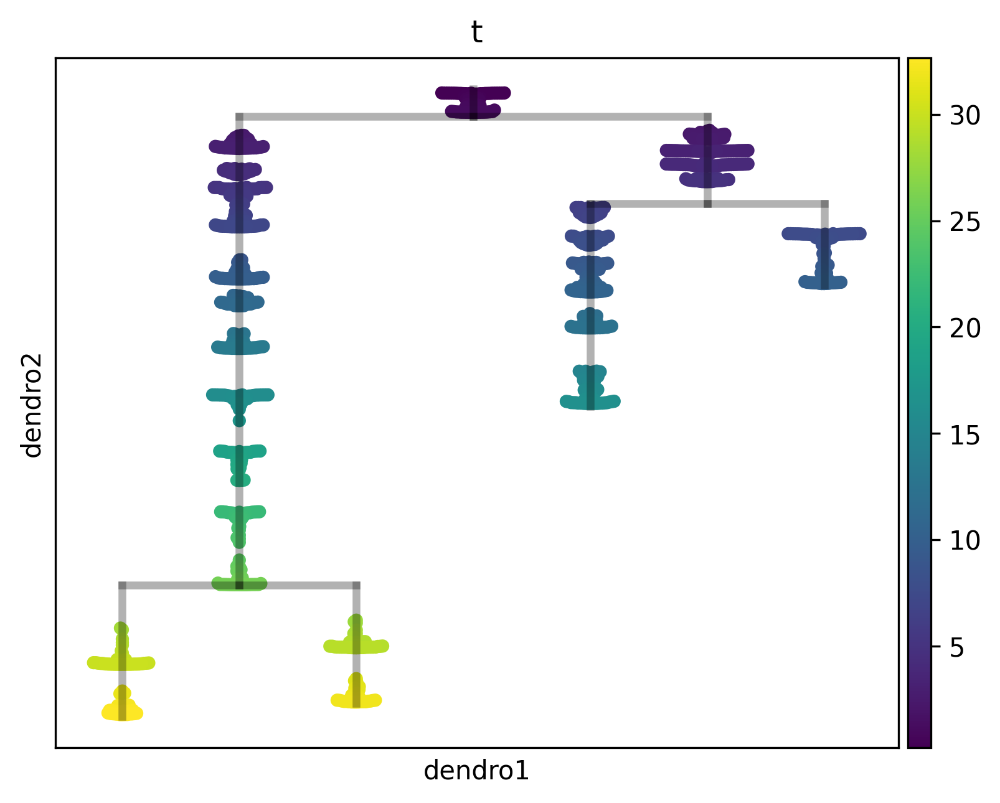

In [ ]:
scf.tl.dendrogram(adNorm_Mesoderm_subset1)
scf.pl.dendrogram(adNorm_Mesoderm_subset1, color= 'seg')
scf.pl.dendrogram(adNorm_Mesoderm_subset1, color ='t')

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


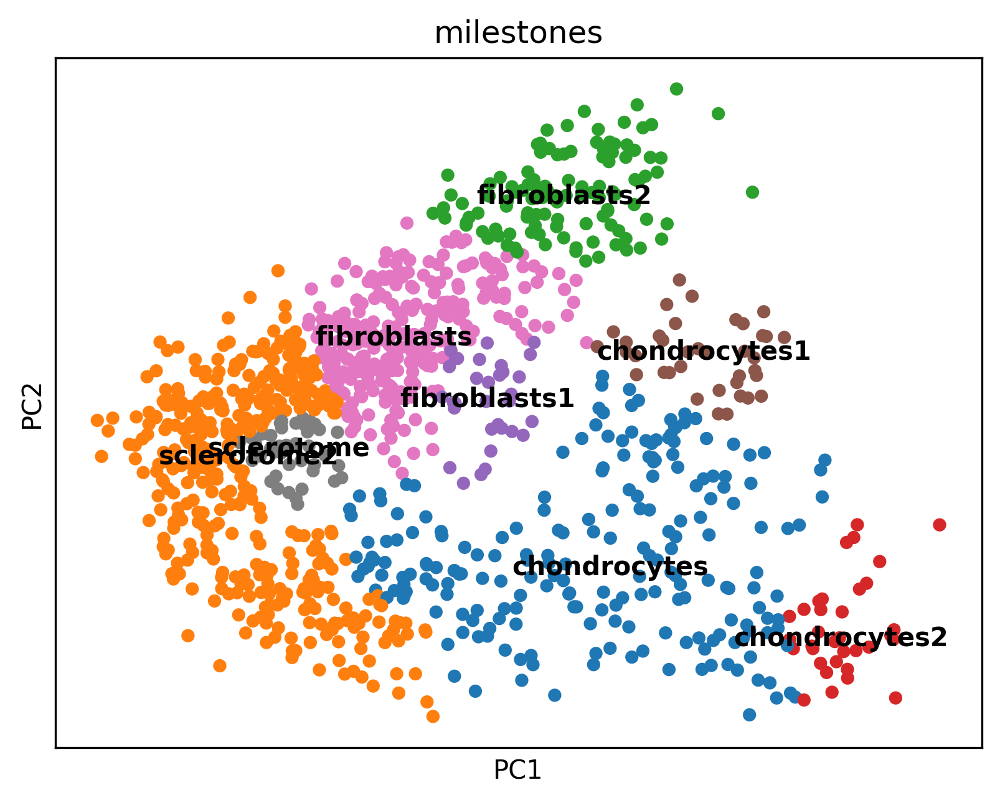

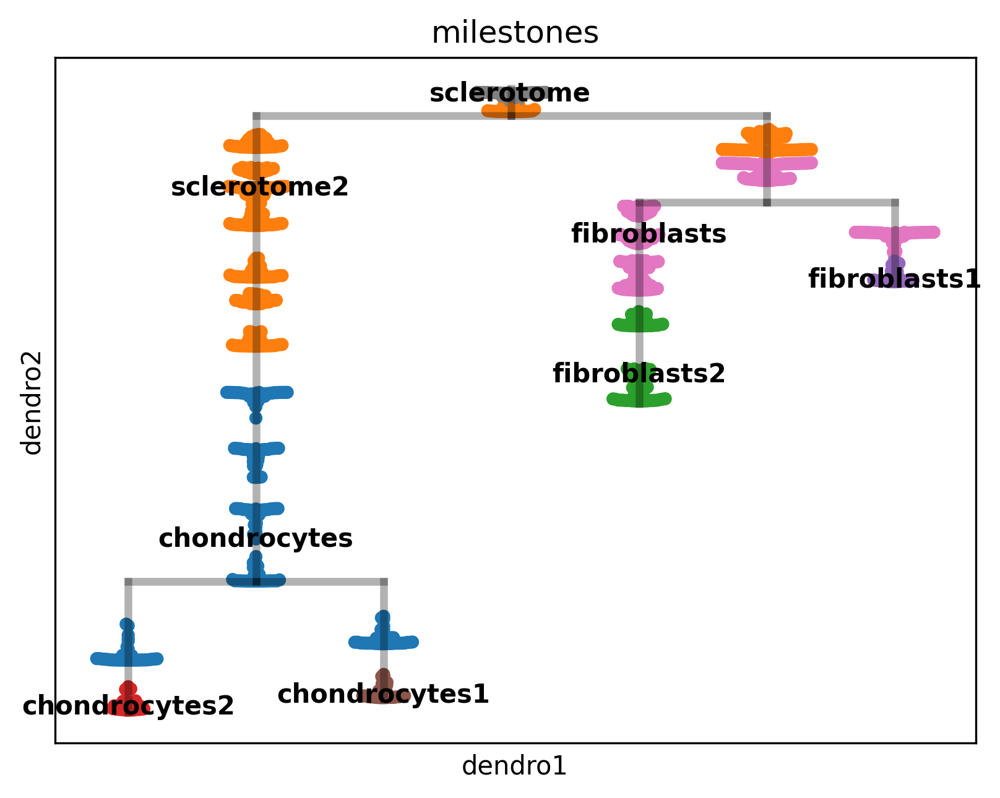

In [ ]:
# renaming milestones
scf.tl.rename_milestones(adNorm_Mesoderm_subset1, ['chondrocytes','sclerotome2','fibroblasts2','chondrocytes2','fibroblasts1','chondrocytes1','fibroblasts','sclerotome'])
sc.pl.pca(adNorm_Mesoderm_subset1, color=['milestones'],legend_loc='on data')
# redraw dendrogram on milestones
scf.pl.dendrogram(adNorm_Mesoderm_subset1, color ='milestones',legend_loc='on data')

In [ ]:
# subsetting the data to only contain HVG
ad1 = adNorm_Mesoderm_subset1.copy()
ad1 = ad1[:, ad1.var['highly_variable']]
ad1.shape
scf.tl.test_association(ad1, fdr_cut=0.25, A_cut = 0.4)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


test features for association with the trajectory
    single mapping :  25%|██▌       | 1030/4071 [08:06<23:55,  2.12it/s]

Exception ignored from cffi callback <function _processevents at 0x7aad603c12d0>:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/rpy2/rinterface_lib/callbacks.py", line 278, in _processevents
    processevents()
  File "/usr/local/lib/python3.10/dist-packages/rpy2/rinterface_lib/callbacks.py", line 262, in processevents
    def processevents() -> None:
KeyboardInterrupt: 


    single mapping :  25%|██▌       | 1038/4071 [08:09<23:50,  2.12it/s]

Exception ignored from cffi callback <function _processevents at 0x7aad603c12d0>:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/rpy2/rinterface_lib/callbacks.py", line 278, in _processevents
    processevents()
  File "/usr/local/lib/python3.10/dist-packages/rpy2/rinterface_lib/callbacks.py", line 262, in processevents
    def processevents() -> None:
KeyboardInterrupt: 


    single mapping :  27%|██▋       | 1085/4071 [08:22<23:02,  2.16it/s]

In [ ]:
# fits genes to trajectory
ad1_1= ad1.copy()
scf.tl.fit(ad1_1)
ad1_1.var

In [ ]:
sc.set_figure_params()
scf.pl.test_association(ad1_1)

In [ ]:
scf.tl.test_fork(ad1_1,root_milestone = 'sclerotome',milestones = ['chondrocytes','fibroblasts'])
scf.pl.test_fork(ad1_1)

In [ ]:
scf.tl.branch_specific(ad1_1,root_milestone = 'sclerotome',milestones = ['chondrocytes','fibroblasts'],effect = 0.5)

In [ ]:
# displaying results
# chondrocytes(Atp1a2+)
g1=scf.pl.trends(ad1_1,
                root_milestone='sclerotome',
                 milestones=['chondrocytes','fibroblasts'],
                 branch="chondrocytes",
                 plot_emb=False,ordering="max",return_genes=True)
# fibroblasts
g1=scf.pl.trends(ad1_1,
                root_milestone='sclerotome',
                 milestones=['chondrocytes','fibroblasts'],
                 branch="fibroblasts",
                 plot_emb=False,ordering="max",return_genes=True)

In [ ]:
branch_column_1 = ad1_1.uns['sclerotome->chondrocytes<>fibroblasts']['fork']['branch']
print(branch_column_1)
# separate genes that promote chondrocytes and fibroblasts fates separately
# For chondrocytes genes
chondrocytes_genes = branch_column_1[branch_column_1 == "chondrocytes"].index.tolist()
# For fibroblasts genes
fibroblasts_genes = branch_column_1[branch_column_1 == "fibroblasts"].index.tolist()
print(chondrocytes_genes)
print(fibroblasts_genes)

In [ ]:
# selecting out key TFs
with open('/content/drive/MyDrive/allTFs_mm_aertslab_011924.txt', 'r') as file:
    mouse_tfs = [line.strip() for line in file]
mouse_tfs_set = set(mouse_tfs)
chondrocytes_genes_set = set(chondrocytes_genes)
fibroblasts_genes_set= set(fibroblasts_genes)
tf_in_chondrocytes = list(mouse_tfs_set.intersection(chondrocytes_genes_set))
tf_in_fibroblasts = list(mouse_tfs_set.intersection(fibroblasts_genes_set))
print(tf_in_chondrocytes)
print(tf_in_fibroblasts)

40 principle points, sigma =2 seems to generate good fittings.

#### The trajectory inference get results that fit well with paper publications

#### From the DEG results,Bcl6 is also a transcription factor that is specifically expressed in the Brown adipocyte cells

## Identifying TFs that promote brown adipocyte fate

### First we can try to do step by step inference



### Here identified a list of pure fibroblast associated genes, and to suppress or inhibit the expression of this list of genes may help promote the adipocyte progenitors cell fate
### From trajectory inference results and DEG results, we identified ['Cat', 'Zbtb16', 'Sox6', 'Stat3'] to be associated with adipocyte differentiation; ['Esrrg', 'Ppara', 'Prdm16','Bcl6'] to be specifically associated with brown adipocyte development;['Plagl1', 'Peg3'] to be specifically associated with fibroblast fate.


In [13]:
from nbconvert import HTMLExporter
import nbformat

# Path to your notebook file
notebook_path = '/content/drive/MyDrive/CSCB/Copy_of_Untitled1.ipynb'
html_output_path = '/content/drive/MyDrive/CSCB/Copy_of_Untitled1.html'

# Load your notebook
with open(notebook_path, 'r', encoding='utf-8') as f:
    notebook = nbformat.read(f, as_version=4)

# Create an HTML exporter
html_exporter = HTMLExporter()
html_exporter.template_name = 'classic'  # You can change to other templates like 'lab', 'basic'

# Process the notebook we loaded earlier
(body, resources) = html_exporter.from_notebook_node(notebook)

# Write the HTML output
with open(html_output_path, 'w', encoding='utf-8') as f:
    f.write(body)

print("Notebook has been converted to HTML.")


Notebook has been converted to HTML.
